# Offline pipeline for data generation

## Import libraries

In [1]:
import cv2
import os
import shutil
import numpy as np
import matplotlib.pyplot as plt
import glob
from openvino.runtime import Core
from tensorflow import reshape

2022-09-18 18:57:27.386155: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


## Aditional function definition

In [2]:
def create_dir(folder, force=True, verbose=False):
    try:
        os.makedirs(folder) 
    
    except:
        if force:
            shutil.rmtree(folder)
            os.makedirs(folder)

## Extract frames from video sequences

In [5]:
images_dir = '/home/christian/Documents/Datasets/OakGait16/frames/'
clips_directory = '/home/christian/Documents/Datasets/OakGait16/clips'
frs_dir = 'rgb/'
mks_dir = 'masks/'
verbose = True
subjects = ['000','001','002','003','004','005','006','007','008','009','010','011','012','013','014','015','016']
nclips = {'nm':5, 'bg':5, 'cl':5}
views = ['060','075','090','105','120']

In [8]:
for view in views:
    frames_dir = os.path.join(images_dir, view, frs_dir)
    print(f'PROCESSING VIEW: {view}')

    for subject in subjects:
        print(f'Processing subject: {subject} view: {view}....                                  ')
        create_dir(os.path.join(frames_dir, subject), force=True)
        subject_dir = os.path.join(clips_directory, view, subject)
        walks = os.listdir(subject_dir)
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            walk_dir = os.path.join(subject_dir, walk)
            clips = sorted(os.listdir(walk_dir))
            
            for i, clip in enumerate(clips):
                if clip[-4:] == '.avi' and nclips[walk]>=i:
                    clip_path = os.path.join(walk_dir, clip)
                    sub_dir = os.path.join(frames_dir, subject, walk, clip.split('.')[0])
                    
                    create_dir(sub_dir, force=True)
                    print(sub_dir, end='\r')
                    cap = cv2.VideoCapture(clip_path)
                    cnt = 0
                    while True:
                        ret, frame = cap.read()
                        if ret:
                            cnt +=1
                            frame_path = f'{sub_dir}/{str(cnt).zfill(4)}.jpg'
                            cv2.imwrite(frame_path, frame)
                        else:
                            break
                        if cv2.waitKey(1) == ord('q'):
                            break
                    cap.release()
    print('', end="\r")
cv2.destroyAllWindows()

PROCESSING VIEW: 060
Processing subject: 000 view: 060....                                  
Processing subject: 001 view: 060....                                  5
Processing subject: 002 view: 060....                                  5
Processing subject: 003 view: 060....                                  5
Processing subject: 004 view: 060....                                  5
Processing subject: 005 view: 060....                                  5
Processing subject: 006 view: 060....                                  5
Processing subject: 007 view: 060....                                  5
Processing subject: 008 view: 060....                                  5
Processing subject: 009 view: 060....                                  5
Processing subject: 010 view: 060....                                  5
Processing subject: 011 view: 060....                                  5
Processing subject: 012 view: 060....                                  5
Processing subject: 013 view: 0

SHOWING VIEW: 060
Showing subject: 000 view: 060


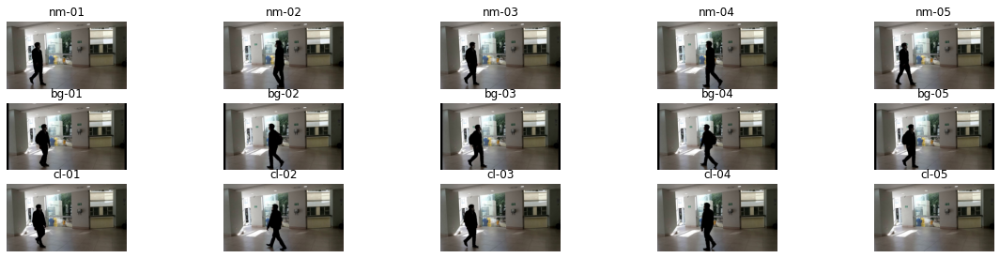

Showing subject: 001 view: 060


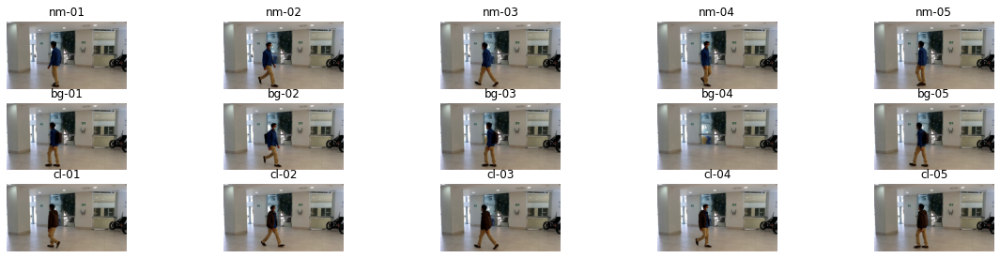

Showing subject: 002 view: 060


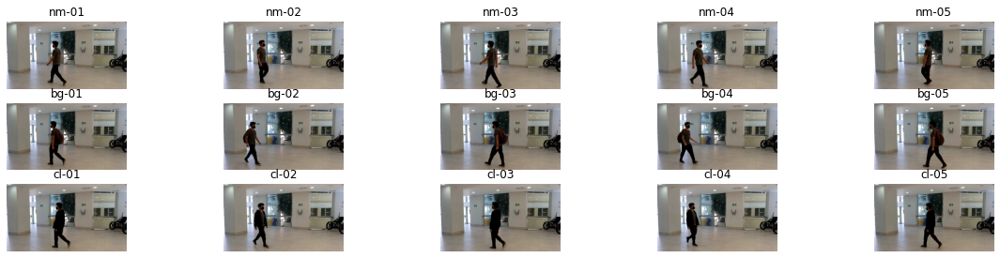

Showing subject: 003 view: 060


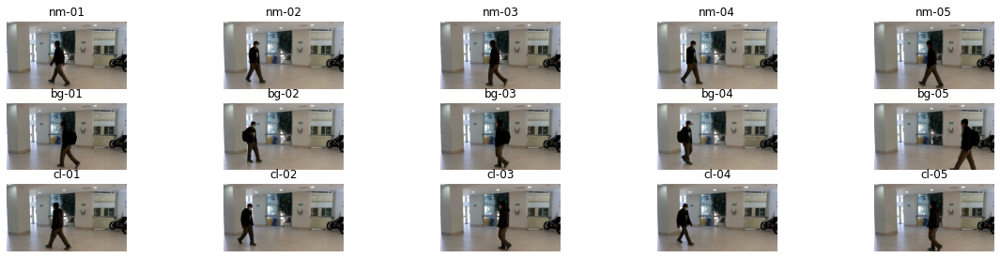

Showing subject: 004 view: 060


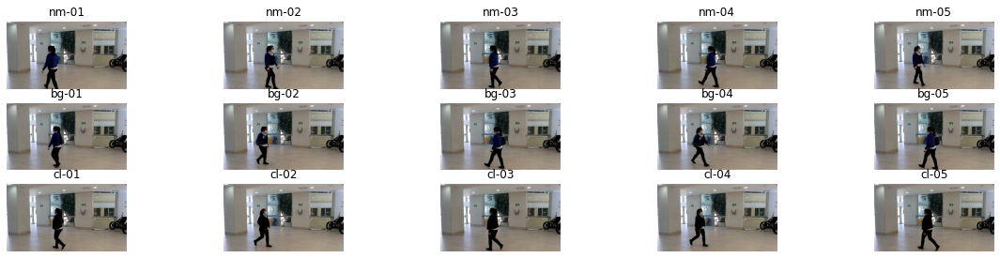

Showing subject: 005 view: 060


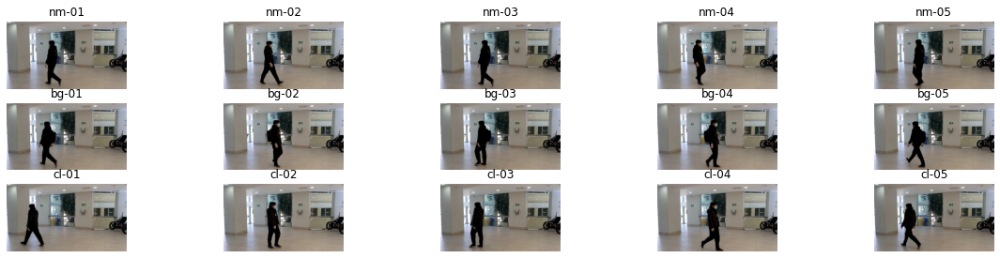

Showing subject: 006 view: 060


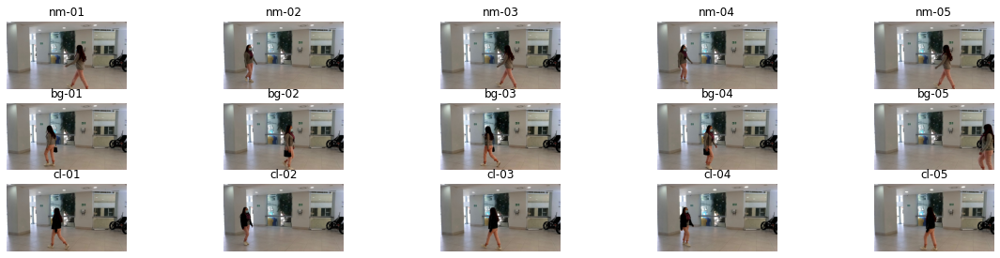

Showing subject: 007 view: 060


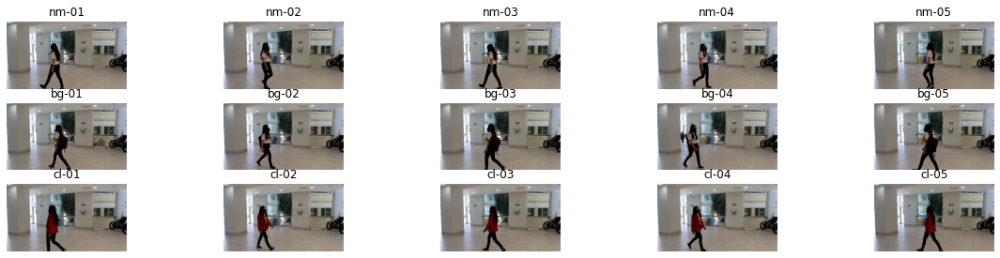

Showing subject: 008 view: 060


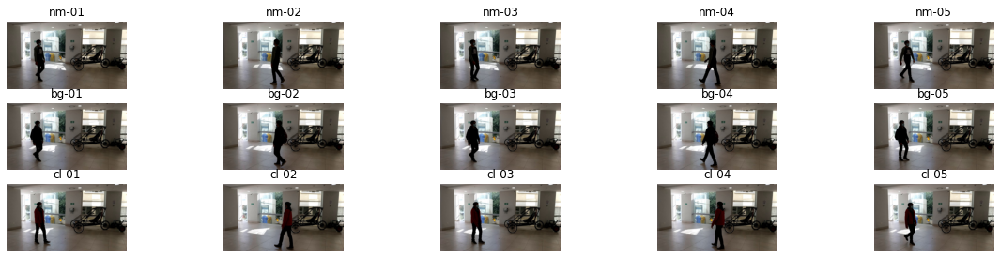

Showing subject: 009 view: 060


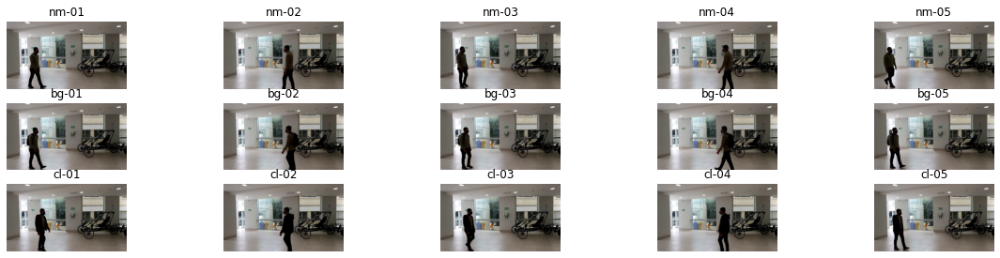

Showing subject: 010 view: 060


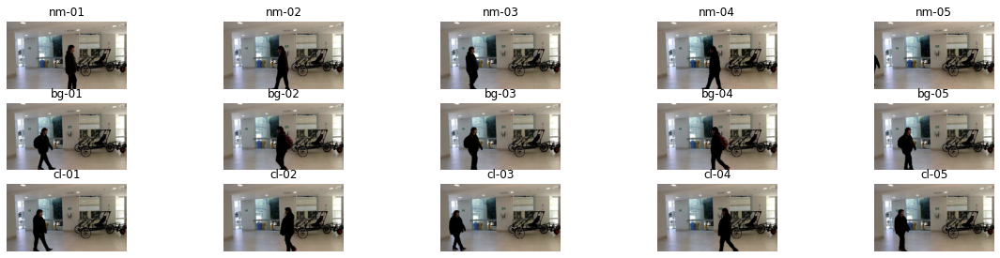

Showing subject: 011 view: 060


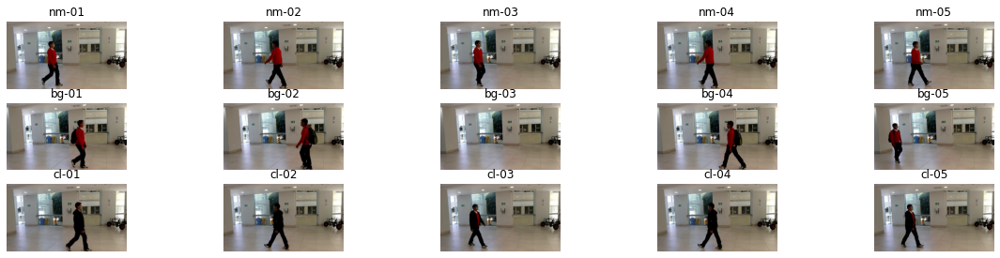

Showing subject: 012 view: 060


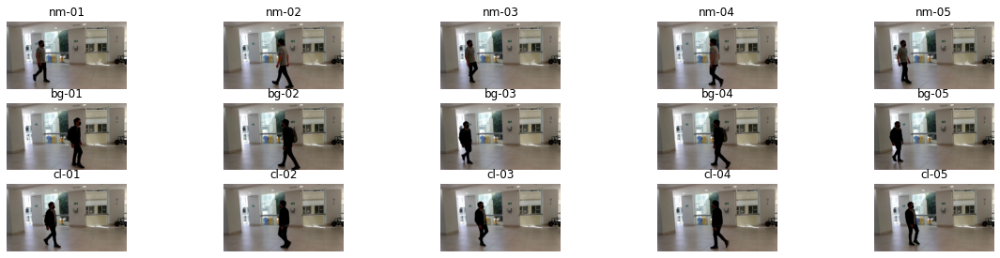

Showing subject: 013 view: 060


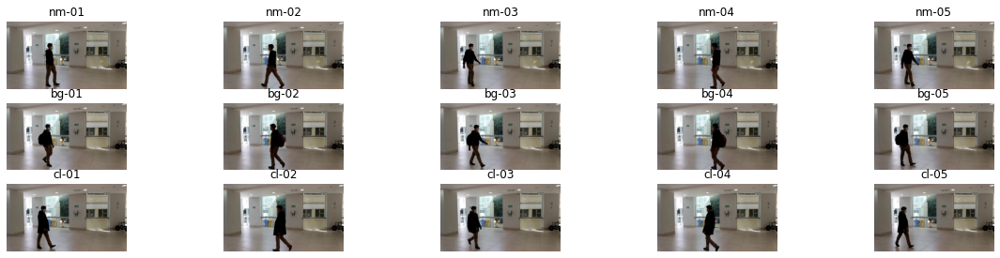

Showing subject: 014 view: 060


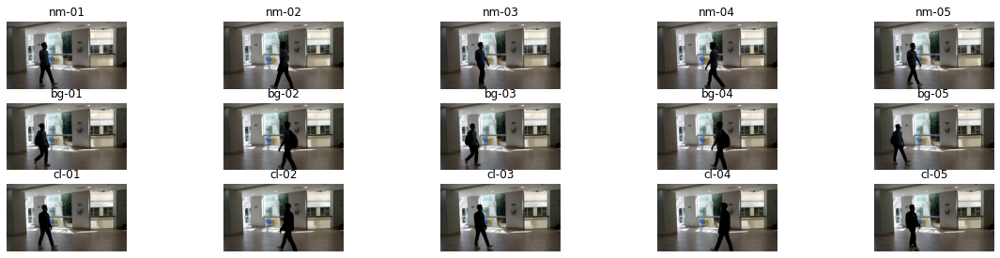

Showing subject: 015 view: 060


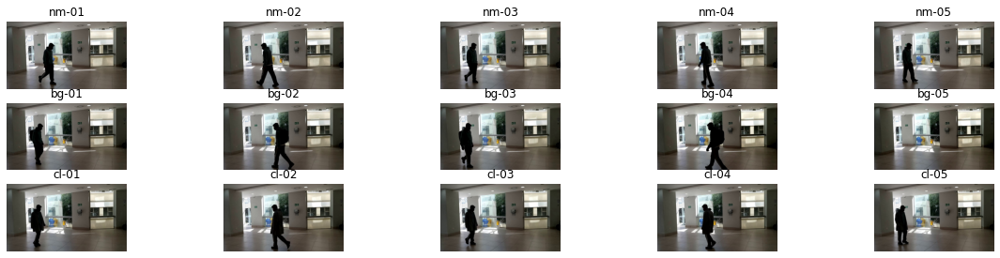

Showing subject: 016 view: 060


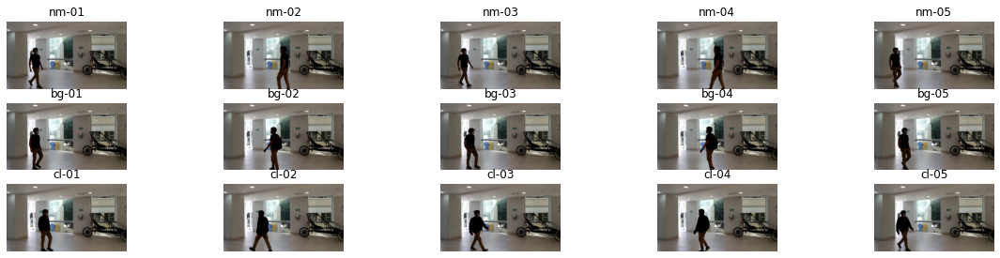

SHOWING VIEW: 075
Showing subject: 000 view: 075


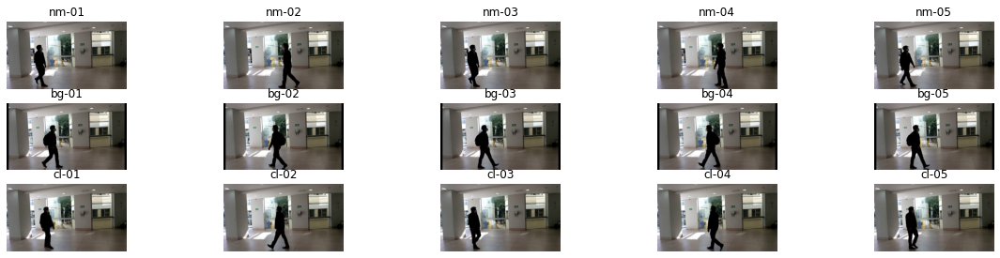

Showing subject: 001 view: 075


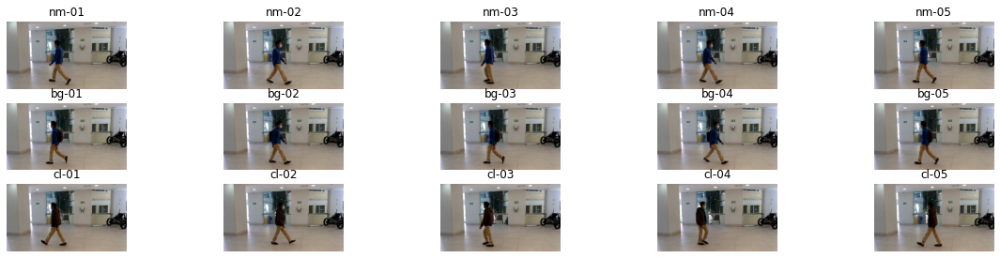

Showing subject: 002 view: 075


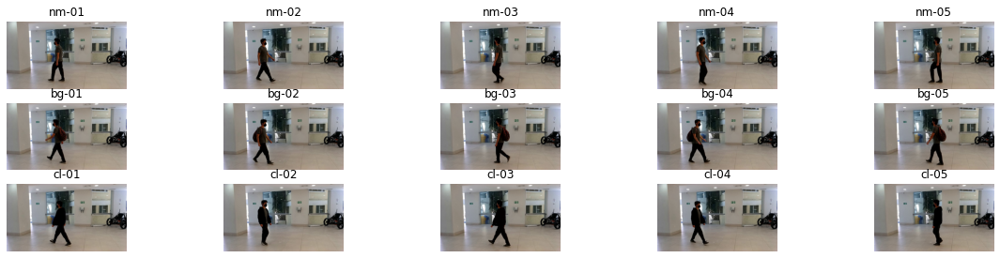

Showing subject: 003 view: 075


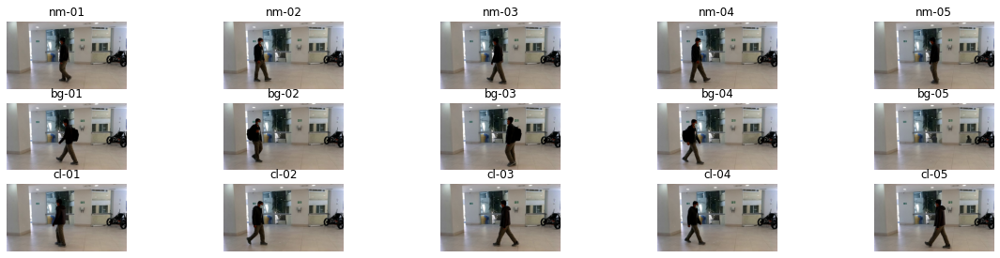

Showing subject: 004 view: 075


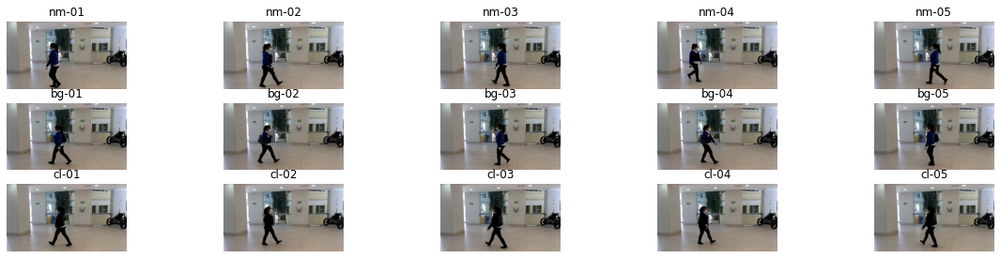

Showing subject: 005 view: 075


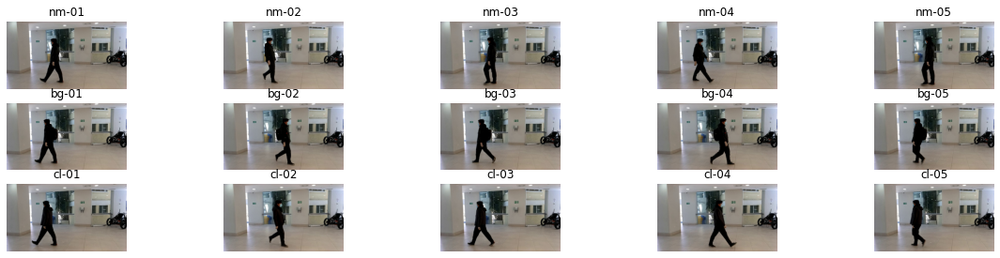

Showing subject: 006 view: 075


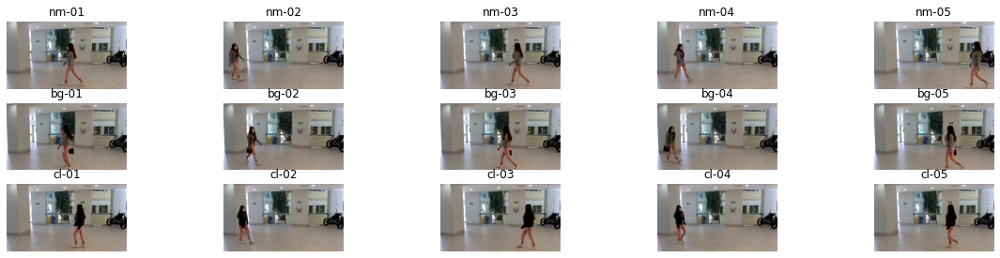

Showing subject: 007 view: 075


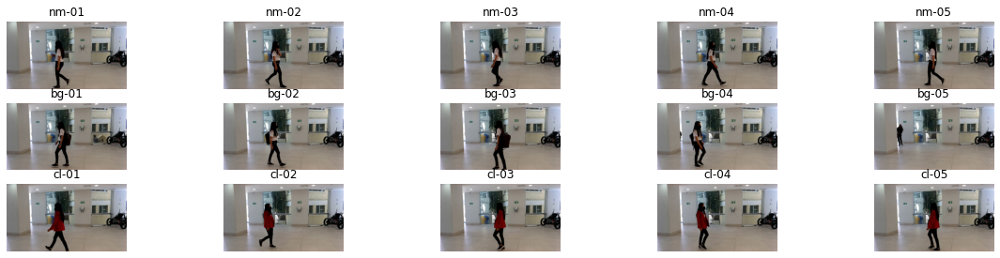

Showing subject: 008 view: 075


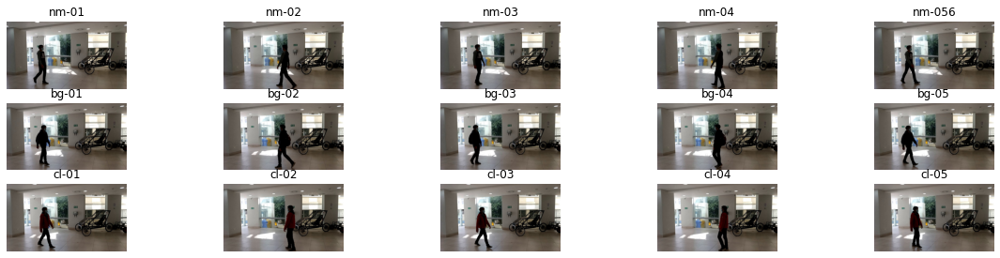

Showing subject: 009 view: 075


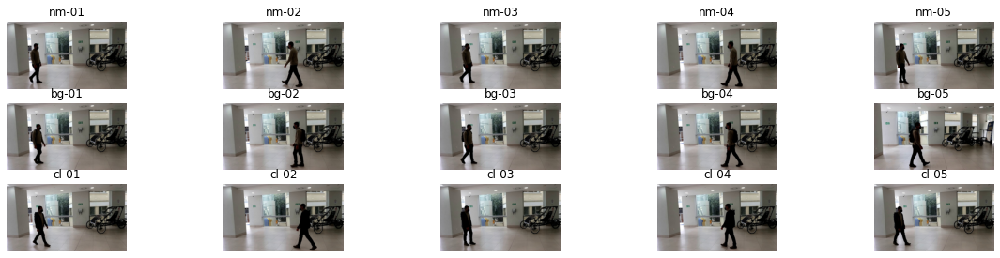

Showing subject: 010 view: 075


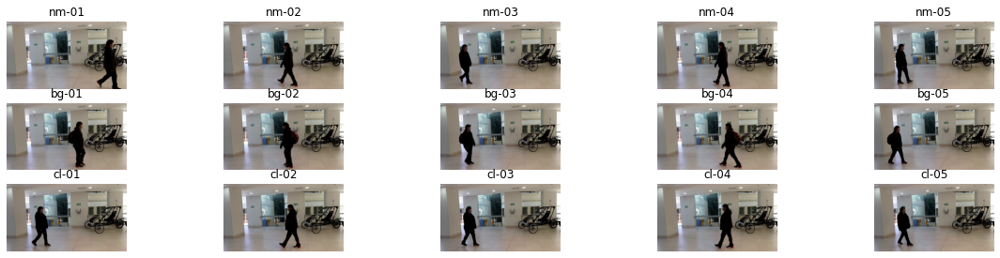

Showing subject: 011 view: 075


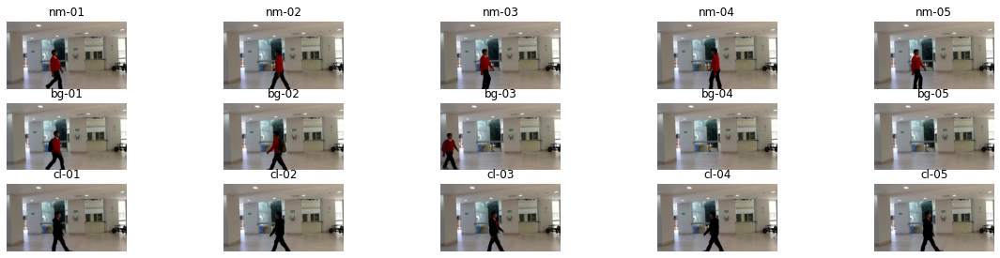

Showing subject: 012 view: 075


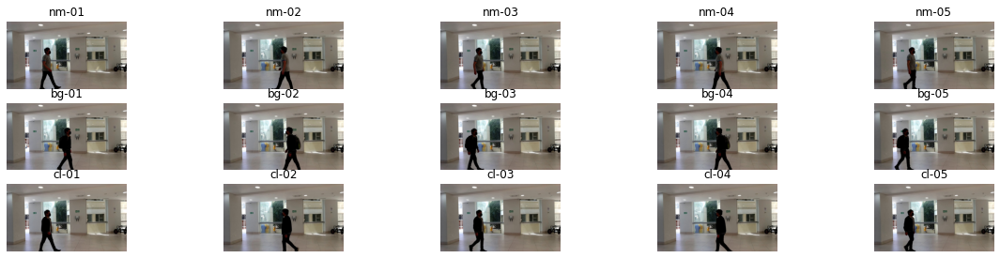

Showing subject: 013 view: 075


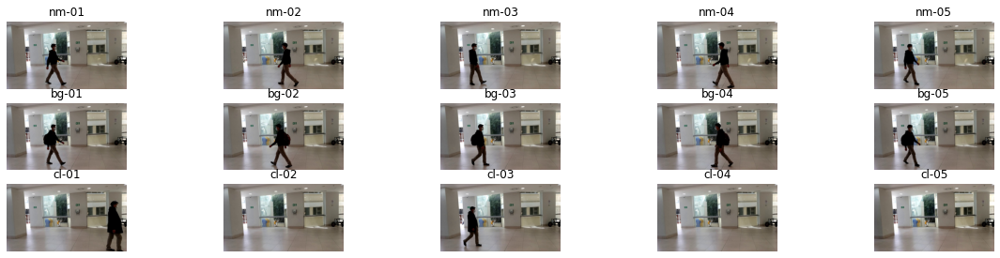

Showing subject: 014 view: 075


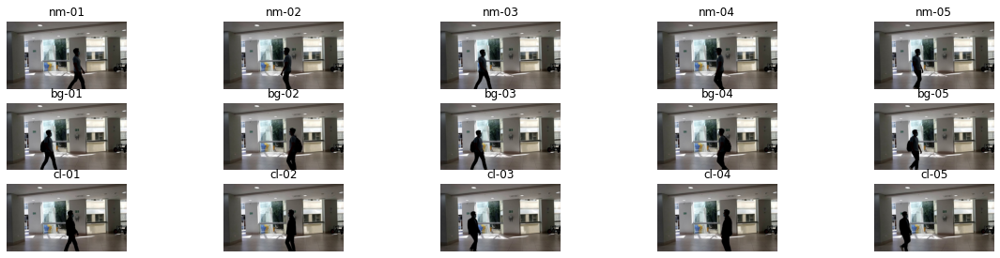

Showing subject: 015 view: 075


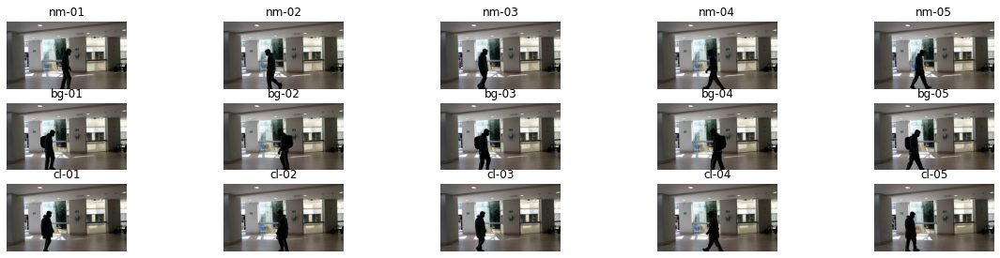

Showing subject: 016 view: 075


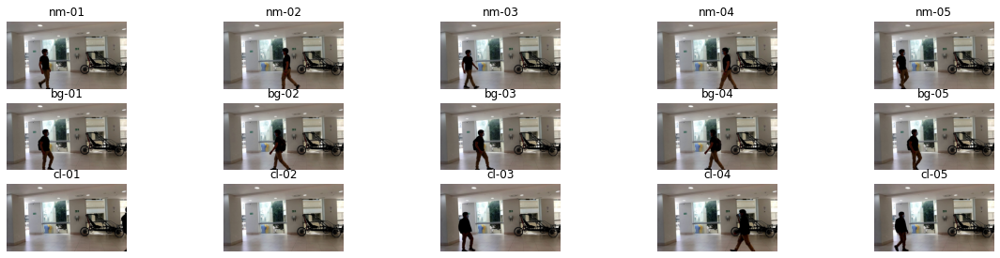

SHOWING VIEW: 090
Showing subject: 000 view: 090


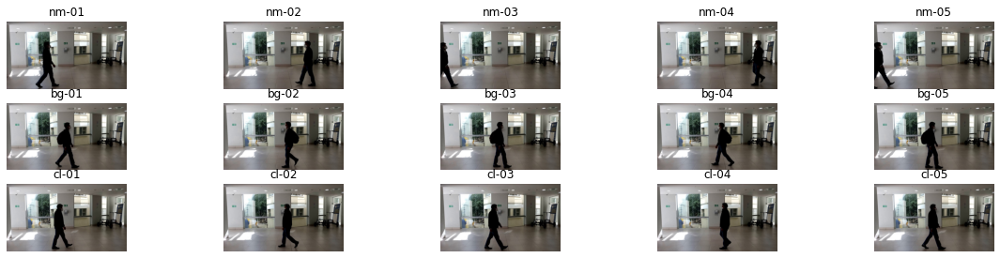

Showing subject: 001 view: 090


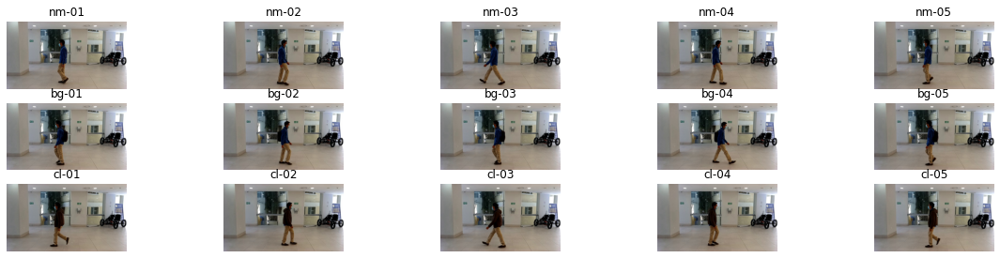

Showing subject: 002 view: 090


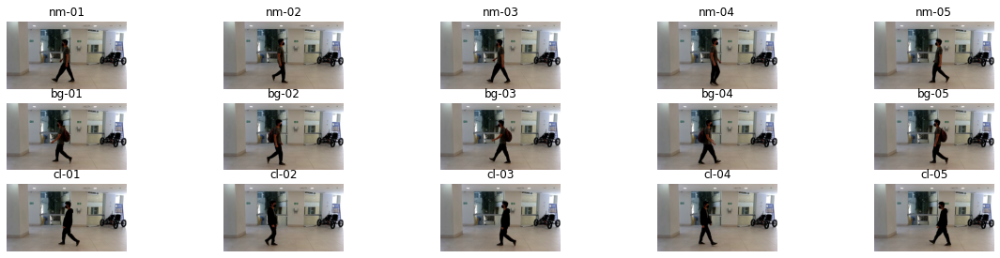

Showing subject: 003 view: 090


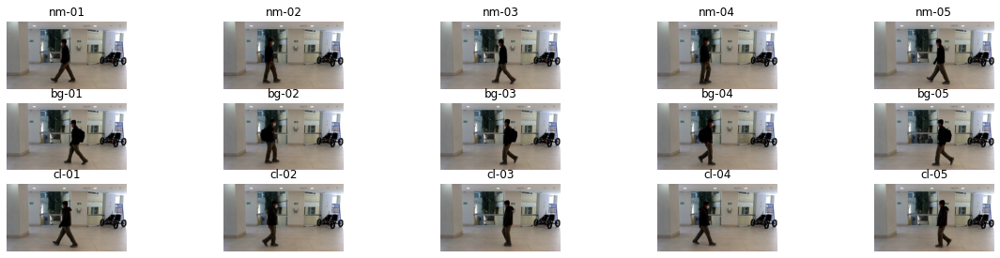

Showing subject: 004 view: 090


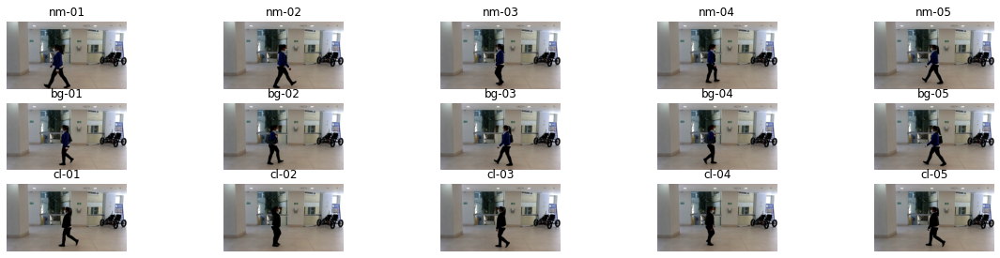

Showing subject: 005 view: 090


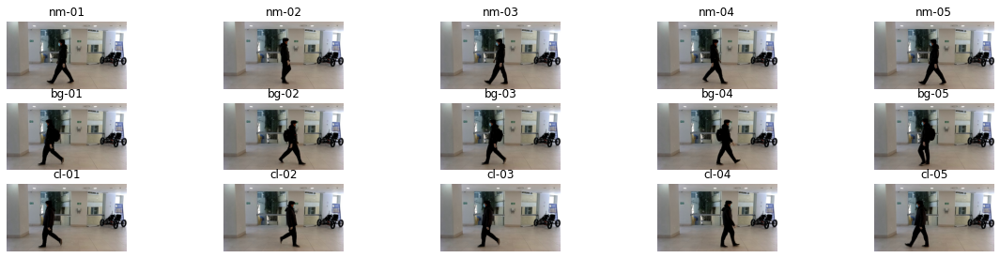

Showing subject: 006 view: 090


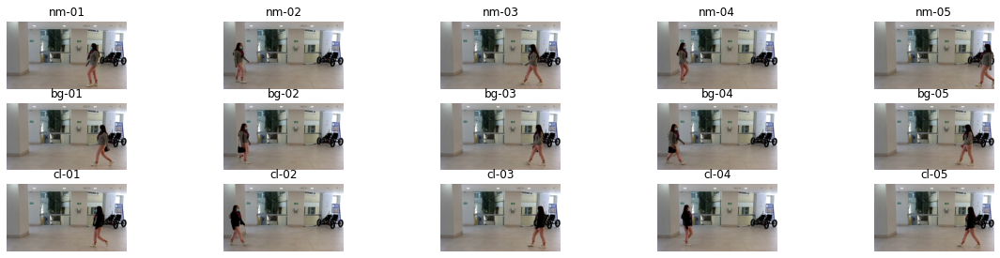

Showing subject: 007 view: 090


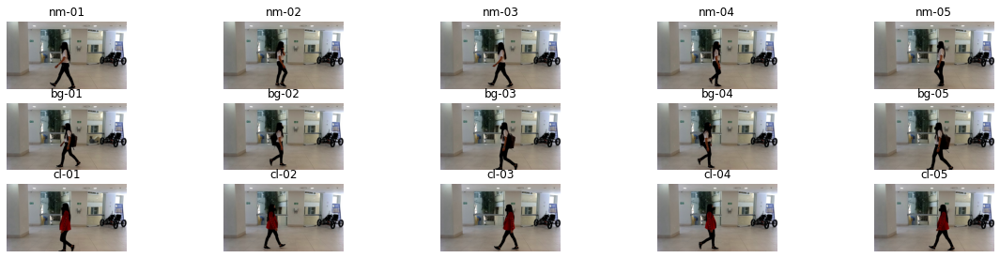

Showing subject: 008 view: 090


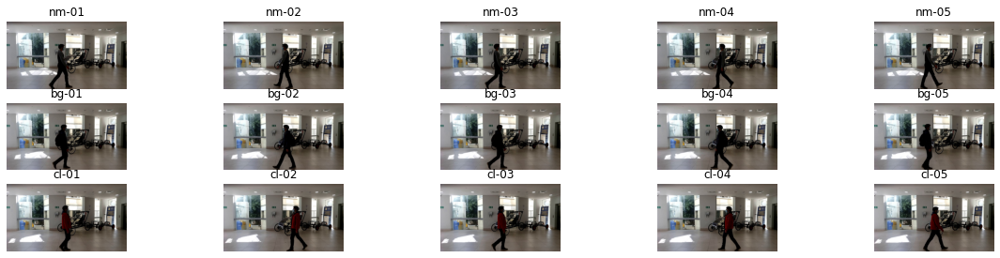

Showing subject: 009 view: 090


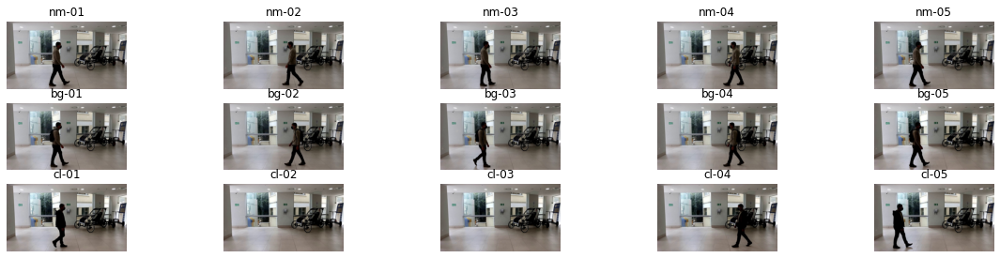

Showing subject: 010 view: 090


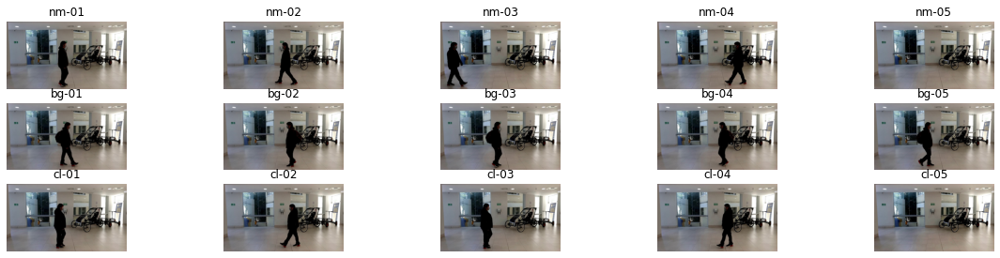

Showing subject: 011 view: 090


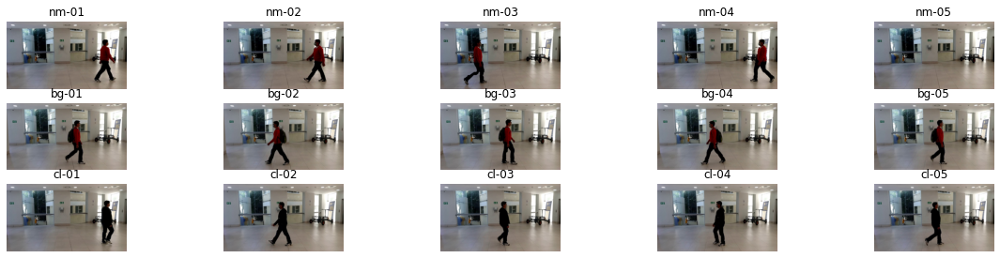

Showing subject: 012 view: 090


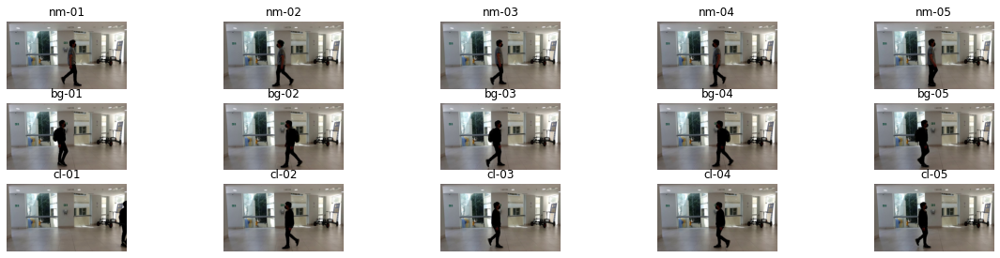

Showing subject: 013 view: 090


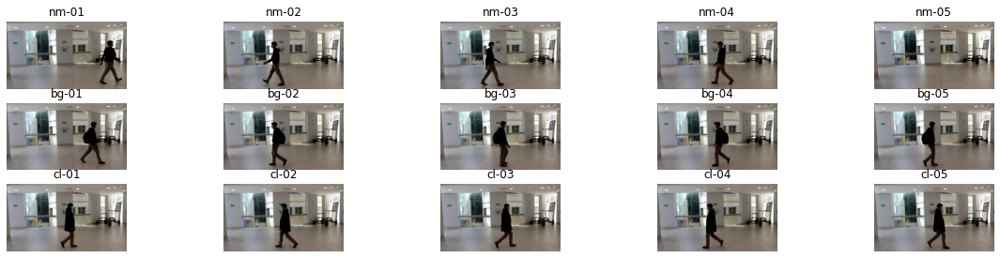

Showing subject: 014 view: 090


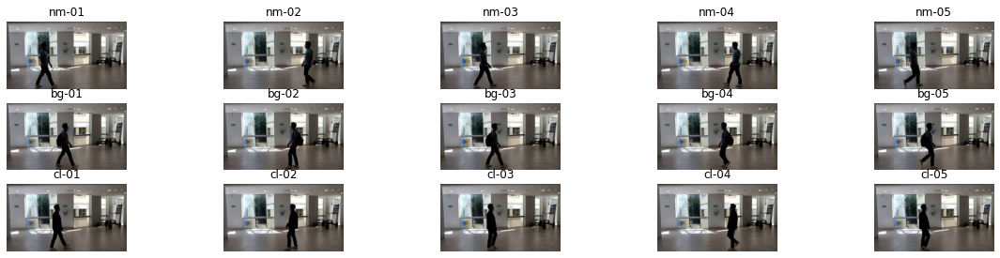

Showing subject: 015 view: 090


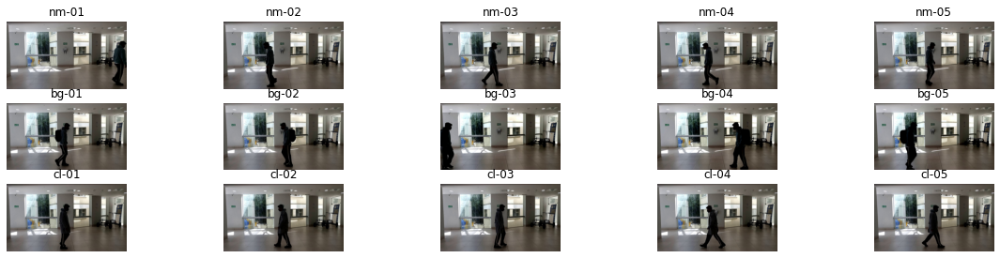

Showing subject: 016 view: 090


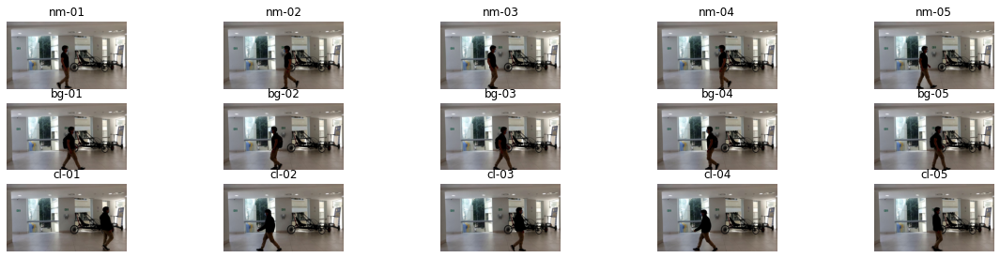

SHOWING VIEW: 105
Showing subject: 000 view: 105


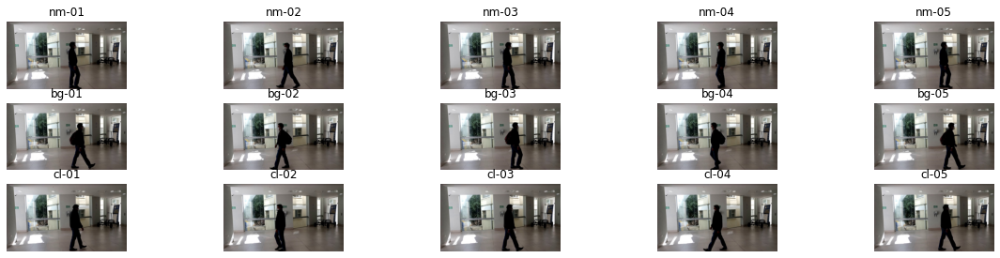

Showing subject: 001 view: 105


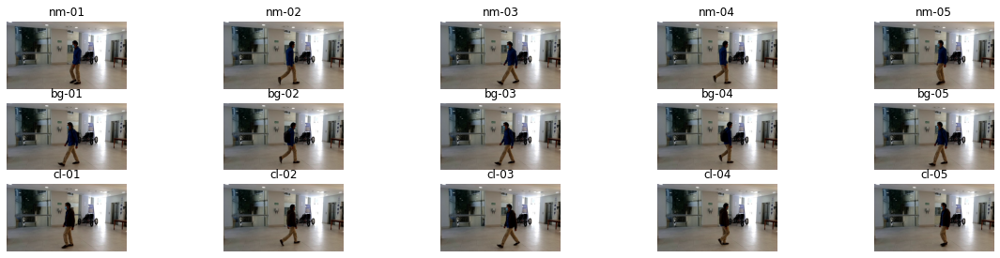

Showing subject: 002 view: 105


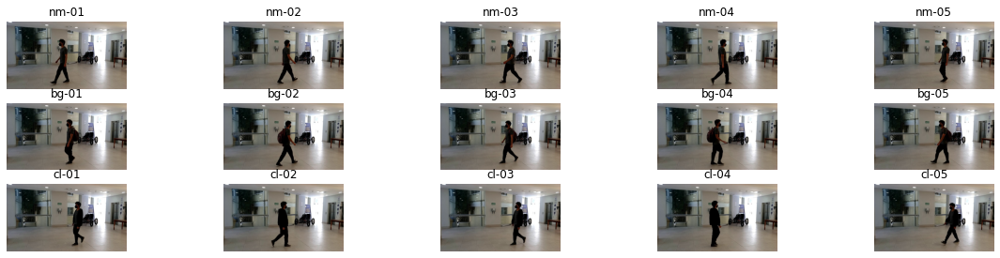

Showing subject: 003 view: 105


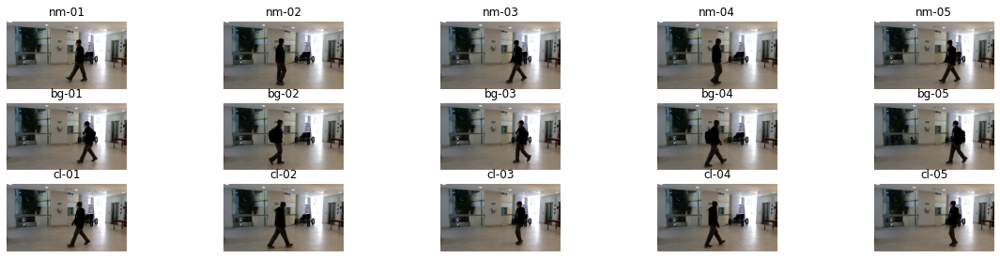

Showing subject: 004 view: 105


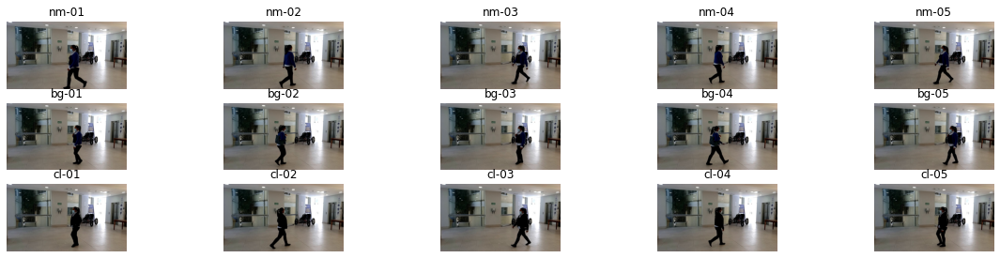

Showing subject: 005 view: 105


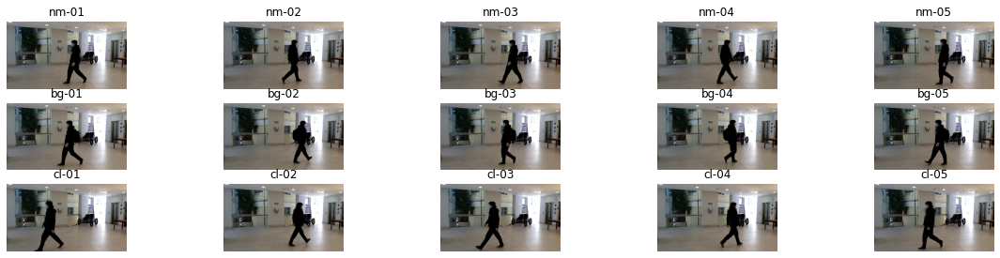

Showing subject: 006 view: 105


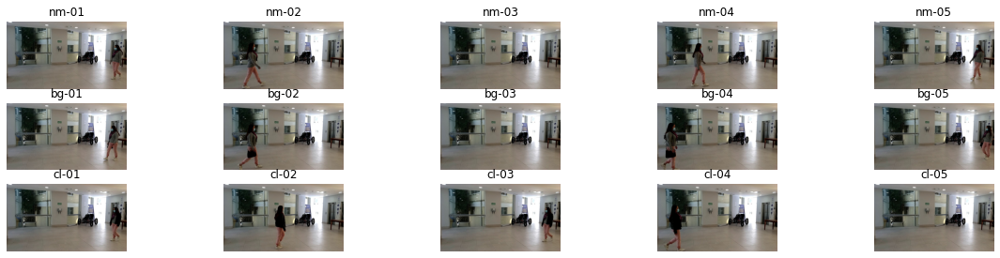

Showing subject: 007 view: 105


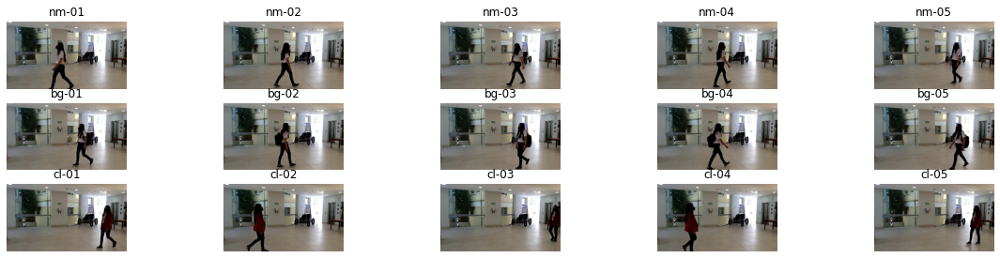

Showing subject: 008 view: 105


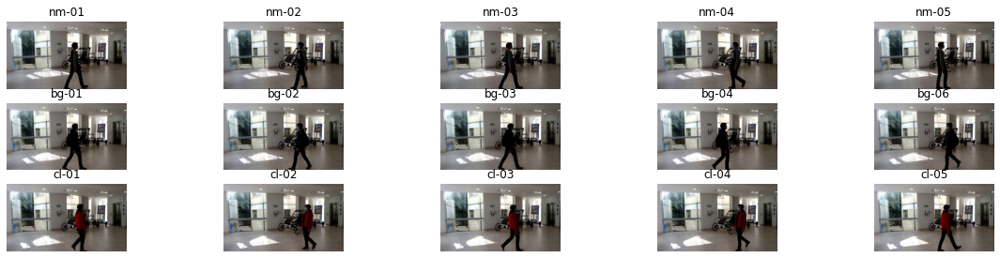

Showing subject: 009 view: 105


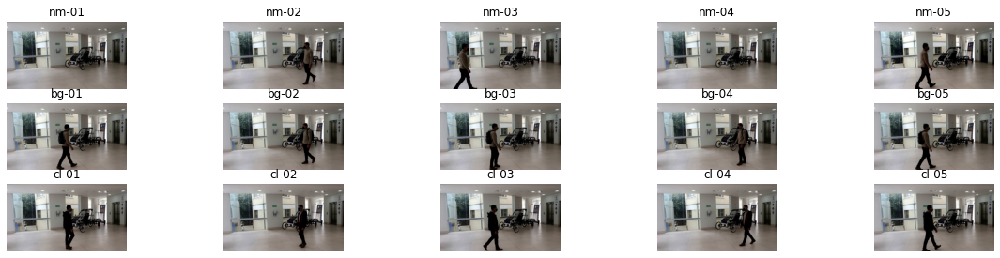

Showing subject: 010 view: 105


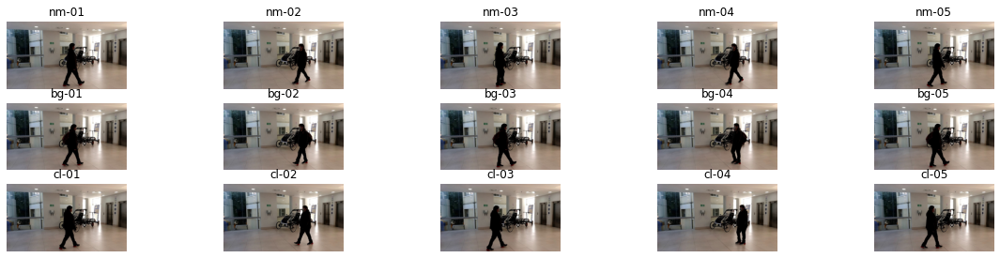

Showing subject: 011 view: 105


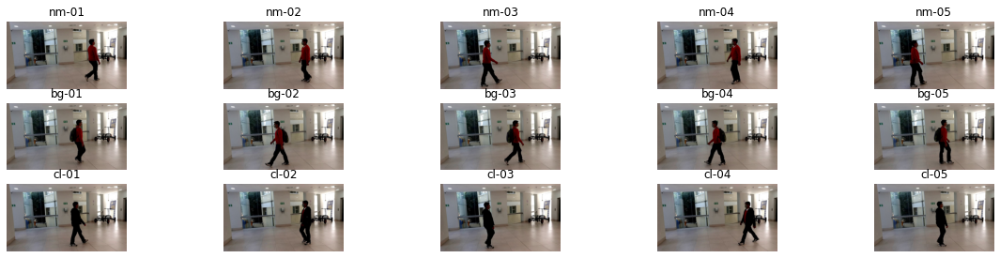

Showing subject: 012 view: 105


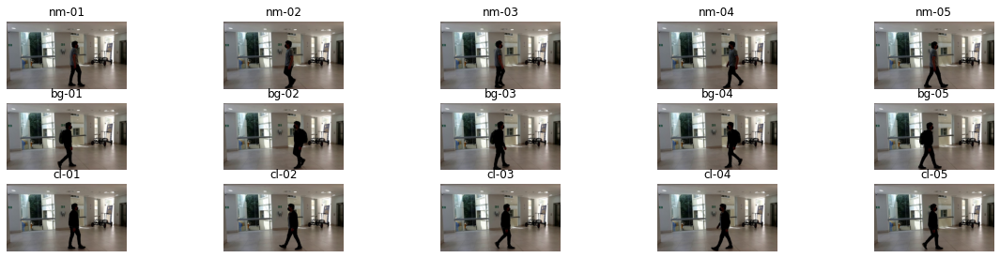

Showing subject: 013 view: 105


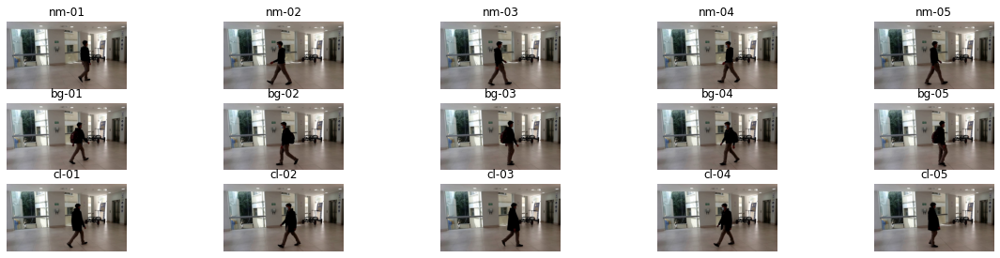

Showing subject: 014 view: 105


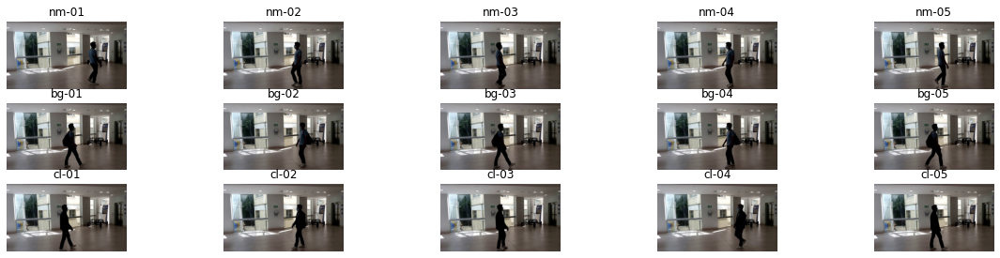

Showing subject: 015 view: 105


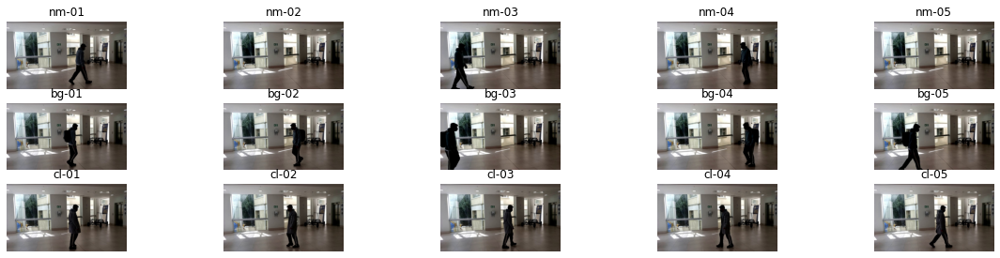

Showing subject: 016 view: 105


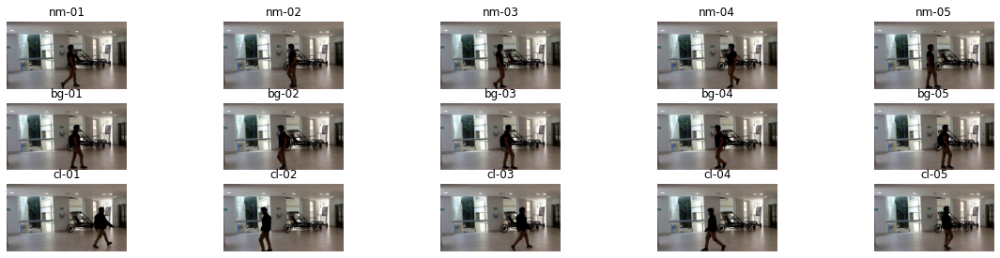

SHOWING VIEW: 120
Showing subject: 000 view: 120


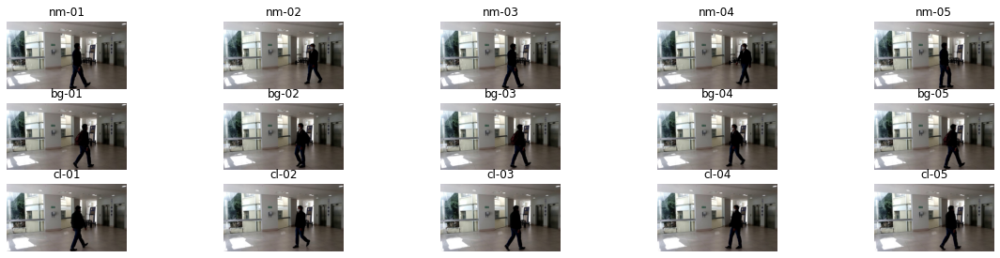

Showing subject: 001 view: 120


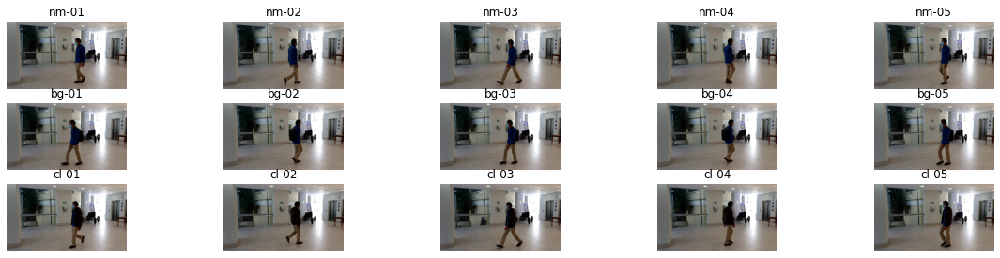

Showing subject: 002 view: 120


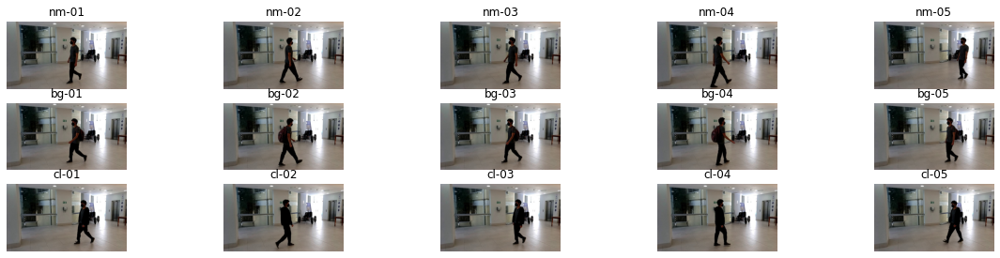

Showing subject: 003 view: 120


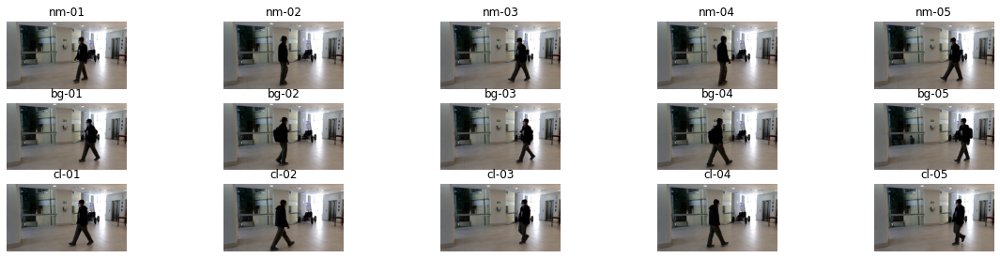

Showing subject: 004 view: 120


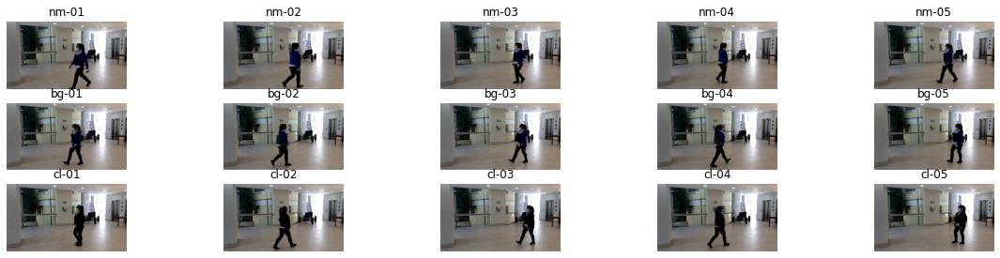

Showing subject: 005 view: 120


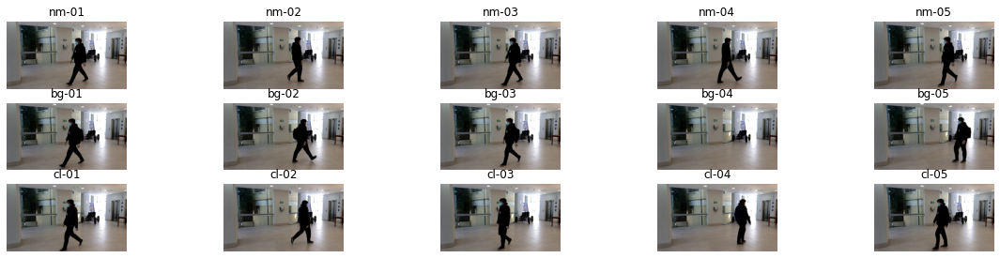

Showing subject: 006 view: 120


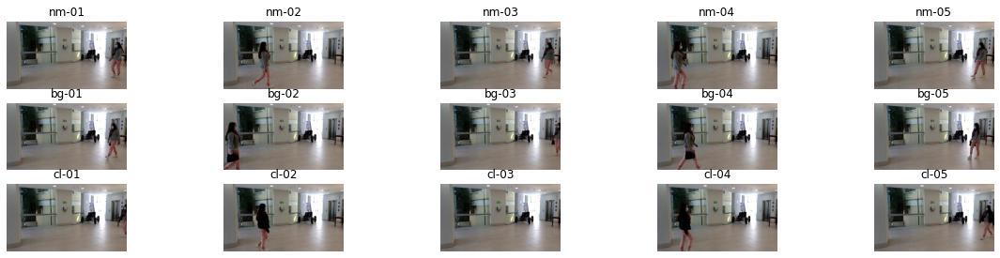

Showing subject: 007 view: 120


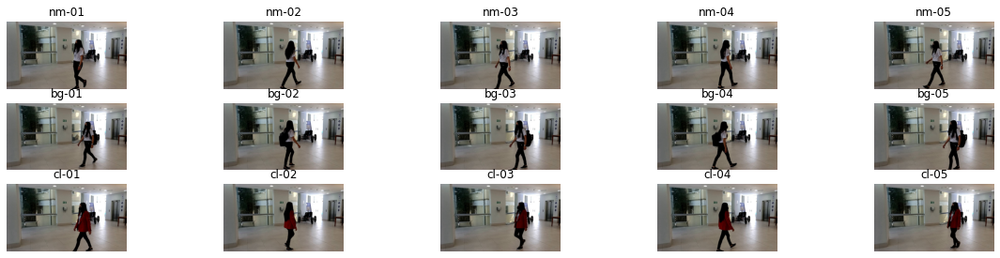

Showing subject: 008 view: 120


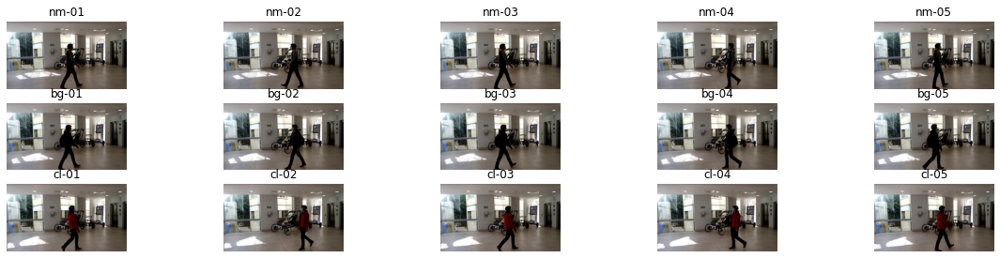

Showing subject: 009 view: 120


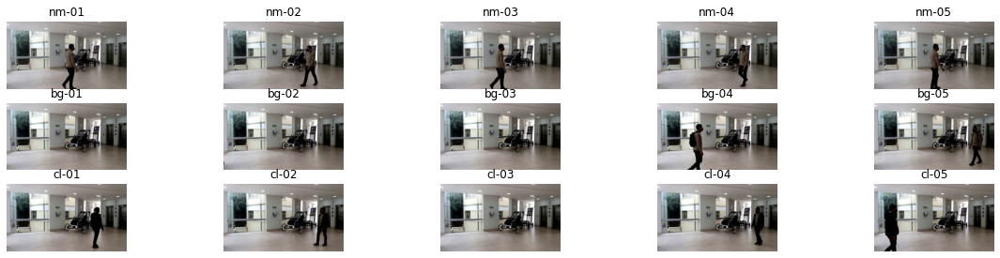

Showing subject: 010 view: 120


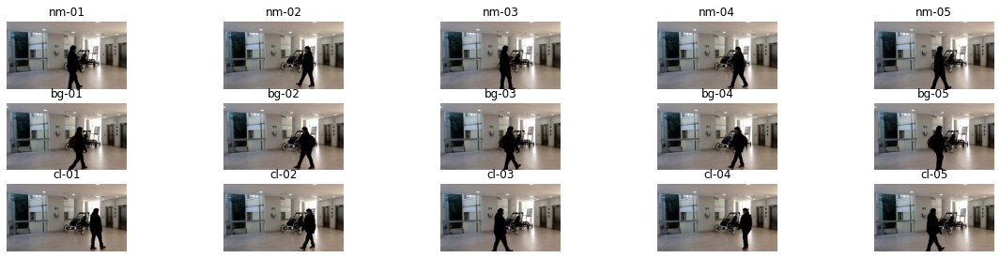

Showing subject: 011 view: 120


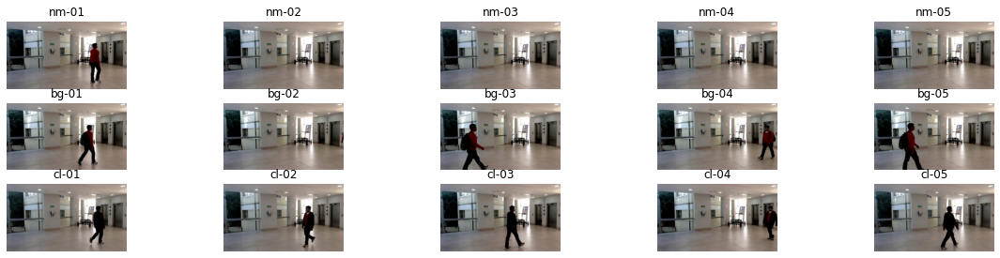

Showing subject: 012 view: 120


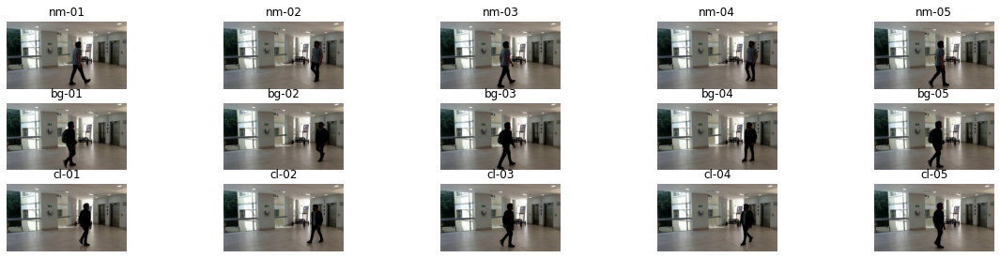

Showing subject: 013 view: 120


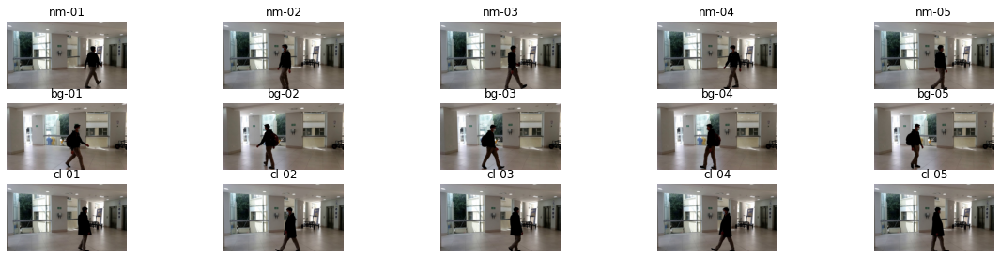

Showing subject: 014 view: 120


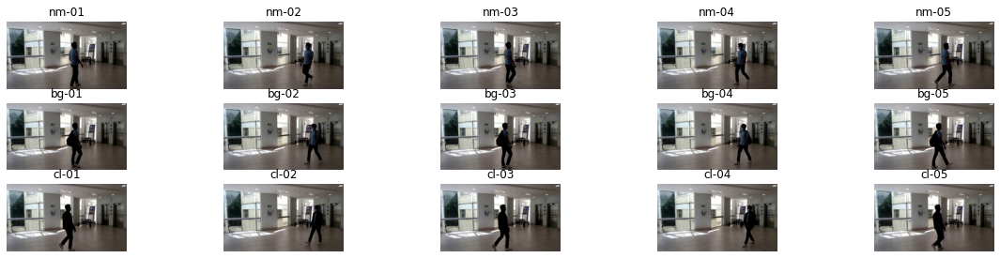

Showing subject: 015 view: 120


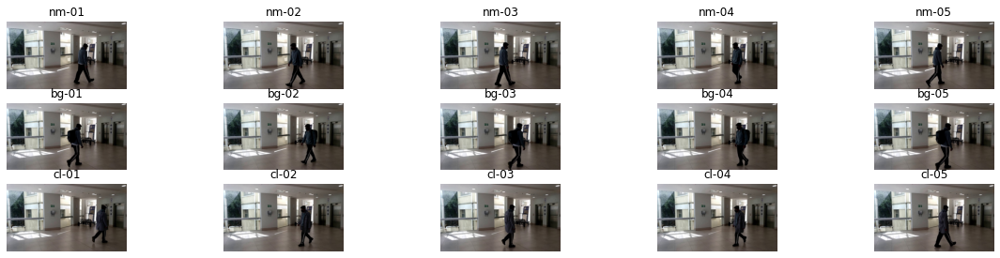

Showing subject: 016 view: 120


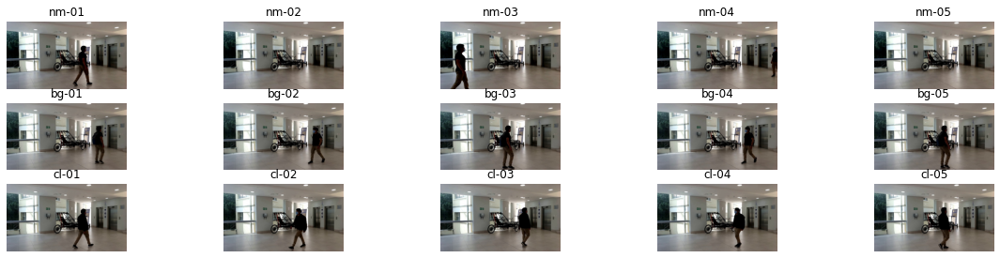

In [6]:
for view in views:

    frames_dir = os.path.join(images_dir, view, frs_dir)
    print(f'SHOWING VIEW: {view}')
    subjects = sorted(os.listdir(frames_dir))
    
    for subject in subjects:
        print(f'Showing subject: {subject} view: {view}')
        plt.figure(figsize=(20, 4.5))
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            nplot = j*5 + 1
            rseqs_dir = os.path.join(frames_dir, subject, walk)
            seqs = sorted(os.listdir(rseqs_dir))
            for i, seq in enumerate(seqs):
                try:
                    rgb = cv2.cvtColor(cv2.imread(os.path.join(rseqs_dir, seq, f'{str(40).zfill(4)}.jpg')), cv2.COLOR_BGR2RGB)               
                    plt.subplot(3, 5, nplot); plt.imshow(rgb); plt.title(seq); plt.axis('off')
                except:
                    rgb = np.zeros_like(rgb)
                    print(f'Error opening')
                nplot+=1
        plt.show()

## Generate test dataset

In [26]:
test_clips_directory = '/home/christian/Documents/Datasets/OakGait16/test_clips/'
clips_directory = '/home/christian/Documents/Datasets/OakGait16/clips'
subjects = ['000','001','002','003','004','005','006','007','008','009','010','011','012','013','014','015','016']
nclips = {'nm':8, 'bg':8, 'cl':8}
views = ['060', '075', '090', '105', '120']

In [27]:
for view in views:
    test_dir = os.path.join(test_clips_directory, view)
    print(f'PROCESSING VIEW: {view}')

    for subject in subjects:
        print(f'Processing subject: {subject} view: {view}....                                  ')
        subject_dir = os.path.join(clips_directory, view, subject)
        walks = os.listdir(subject_dir)

        for j, walk in enumerate(['nm', 'bg', 'cl']):
            create_dir(os.path.join(test_dir, subject, walk), force=True)
            walk_dir = os.path.join(subject_dir, walk)
            clips = sorted(os.listdir(walk_dir))
        
            
            for i, clip in enumerate(clips):
                if clip[-4:] == '.avi' and nclips[walk]>=i and i>5:
                    clip_path = os.path.join(walk_dir, clip)
                    sub_dir = os.path.join(test_dir, subject, walk, clip) 
                    
                    
                    cap = cv2.VideoCapture(clip_path)
                    cnt = 0

                    os.system(f"cp {clip_path} {sub_dir}")
                    

PROCESSING VIEW: 060
Processing subject: 000 view: 060....                                  
Processing subject: 001 view: 060....                                  
Processing subject: 002 view: 060....                                  
Processing subject: 003 view: 060....                                  
Processing subject: 004 view: 060....                                  
Processing subject: 005 view: 060....                                  
Processing subject: 006 view: 060....                                  
Processing subject: 007 view: 060....                                  
Processing subject: 008 view: 060....                                  
Processing subject: 009 view: 060....                                  
Processing subject: 010 view: 060....                                  
Processing subject: 011 view: 060....                                  
Processing subject: 012 view: 060....                                  
Processing subject: 013 view: 060....      

## Detection: region-of-interest extraction

For this section, the object detection model [mobileNet-ssd](https://docs.openvino.ai/latest/omz_models_model_mobilenet_ssd.html) from OpenVINO distribution was employed. It is worth mentioning that for this stage there was no retraining process, as the pre-trained model was used directly.

In [146]:
ie = Core()
device = "CPU"
model = ie.read_model(model="/home/christian/Documents/CNN-Gait-Recognition-Offline/models/public/mobilenet-ssd/FP32/mobilenet-ssd.xml")
compiled_ssd = ie.compile_model(model=model, device_name=device)
input_layer_ir = next(iter(compiled_ssd.inputs))
output_layer_ir = next(iter(compiled_ssd.outputs))



def find_ROI(img):
        img_orig = np.copy(img)
        

        img = cv2.resize(cv2.cvtColor(img, cv2.COLOR_RGB2BGR),(300,300))
        input_image = cv2.dnn.blobFromImage(img, size=(300, 300), ddepth=cv2.CV_8U)

        input_image = reshape(input_image, [-1,3,300,300])
        result = compiled_ssd.infer_new_request({0: input_image})

        x_min = next(iter(result.values()))[:,:,np.where(next(iter(result.values()))[0,0,:,1] == 15.),3]*img_orig.shape[1]
        y_min = next(iter(result.values()))[:,:,np.where(next(iter(result.values()))[0,0,:,1] == 15.),4]*img_orig.shape[0]
        x_max = next(iter(result.values()))[:,:,np.where(next(iter(result.values()))[0,0,:,1] == 15.),5]*img_orig.shape[1]
        y_max = next(iter(result.values()))[:,:,np.where(next(iter(result.values()))[0,0,:,1] == 15.),6]*img_orig.shape[0]


        (x, y, w, h) = int(x_min), int(y_min), int(x_max), int(y_max)

        offsets = [10, 10, 10, 10]
        x = x - offsets[0] if x - offsets[0] >=0 else 0
        y = y - offsets[3] if y - offsets[3] >=0 else 0
        w = w + offsets[1]+offsets[0] if w + offsets[1]+offsets[0] <=img_orig.shape[1] else img_orig.shape[1]
        h = h + offsets[3]+offsets[1] if h + offsets[3]+offsets[1] <=img_orig.shape[0] else img_orig.shape[0]
        
        return x, y, w, h

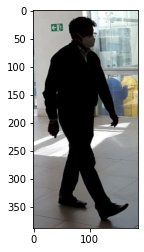

In [148]:
rgb = cv2.imread('/home/christian/Documents/Datasets/OakGait16/frames/060/rgb/000/nm/nm-03/0048.jpg')

                    
x,y,w,h = find_ROI(rgb)
bbox = [x, y, w, h]
roi = cv2.cvtColor(rgb[bbox[1]:bbox[3], bbox[0]:bbox[2]], cv2.COLOR_BGR2RGB)

plt.imshow(roi)

In [149]:
images_dir = '/home/christian/Documents/Datasets/OakGait16/frames/'
region_of_interest_dir = '/home/christian/Documents/Datasets/OakGait16/region_of_interest/'
frs_dir = 'rgb/'
views = ['060','075','090','105','120']

In [150]:
for view in views:
    frames_dir = os.path.join(images_dir, view, frs_dir)
    rois_dir = os.path.join(region_of_interest_dir, view)
    print(f'PROCESSING VIEW: {view}')
    subjects = sorted(os.listdir(frames_dir))
    
    for subject in subjects:
        print(f'Processing subject: {subject} view: {view}')
        create_dir(os.path.join(rois_dir, subject), force=True)
        for j, walk in enumerate(['nm','bg','cl']):
            seq_dir = os.path.join(frames_dir, subject, walk)
            seqs = sorted(os.listdir(seq_dir))
            for s, seq in enumerate(seqs):
                sub_roi_dir = os.path.join(rois_dir, subject, walk, seq) 
                create_dir(sub_roi_dir , force=True)
                seq_frames_dir = os.path.join(seq_dir, seq)
                lfiles = sorted(os.listdir(seq_frames_dir))
                cnt = 0
                for idimg, path in enumerate(lfiles):
                
                    rgb_name = os.path.join(seq_frames_dir, path)
                    rgb = cv2.imread(rgb_name)    
                    
                    try:
                        x,y,w,h = find_ROI(rgb)
                        bbox =  [x, y, w, h]
                        roi = cv2.cvtColor(rgb[bbox[1]:bbox[3], bbox[0]:bbox[2]], cv2.COLOR_BGR2RGB)
                        roi_name = os.path.join(sub_roi_dir, f'{subject}-{seq}-{str(cnt).zfill(2)}.jpg')      
                        cv2.imwrite(roi_name, roi)
                        cnt += 1
                    
                    except:
                        pass

PROCESSING VIEW: 060
Processing subject: 000 view: 060
Processing subject: 001 view: 060
Processing subject: 002 view: 060
Processing subject: 003 view: 060
Processing subject: 004 view: 060
Processing subject: 005 view: 060
Processing subject: 006 view: 060
Processing subject: 007 view: 060
Processing subject: 008 view: 060
Processing subject: 009 view: 060
Processing subject: 010 view: 060
Processing subject: 011 view: 060
Processing subject: 012 view: 060
Processing subject: 013 view: 060
Processing subject: 014 view: 060
Processing subject: 015 view: 060
Processing subject: 016 view: 060
PROCESSING VIEW: 075
Processing subject: 000 view: 075
Processing subject: 001 view: 075
Processing subject: 002 view: 075
Processing subject: 003 view: 075
Processing subject: 004 view: 075
Processing subject: 005 view: 075
Processing subject: 006 view: 075
Processing subject: 007 view: 075
Processing subject: 008 view: 075
Processing subject: 009 view: 075
Processing subject: 010 view: 075
Proces

SHOWING VIEW: 060
Showing subject: 000 view: 060


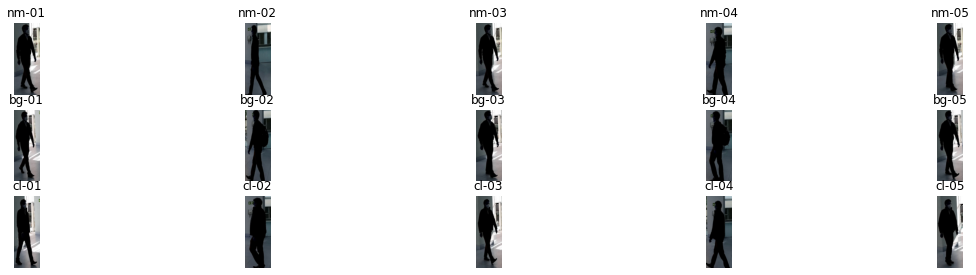

Showing subject: 001 view: 060


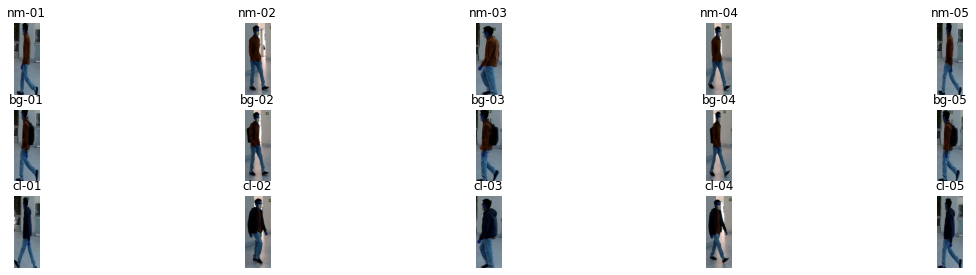

Showing subject: 002 view: 060


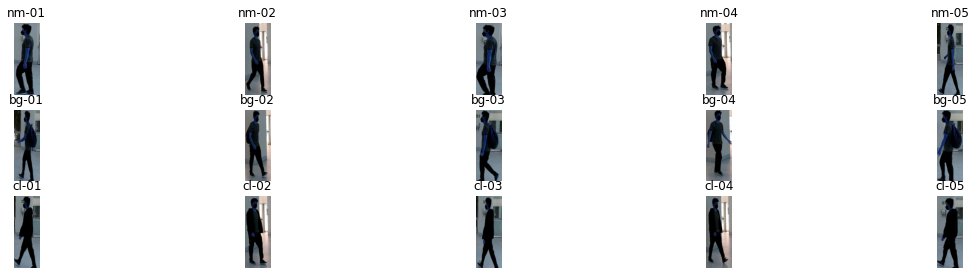

Showing subject: 003 view: 060


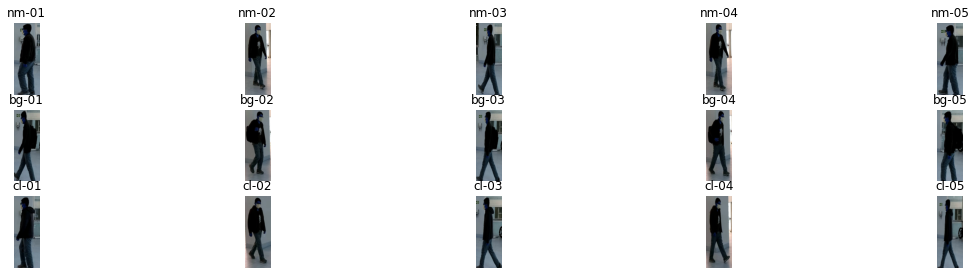

Showing subject: 004 view: 060


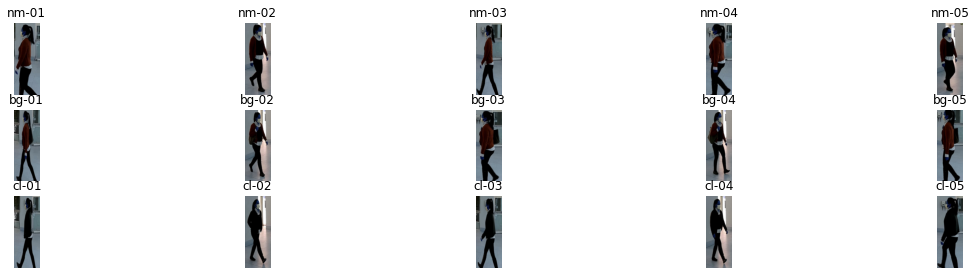

Showing subject: 005 view: 060


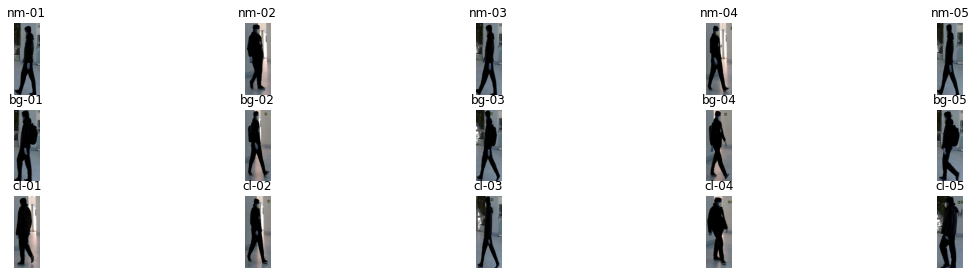

Showing subject: 006 view: 060


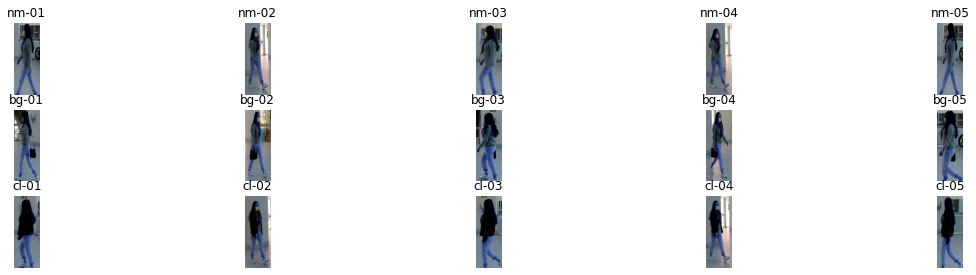

Showing subject: 007 view: 060


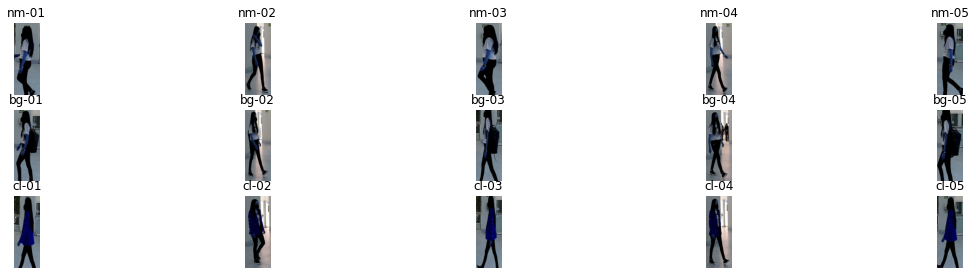

Showing subject: 008 view: 060


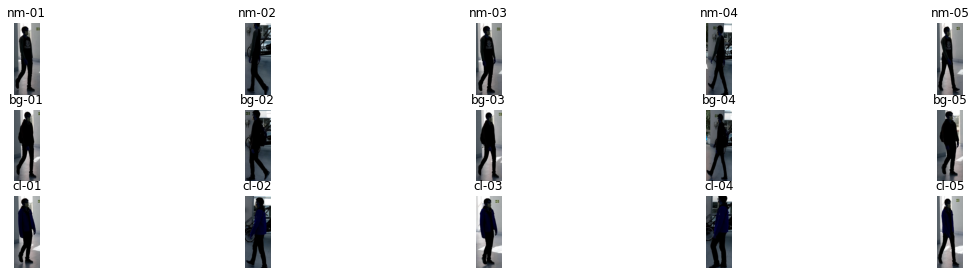

Showing subject: 009 view: 060


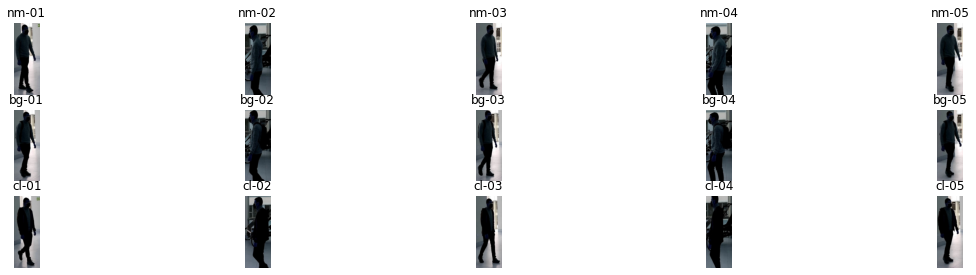

Showing subject: 010 view: 060


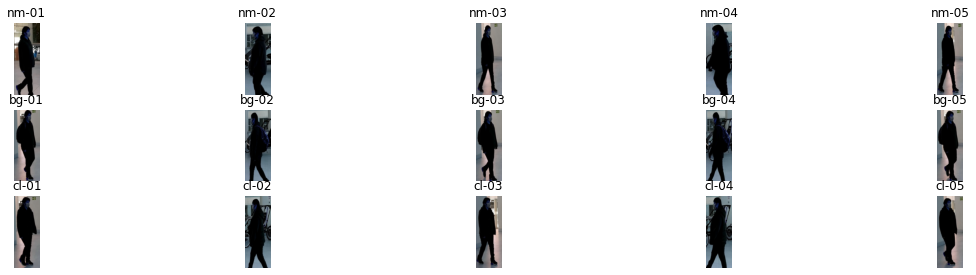

Showing subject: 011 view: 060


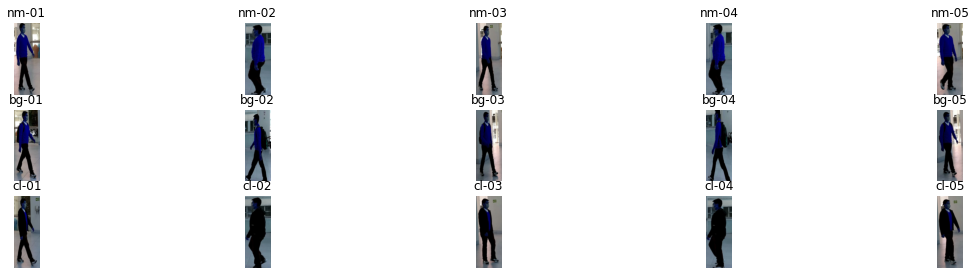

Showing subject: 012 view: 060


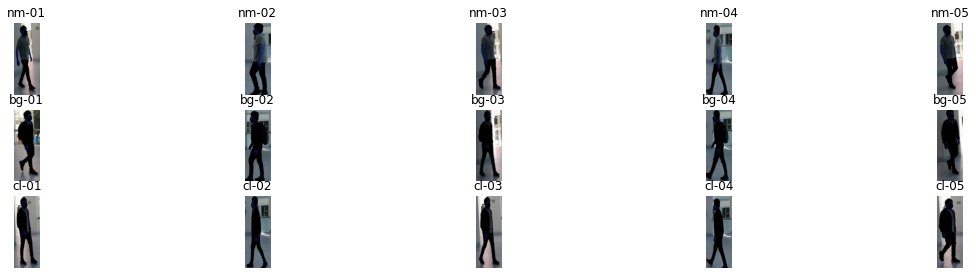

Showing subject: 013 view: 060


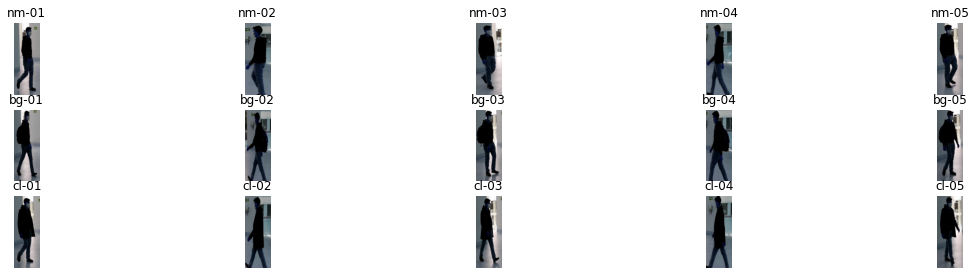

Showing subject: 014 view: 060


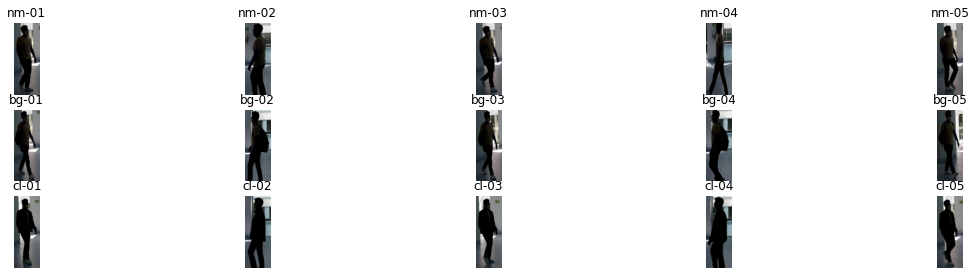

Showing subject: 015 view: 060


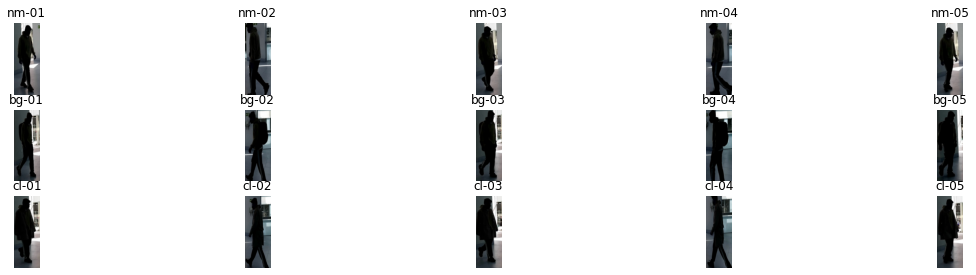

Showing subject: 016 view: 060


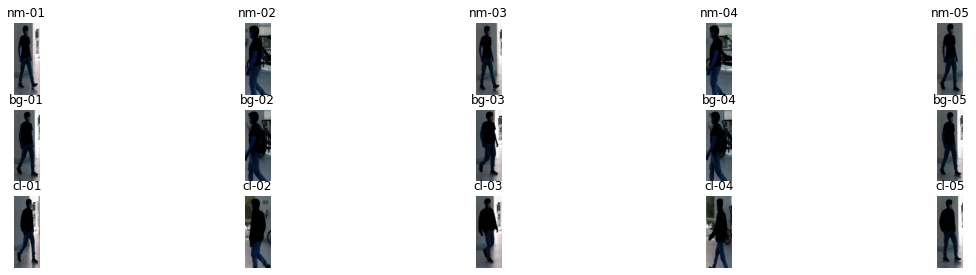

SHOWING VIEW: 075
Showing subject: 000 view: 075


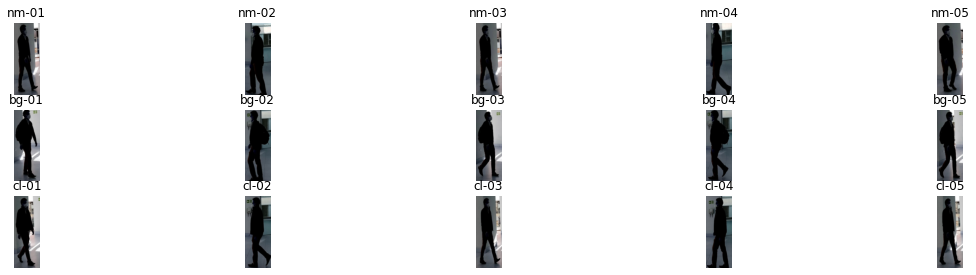

Showing subject: 001 view: 075


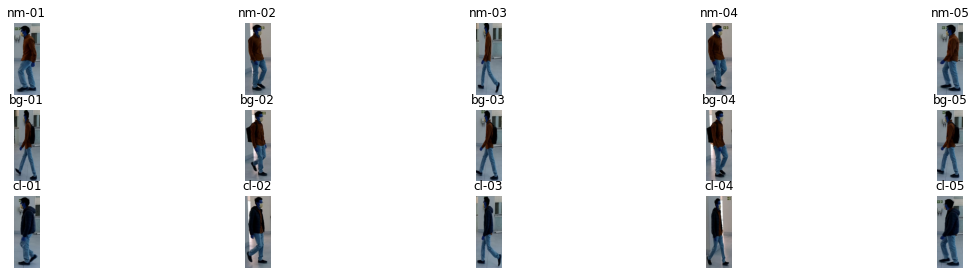

Showing subject: 002 view: 075


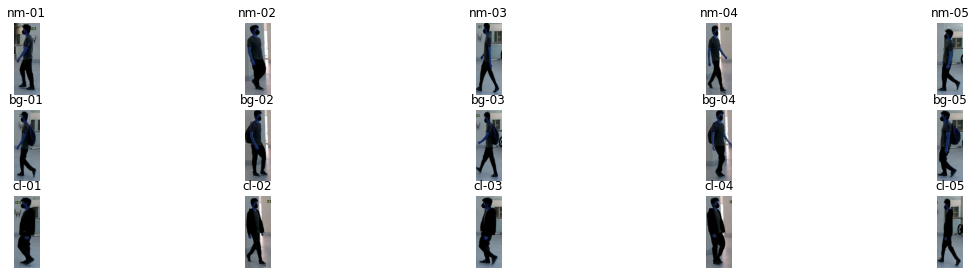

Showing subject: 003 view: 075


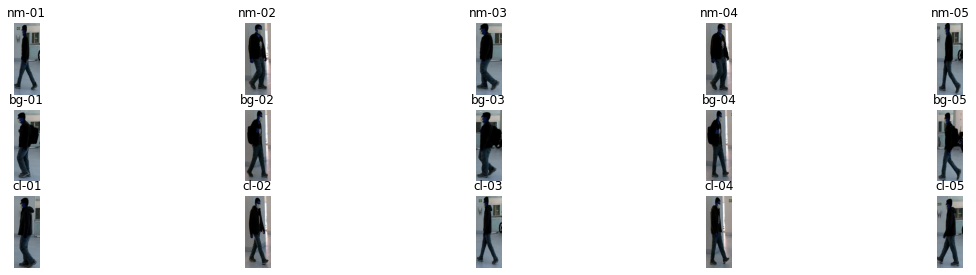

Showing subject: 004 view: 075


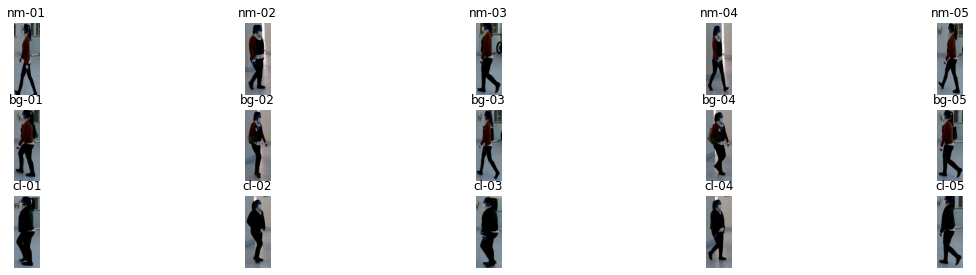

Showing subject: 005 view: 075


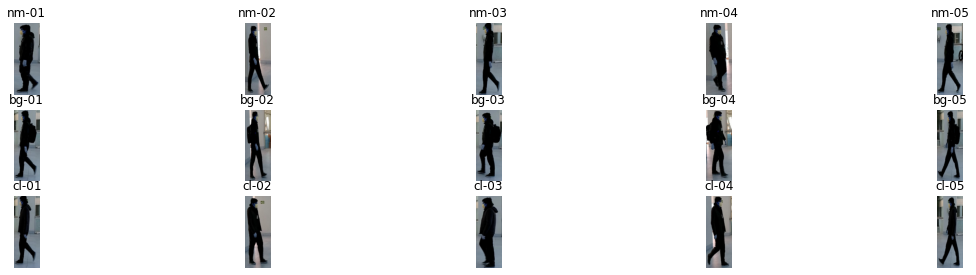

Showing subject: 006 view: 075


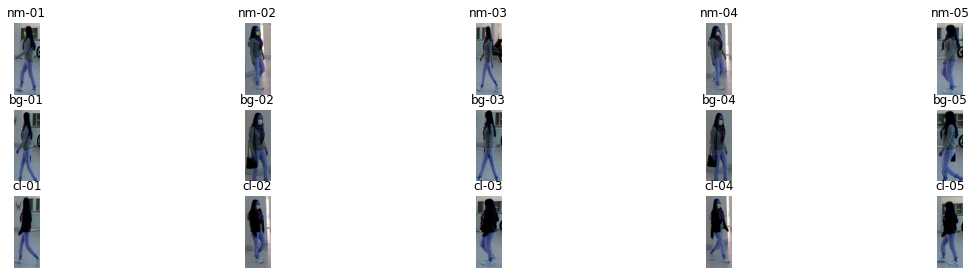

Showing subject: 007 view: 075


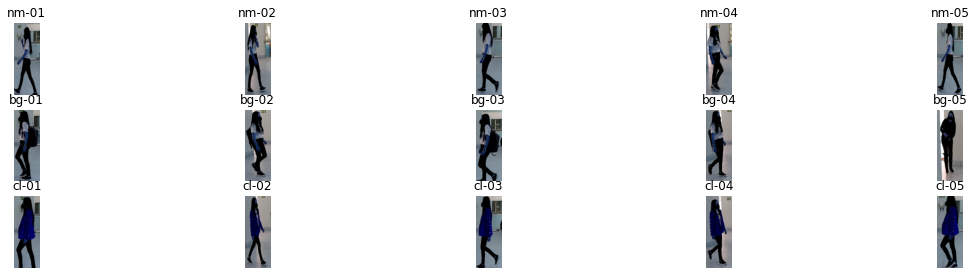

Showing subject: 008 view: 075


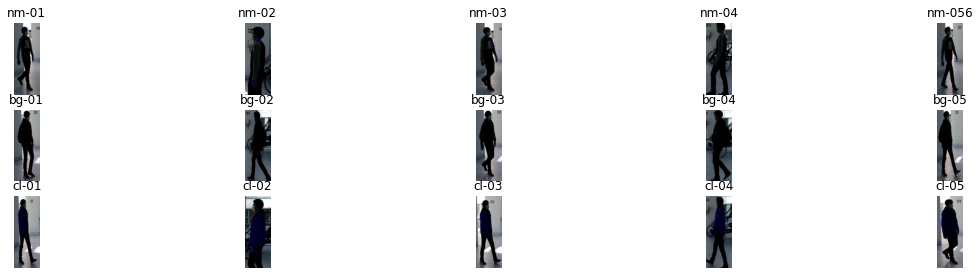

Showing subject: 009 view: 075


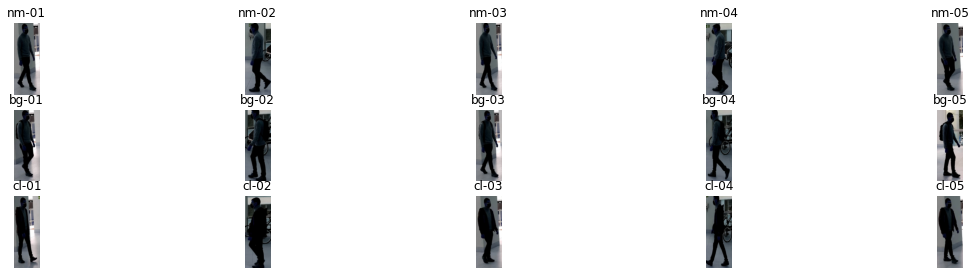

Showing subject: 010 view: 075


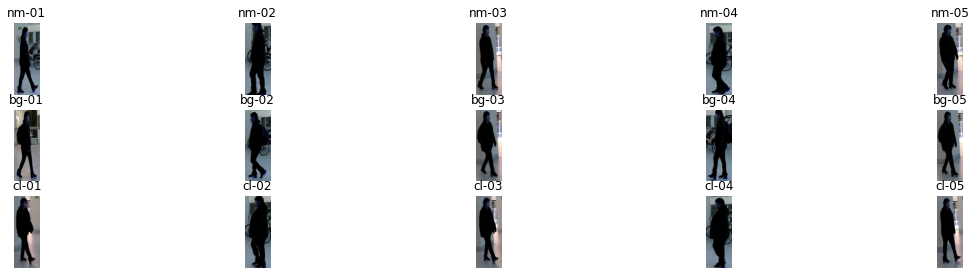

Showing subject: 011 view: 075


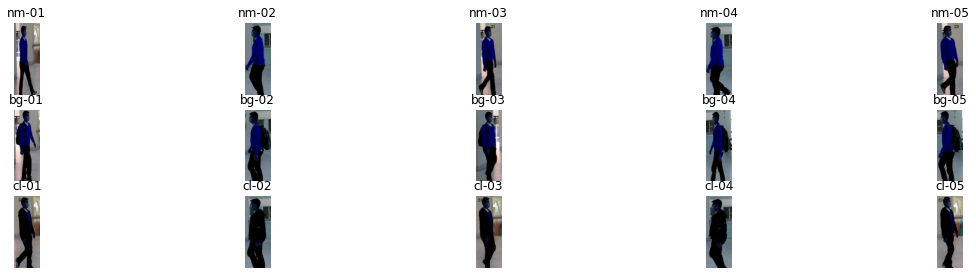

Showing subject: 012 view: 075


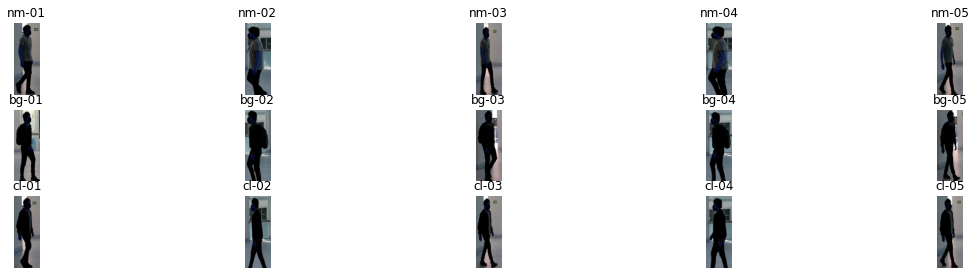

Showing subject: 013 view: 075


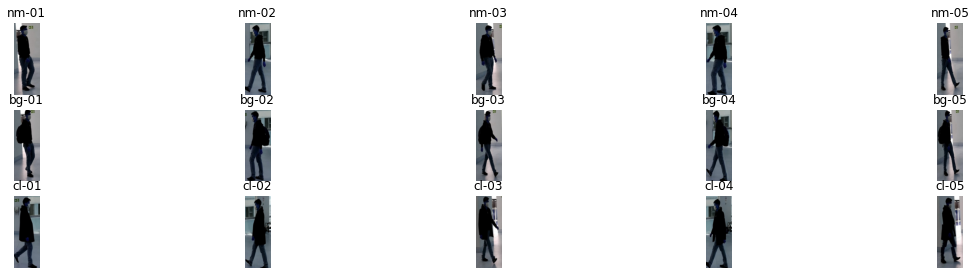

Showing subject: 014 view: 075


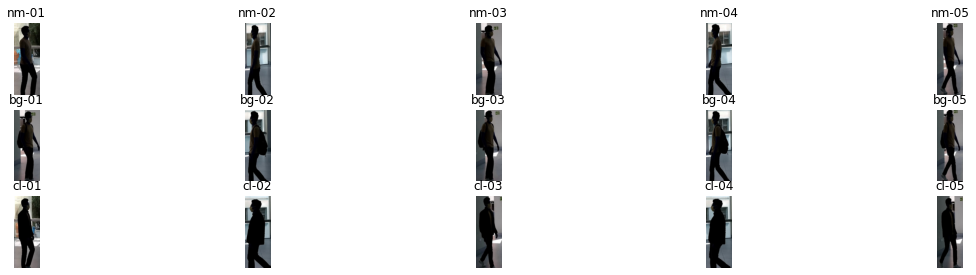

Showing subject: 015 view: 075


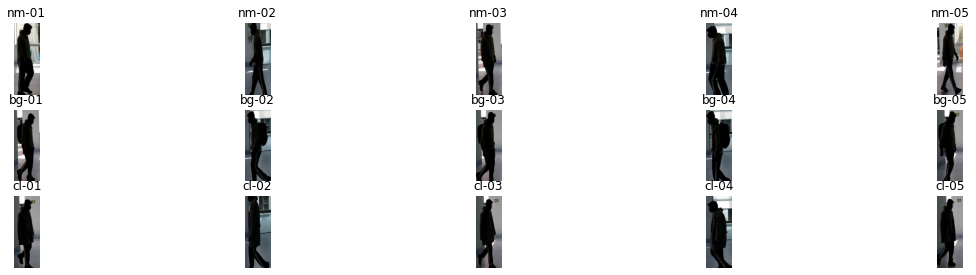

Showing subject: 016 view: 075


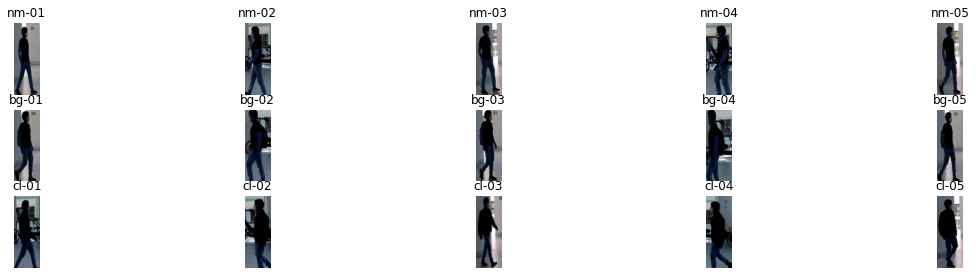

SHOWING VIEW: 090
Showing subject: 000 view: 090


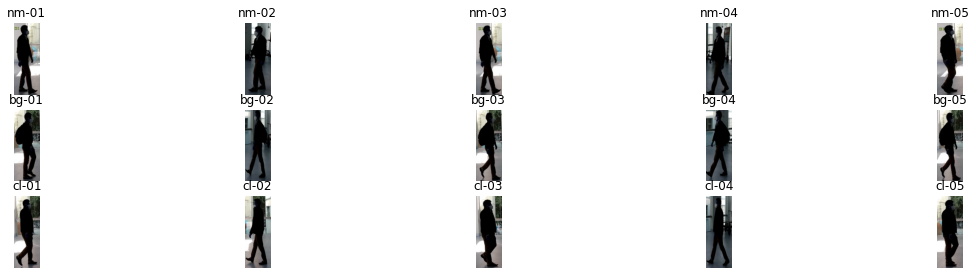

Showing subject: 001 view: 090


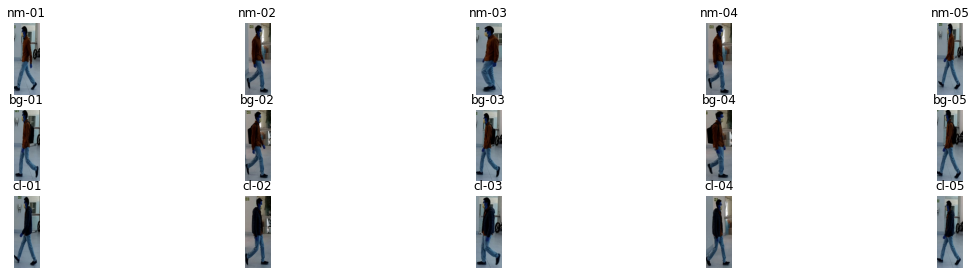

Showing subject: 002 view: 090


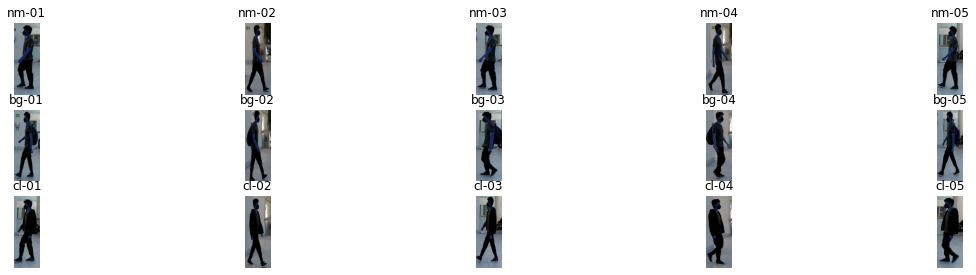

Showing subject: 003 view: 090


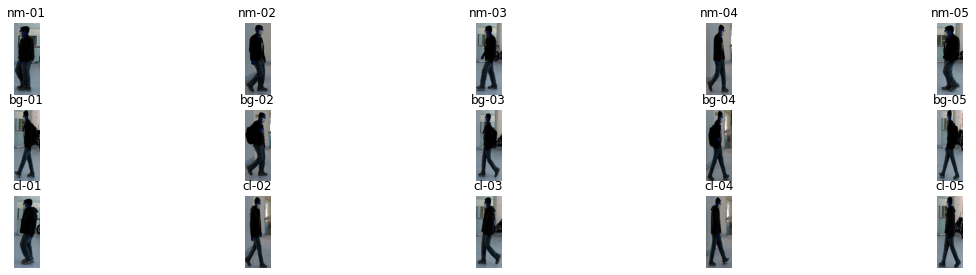

Showing subject: 004 view: 090


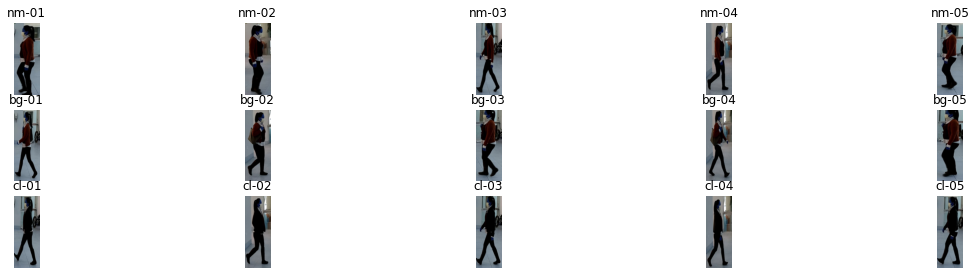

Showing subject: 005 view: 090


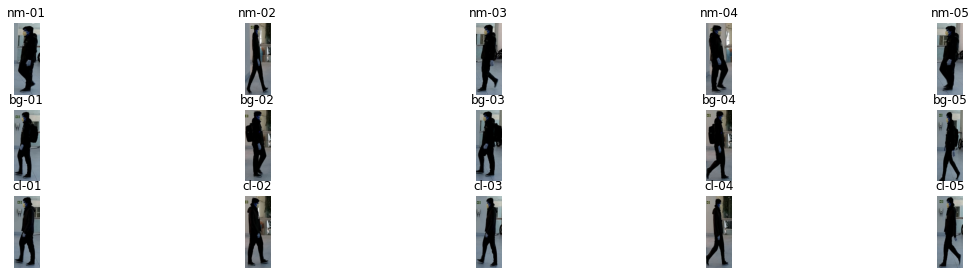

Showing subject: 006 view: 090


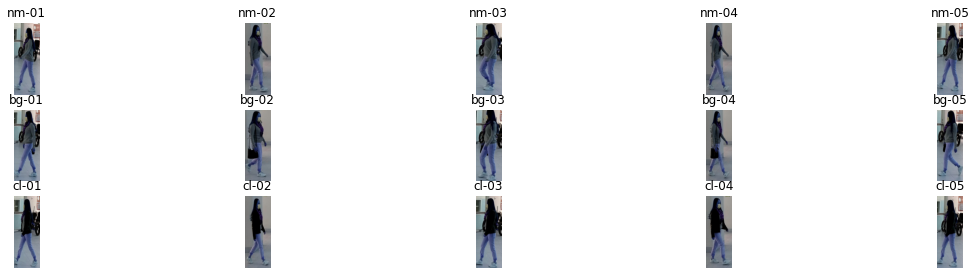

Showing subject: 007 view: 090


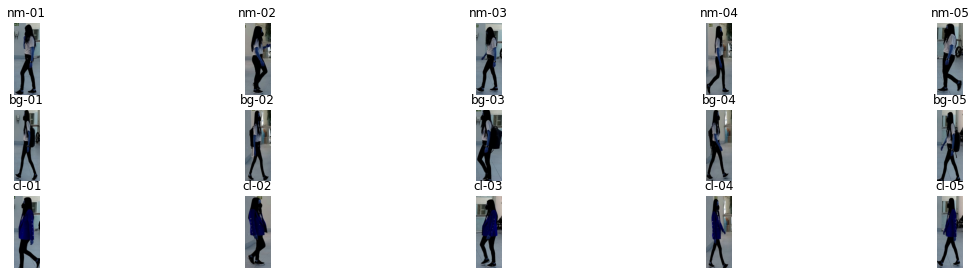

Showing subject: 008 view: 090


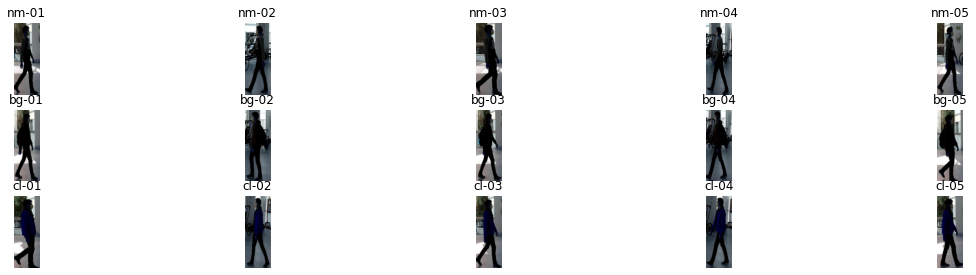

Showing subject: 009 view: 090


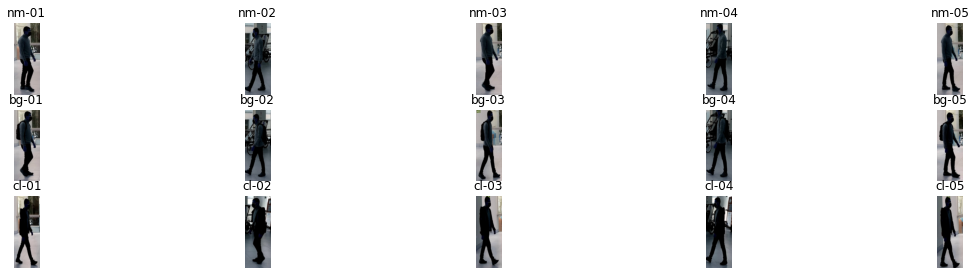

Showing subject: 010 view: 090


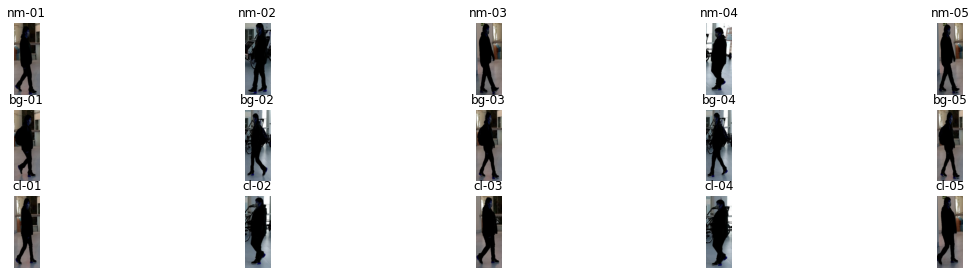

Showing subject: 011 view: 090


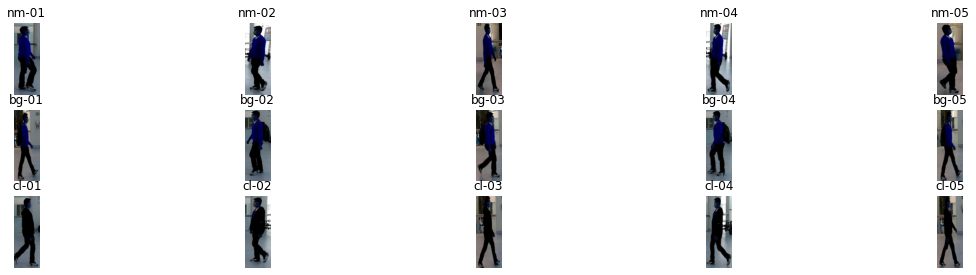

Showing subject: 012 view: 090


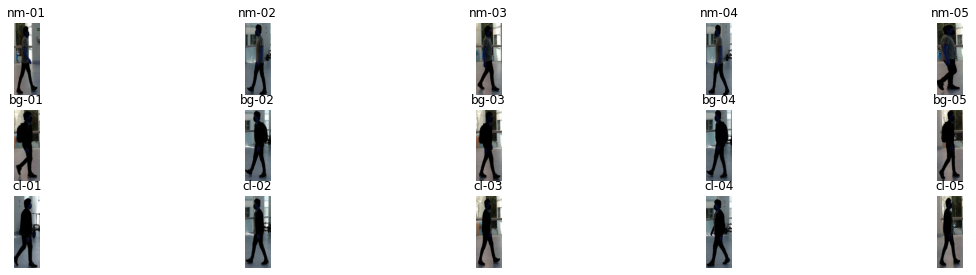

Showing subject: 013 view: 090


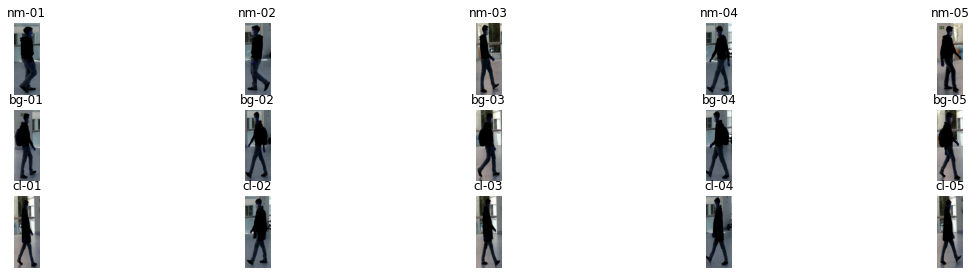

Showing subject: 014 view: 090


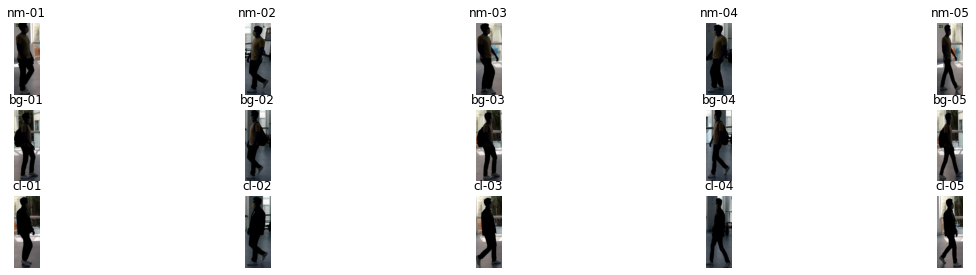

Showing subject: 015 view: 090


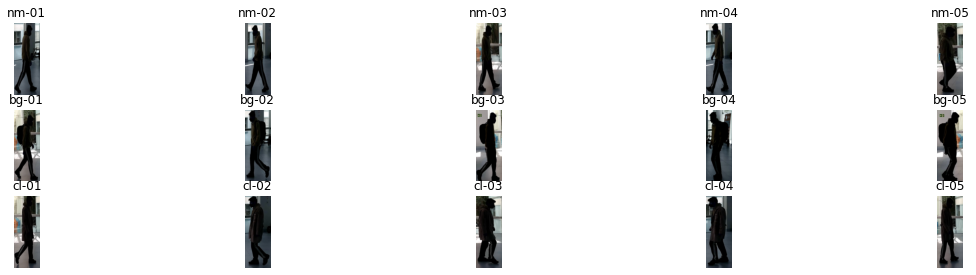

Showing subject: 016 view: 090


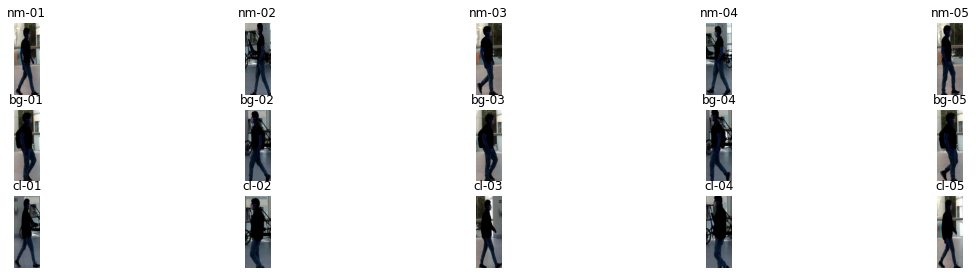

SHOWING VIEW: 105
Showing subject: 000 view: 105


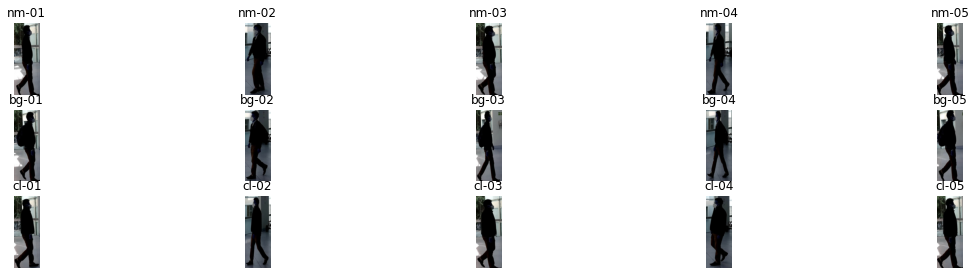

Showing subject: 001 view: 105


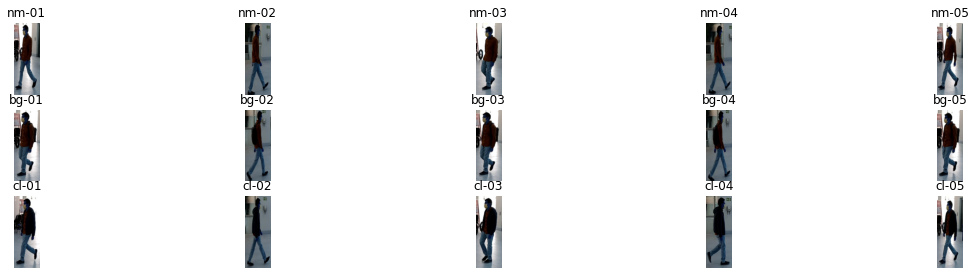

Showing subject: 002 view: 105


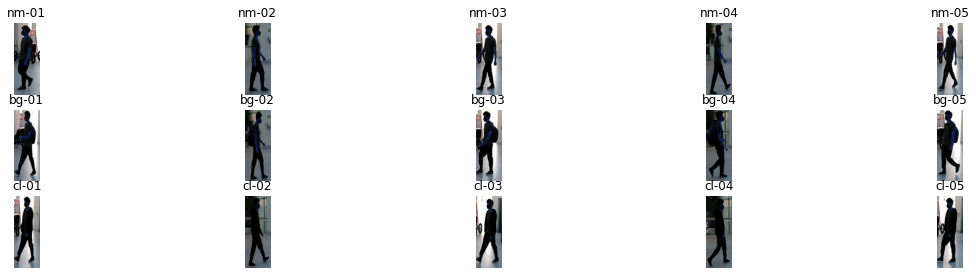

Showing subject: 003 view: 105


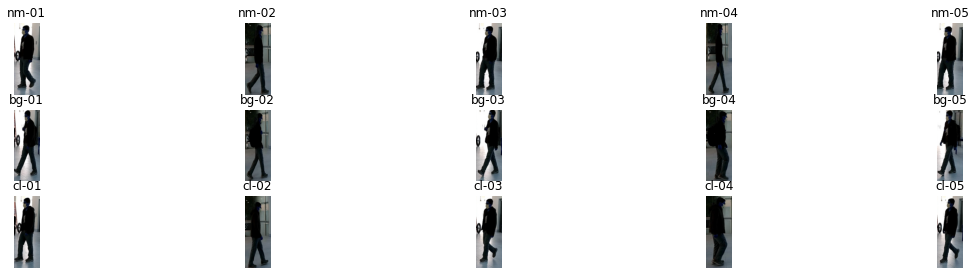

Showing subject: 004 view: 105


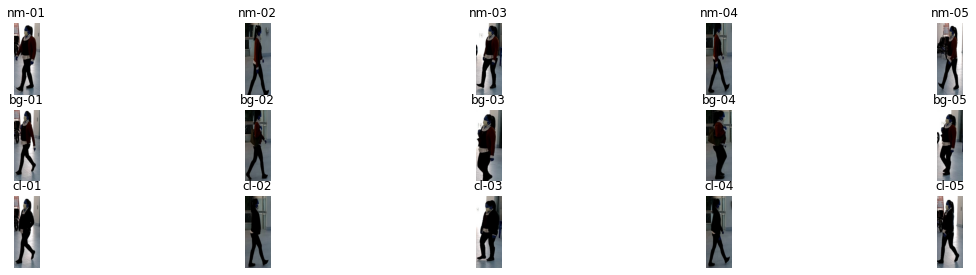

Showing subject: 005 view: 105


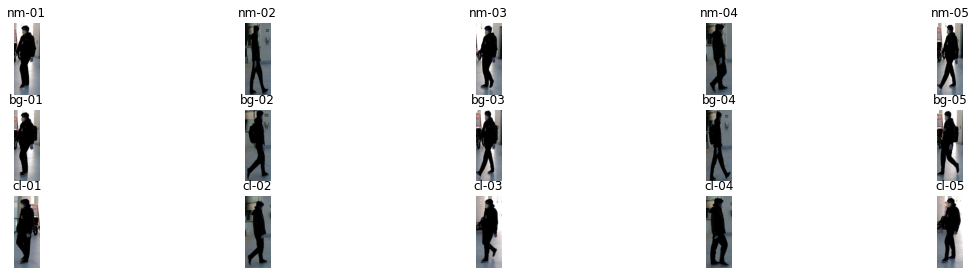

Showing subject: 006 view: 105


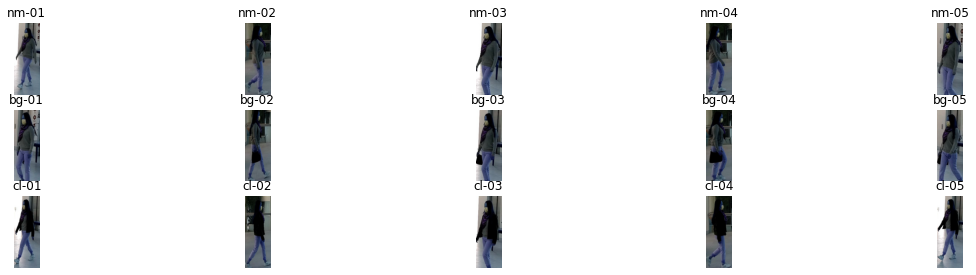

Showing subject: 007 view: 105


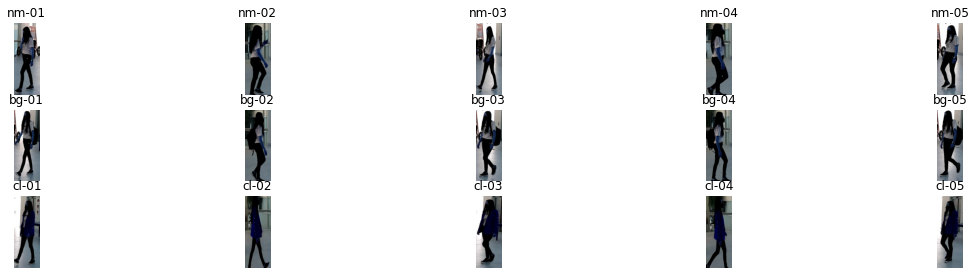

Showing subject: 008 view: 105


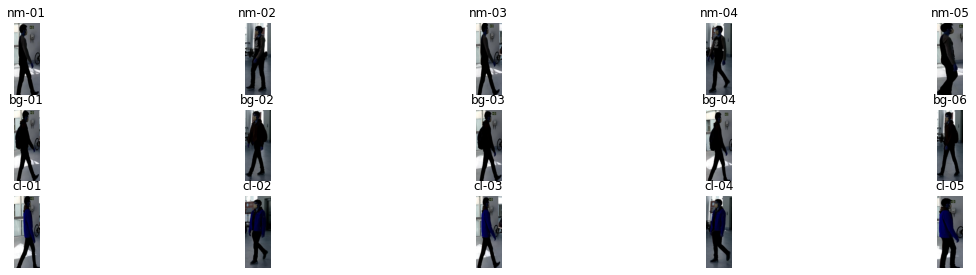

Showing subject: 009 view: 105


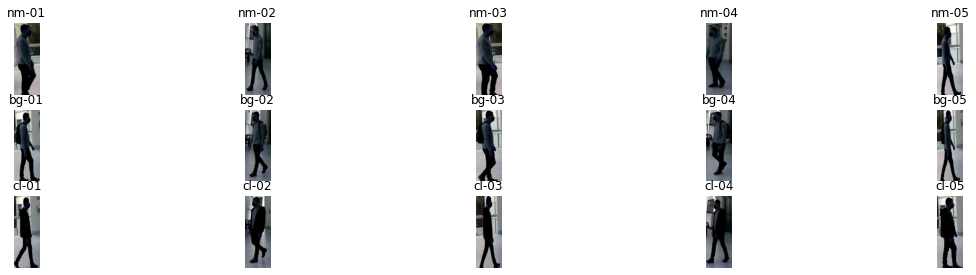

Showing subject: 010 view: 105


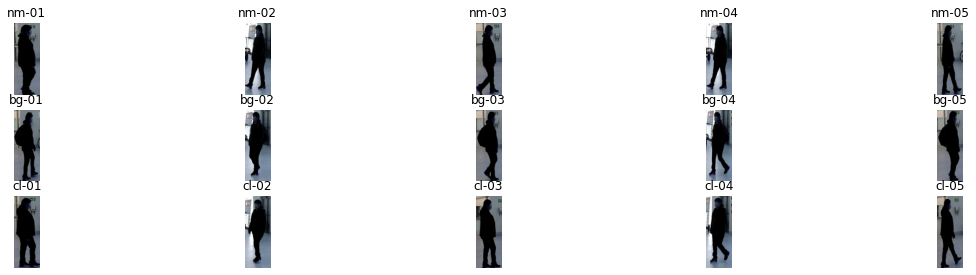

Showing subject: 011 view: 105


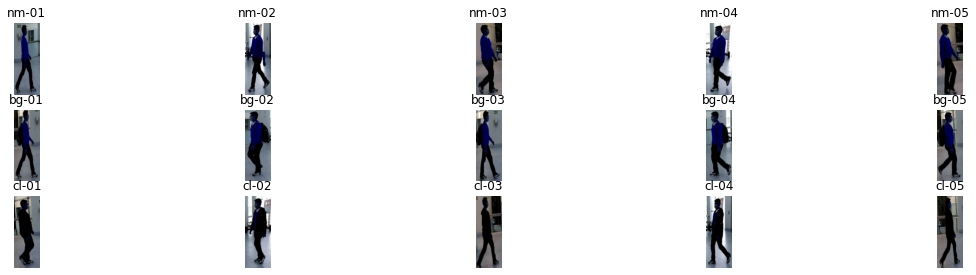

Showing subject: 012 view: 105


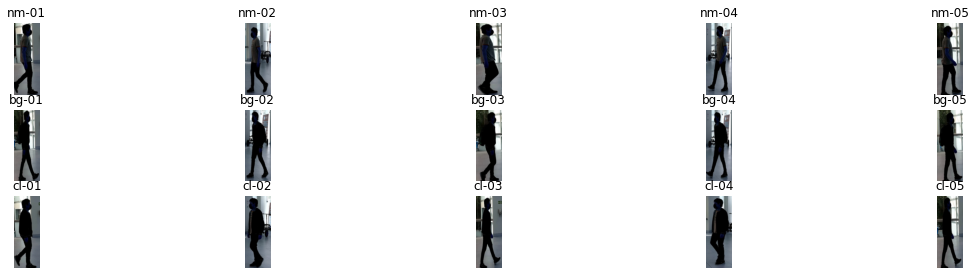

Showing subject: 013 view: 105


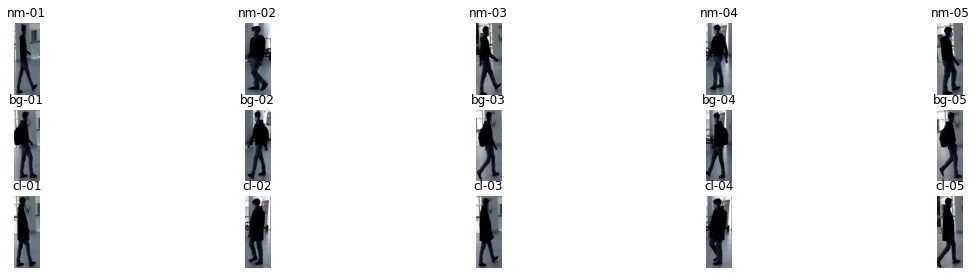

Showing subject: 014 view: 105


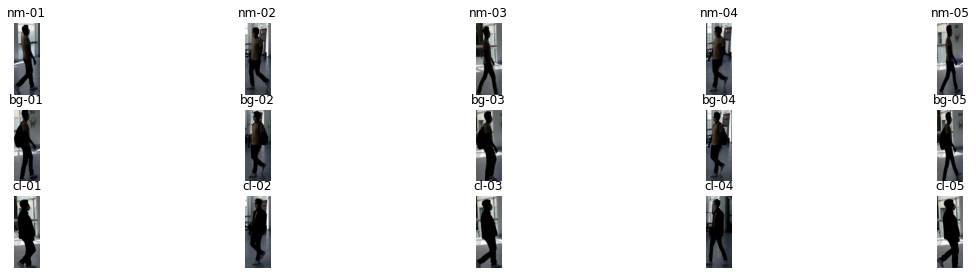

Showing subject: 015 view: 105


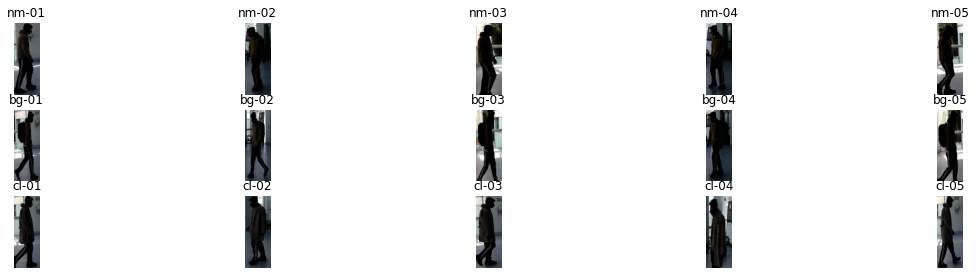

Showing subject: 016 view: 105


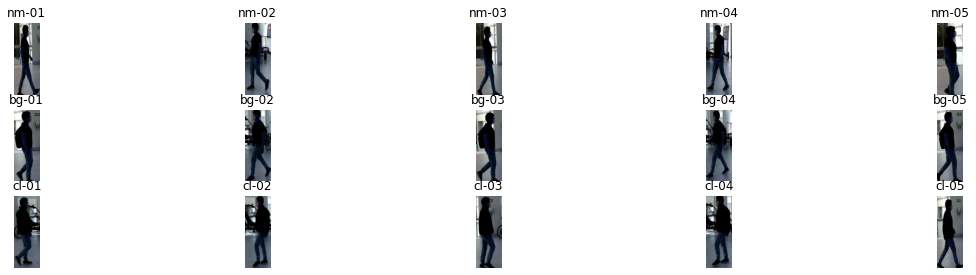

SHOWING VIEW: 120
Showing subject: 000 view: 120


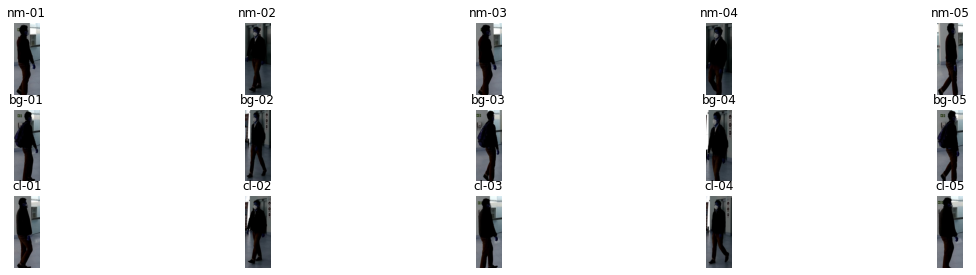

Showing subject: 001 view: 120


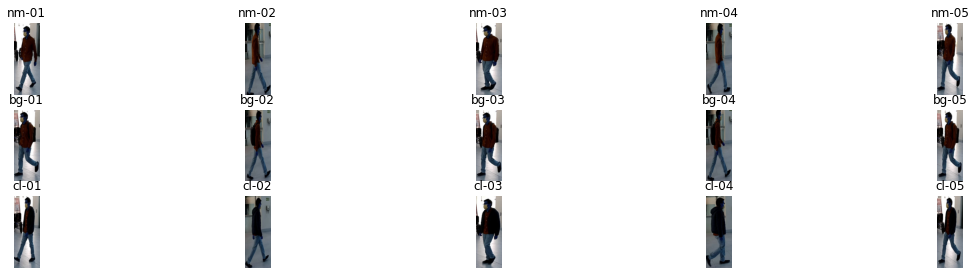

Showing subject: 002 view: 120


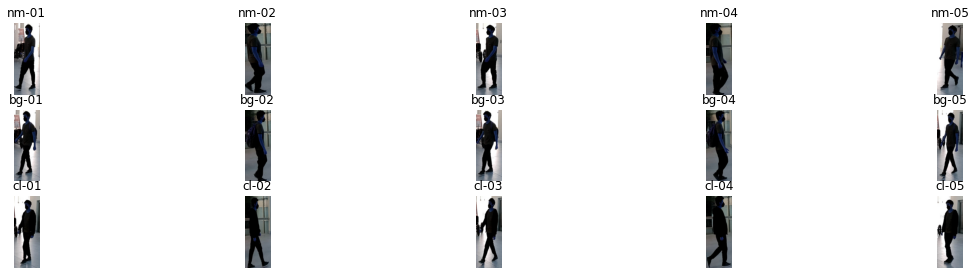

Showing subject: 003 view: 120


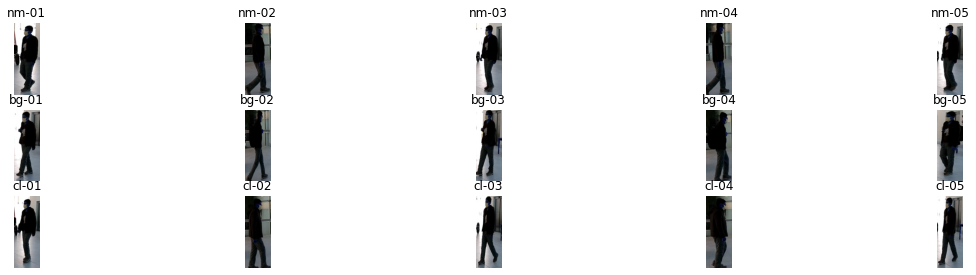

Showing subject: 004 view: 120


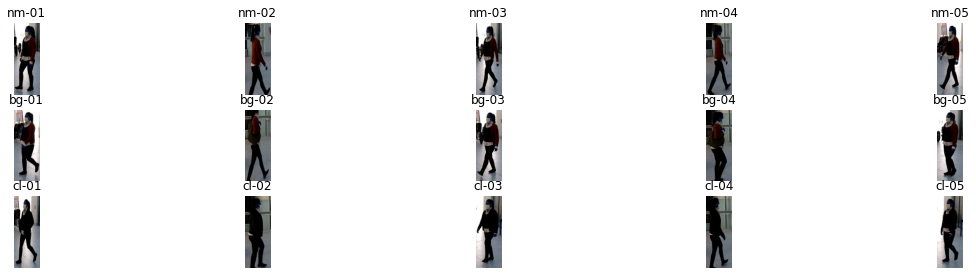

Showing subject: 005 view: 120


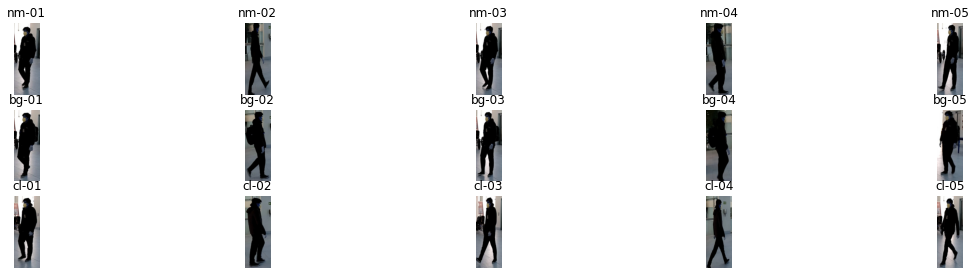

Showing subject: 006 view: 120


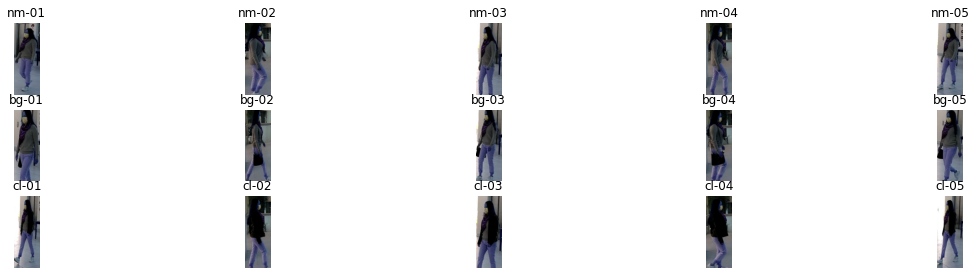

Showing subject: 007 view: 120


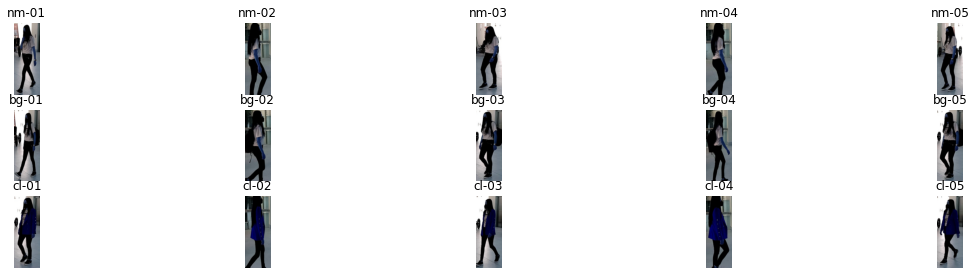

Showing subject: 008 view: 120


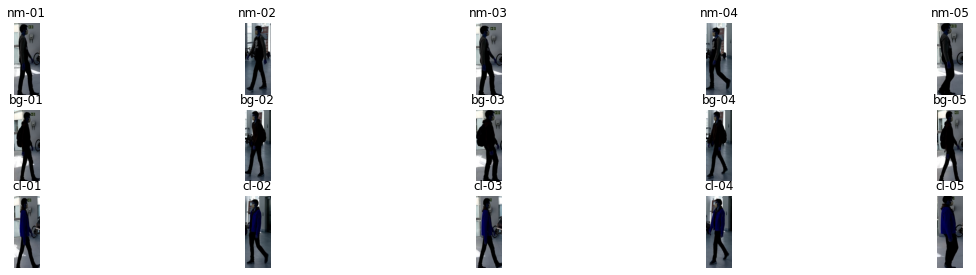

Showing subject: 009 view: 120


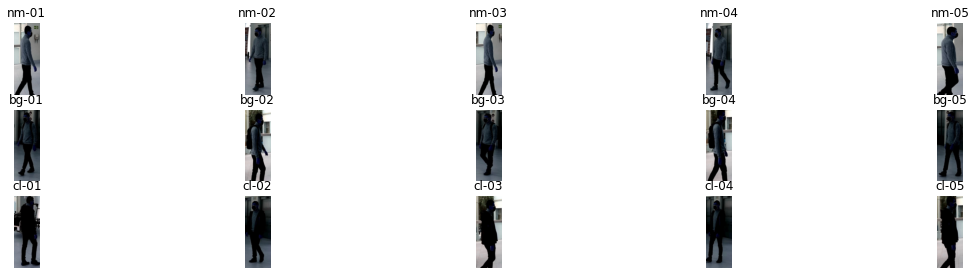

Showing subject: 010 view: 120


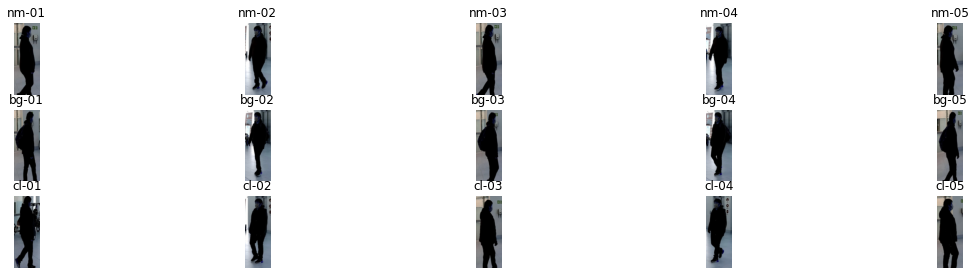

Showing subject: 011 view: 120


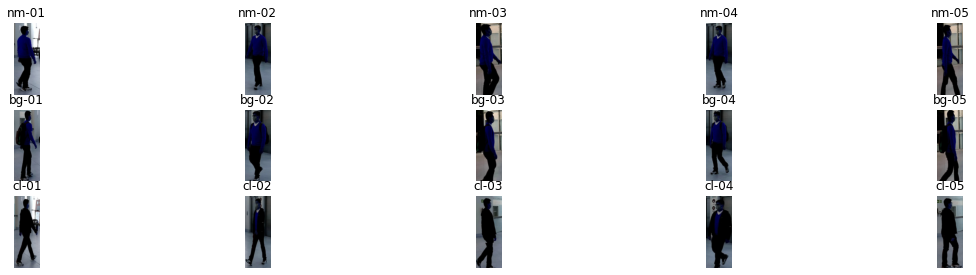

Showing subject: 012 view: 120


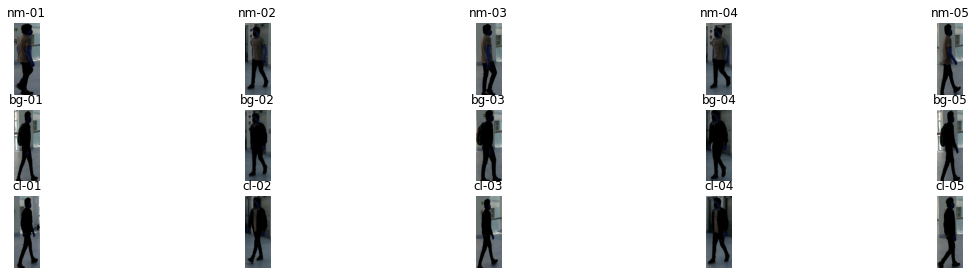

Showing subject: 013 view: 120


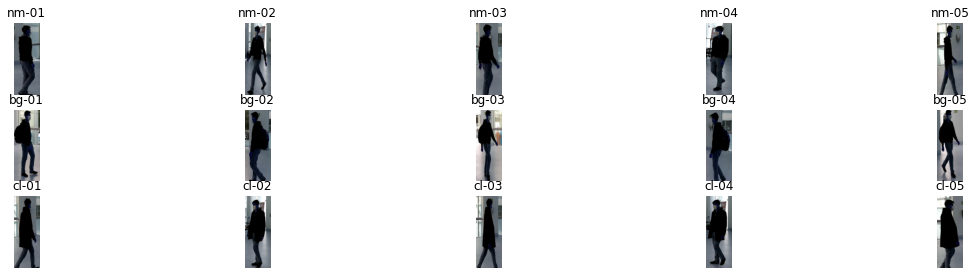

Showing subject: 014 view: 120


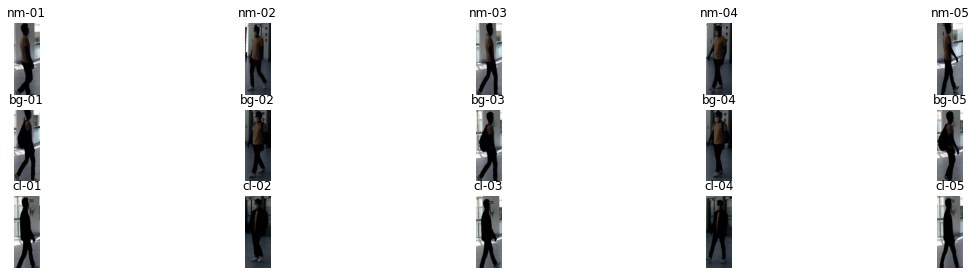

Showing subject: 015 view: 120


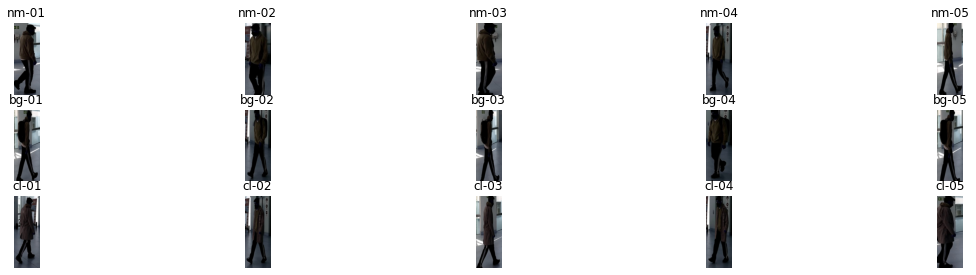

Showing subject: 016 view: 120


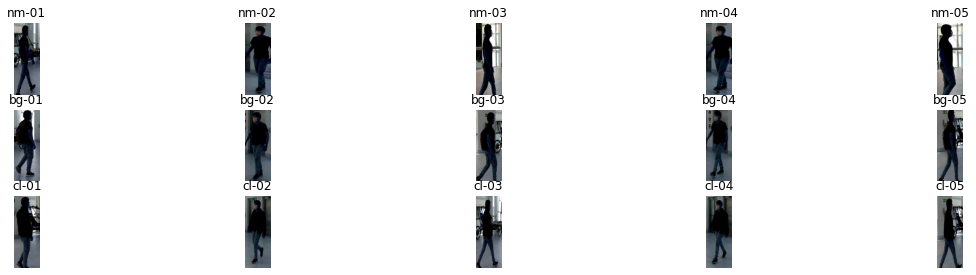

In [151]:
for view in views:
    rois_dir = os.path.join(region_of_interest_dir, view)
    print(f'SHOWING VIEW: {view}')
    subjects = sorted(os.listdir(rois_dir))
    
    for subject in subjects:
        print(f'Showing subject: {subject} view: {view}')
        plt.figure(figsize=(20, 4.5))
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            nplot = j*5 + 1
            rseqs_dir = os.path.join(rois_dir, subject, walk)
            seqs = sorted(os.listdir(rseqs_dir))
            for i, seq in enumerate(seqs):
                try:
                    roi = cv2.resize(cv2.cvtColor(cv2.imread(os.path.join(rseqs_dir, seq, f'{subject}-{seq}-{str(15)}.jpg')), cv2.COLOR_BGR2RGB), (90,250), interpolation=cv2.INTER_AREA)                

                    plt.subplot(3, 5, nplot); plt.imshow(roi); plt.title(seq); plt.axis('off')

                    
                except:
                    print(f'Error opening')
                nplot+=1
        plt.show()

## Segmentation: semantic segmentation for obtaining binary silhouettes

In [11]:
from openvino.runtime import Core

ie = Core()
device = "CPU"
model = ie.read_model(model="/home/christian/Documents/CNN-Gait-Recognition-Offline/models/128x128_acc_0.8786_loss_0.1018_val-acc_0.8875_val-loss_0.0817_0.22M_13-09-22-TF_OAKGait16.xml")
compiled_model = ie.compile_model(model=model, device_name=device)
input_layer_ir = next(iter(compiled_model.inputs))
output_layer_ir = next(iter(compiled_model.outputs))

def sil_segmentation(roi_img):
    input_image = cv2.resize(roi_img, (128,128)) 
    input_image = input_image/255.0
    input_image = reshape(input_image, [1,128,128,3])
    result = compiled_model.infer_new_request({0: input_image})
    prediction = next(iter(result.values())).transpose(0,3,1,2)
    return np.where(prediction[0][0]>0.5, 255  , 0).astype('uint8')

In [3]:
region_of_interest_dir = '/home/christian/Documents/Datasets/OakGait16/region_of_interest/'
silhouettes_dir = '/home/christian/Documents/Datasets/OakGait16/segmented_silhouettes/'
views = ['060','075','090','105','120']

In [12]:
def sil_centering(img, size=64):
    biggest = np.zeros_like(img)
    contours1, _ = cv2.findContours(img.copy(),cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnt=max(contours1, key=cv2.contourArea)
    cv2.drawContours(biggest, [cnt], -1, 255, -1)    
    
    
    if (len(contours1)>0):
        ncoun= np.concatenate(contours1)[:, 0, :]
        x1, y1 = np.min(ncoun, axis=0)
        x2, y2 = np.max(ncoun, axis=0)
        silhouette = biggest[y1:y2, x1:x2]

        factor = size/max(silhouette.shape)
        height = round(factor*silhouette.shape[0])
        width = round(factor*silhouette.shape[1])

        if(height>width):
            nor_sil = cv2.resize(silhouette,(width,height))
            portion_body = 0.3
            moments = cv2.moments(nor_sil[0:int(nor_sil.shape[0]*portion_body),])
            w = round(moments['m10']/moments['m00'])
            background = np.zeros((size, size))
            shift = round((size/2)-w)
            if(shift<0 or shift+nor_sil.shape[1]>size): shift = round((size-nor_sil.shape[1])/2)
            background[:,shift:nor_sil.shape[1]+shift] = nor_sil
                

            return background

(388, 189)
(380, 155)


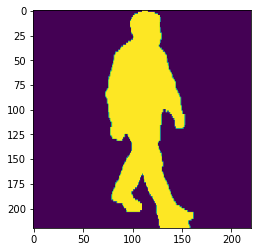

In [20]:
roi = cv2.imread("/home/christian/Documents/Datasets/OakGait16/region_of_interest/060/000/nm/nm-03/000-nm-03-48.jpg") 
roi_height = roi.shape[0]
roi_width = roi.shape[1]
roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)
sil = cv2.resize(sil_segmentation(roi), (roi_width,roi_height)) 
print(sil.shape)
if sil.mean() > 2:
    x, y, w, h = cv2.boundingRect(sil)
    seg_roi = sil[y:y+h,x:x+w]
    print(seg_roi.shape)
    sil_centered = sil_centering(sil, 220)
    plt.imshow(sil_centered)
    

In [21]:
for view in views:
    rois_dir = os.path.join(region_of_interest_dir, view)
    sils_dir = os.path.join(silhouettes_dir, view)
    print(f'PROCESSING VIEW: {view}')
    subjects = sorted(os.listdir(rois_dir))
    
    for subject in subjects:
        print(f'Processing subject: {subject} view: {view}')
        create_dir(os.path.join(sils_dir, subject), force=True)
        for j, walk in enumerate(['nm','bg','cl']):
            seq_dir = os.path.join(rois_dir, subject, walk)
            seqs = sorted(os.listdir(seq_dir))
            for s, seq in enumerate(seqs):
                sub_sil_dir = os.path.join(sils_dir, subject, walk, seq) 
                create_dir(sub_sil_dir , force=True)
                seq_rois_dir = os.path.join(seq_dir, seq)
                lfiles = sorted(os.listdir(seq_rois_dir))
                cnt = 0
                
                
                for idimg, path in enumerate(lfiles):
                    
                    roi_name = os.path.join(seq_rois_dir, path)
                    roi = cv2.imread(roi_name) 
                    roi_height = roi.shape[0]
                    roi_width = roi.shape[1]
                
                    
                    try:

                        sil = cv2.resize(sil_segmentation(roi), (roi_width,roi_height)) 

                        if sil.mean() > 2:
                            x, y, w, h = cv2.boundingRect(sil)
                            seg_roi = sil[y:y+h,x:x+w]
                            sil_centered = sil_centering(sil, 220)
                            sil_name = os.path.join(sub_sil_dir, f'{path.split(".")[0]}.jpg')      
                            cv2.imwrite(sil_name, sil_centered)
                            cnt += 1
                        
                    except:
                        pass

PROCESSING VIEW: 060
Processing subject: 000 view: 060
Processing subject: 001 view: 060
Processing subject: 002 view: 060
Processing subject: 003 view: 060
Processing subject: 004 view: 060
Processing subject: 005 view: 060
Processing subject: 006 view: 060
Processing subject: 007 view: 060
Processing subject: 008 view: 060
Processing subject: 009 view: 060
Processing subject: 010 view: 060
Processing subject: 011 view: 060
Processing subject: 012 view: 060
Processing subject: 013 view: 060
Processing subject: 014 view: 060
Processing subject: 015 view: 060
Processing subject: 016 view: 060
PROCESSING VIEW: 075
Processing subject: 000 view: 075
Processing subject: 001 view: 075
Processing subject: 002 view: 075
Processing subject: 003 view: 075
Processing subject: 004 view: 075
Processing subject: 005 view: 075
Processing subject: 006 view: 075
Processing subject: 007 view: 075
Processing subject: 008 view: 075
Processing subject: 009 view: 075
Processing subject: 010 view: 075
Proces

SHOWING VIEW: 060
Showing subject: 000 view: 060


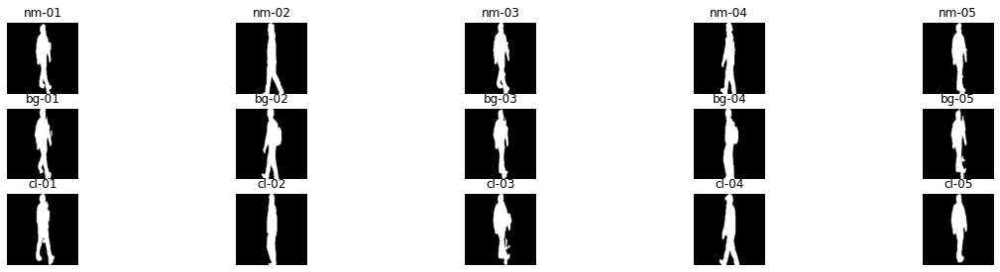

Showing subject: 001 view: 060


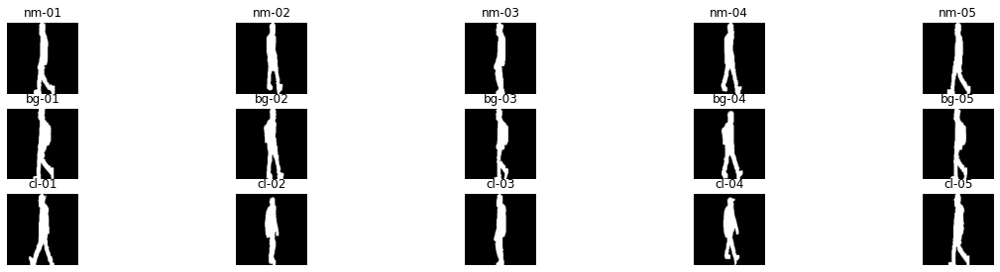

Showing subject: 002 view: 060


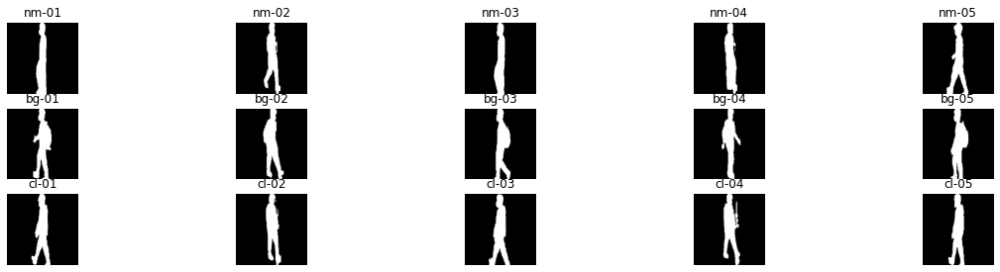

Showing subject: 003 view: 060


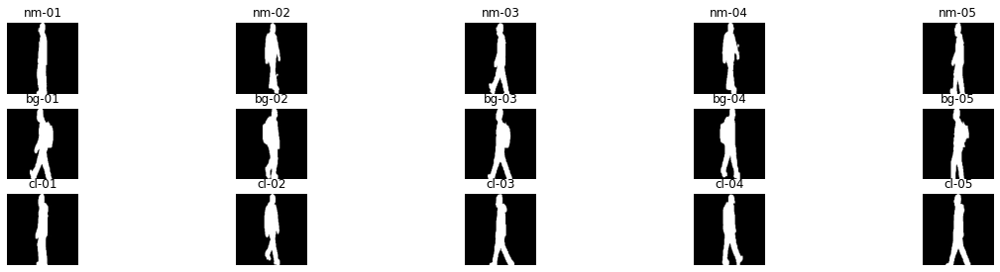

Showing subject: 004 view: 060


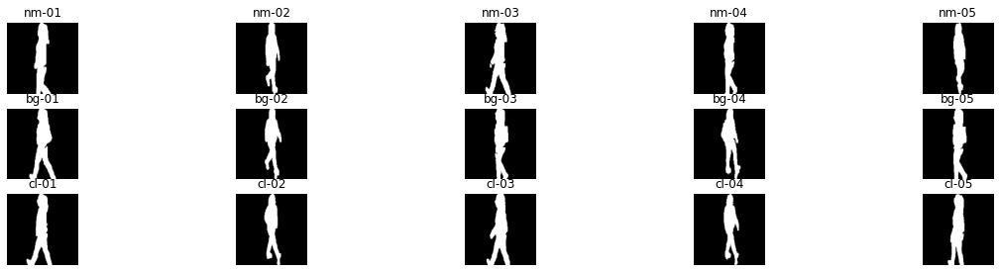

Showing subject: 005 view: 060


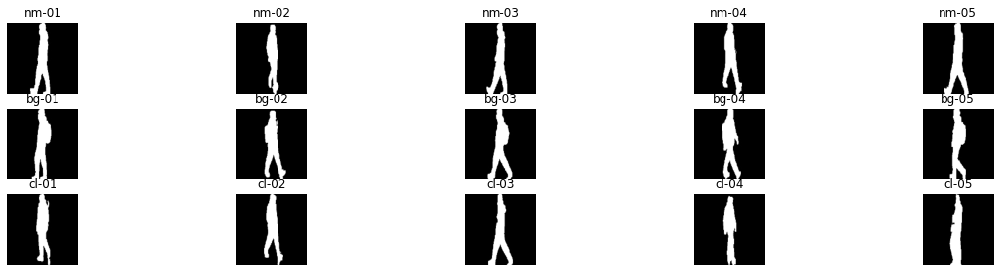

Showing subject: 006 view: 060


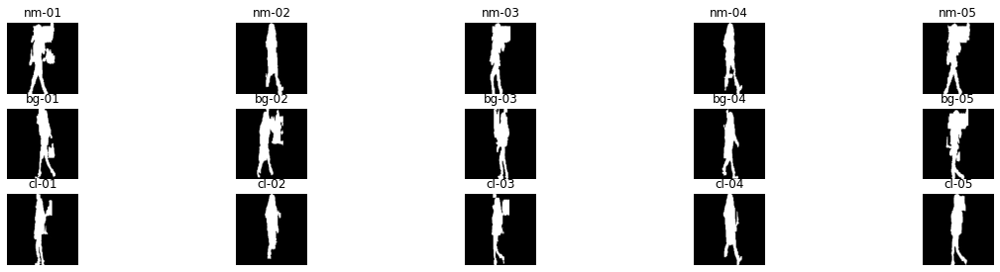

Showing subject: 007 view: 060


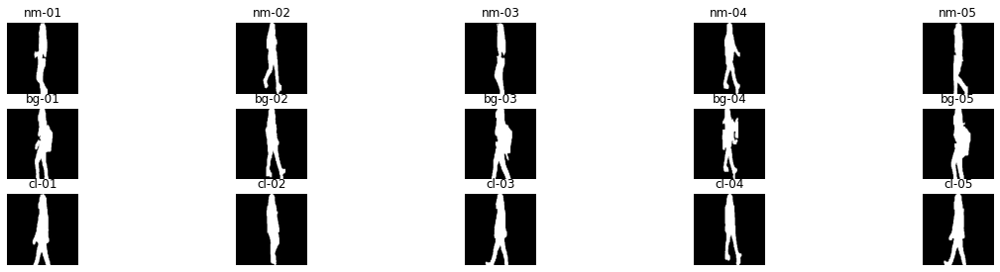

Showing subject: 008 view: 060


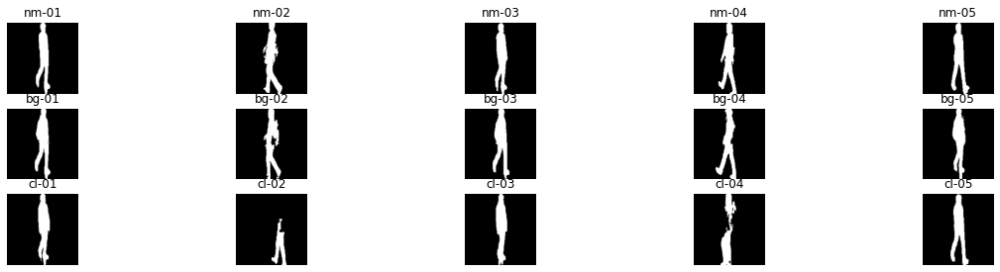

Showing subject: 009 view: 060


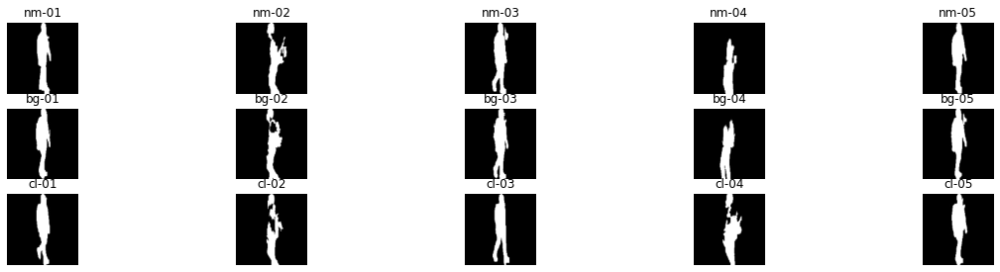

Showing subject: 010 view: 060


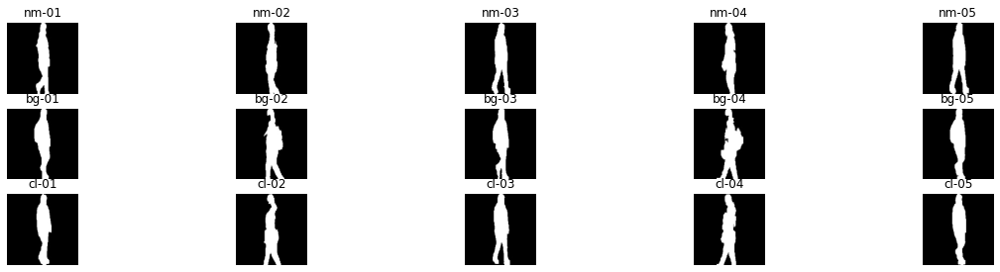

Showing subject: 011 view: 060


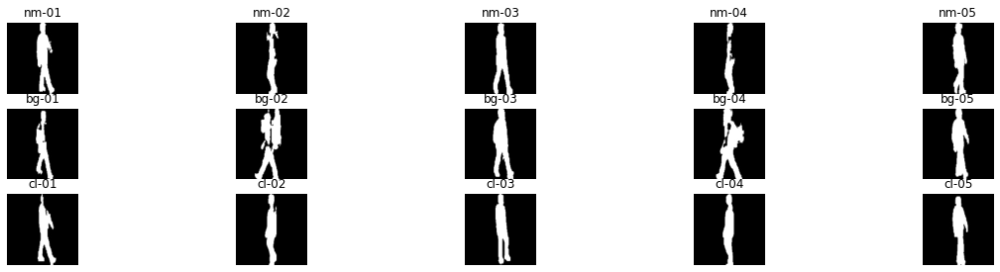

Showing subject: 012 view: 060


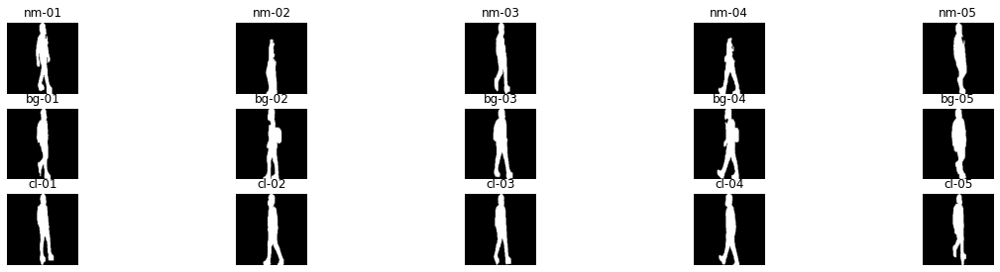

Showing subject: 013 view: 060


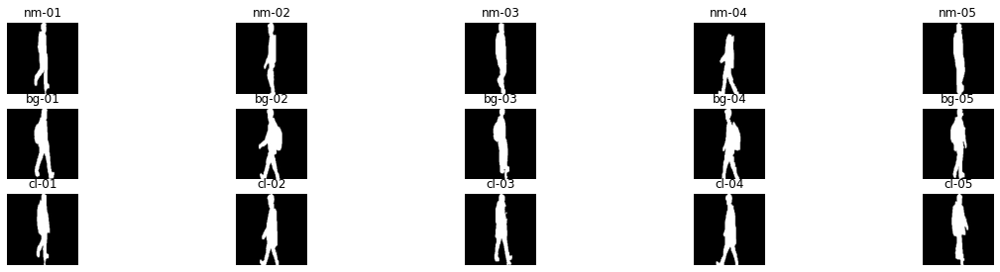

Showing subject: 014 view: 060


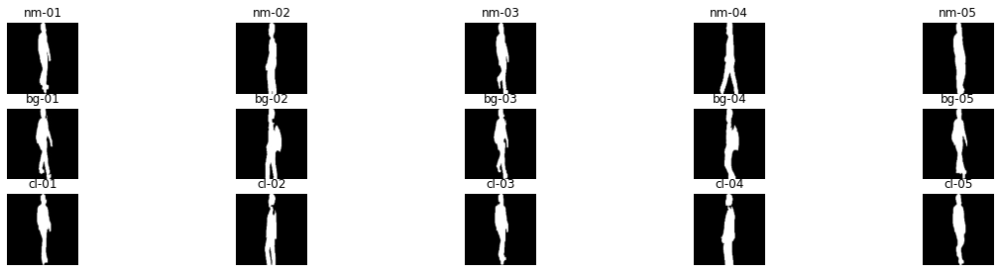

Showing subject: 015 view: 060


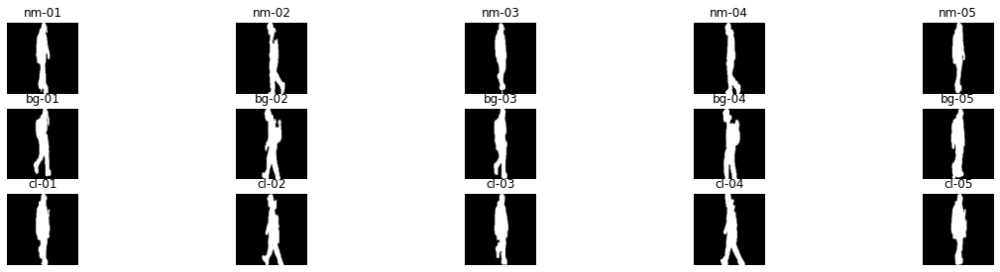

Showing subject: 016 view: 060


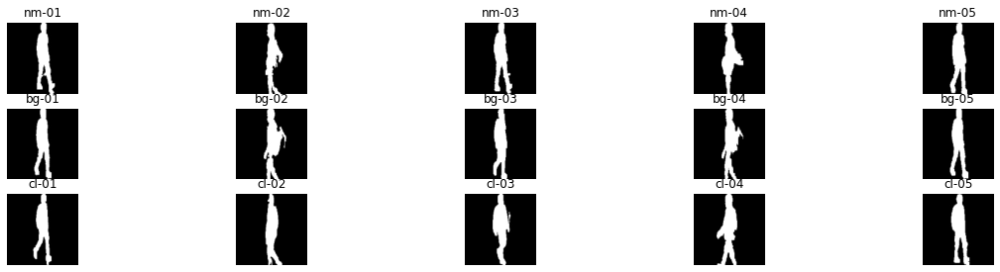

SHOWING VIEW: 075
Showing subject: 000 view: 075


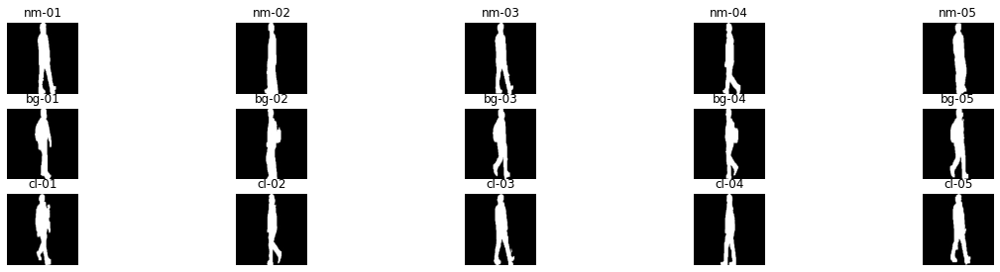

Showing subject: 001 view: 075


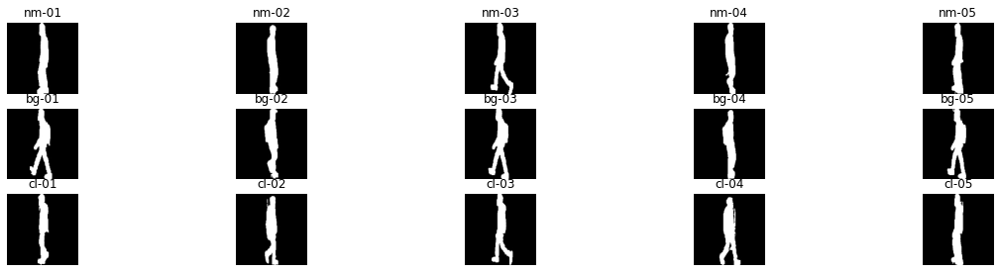

Showing subject: 002 view: 075


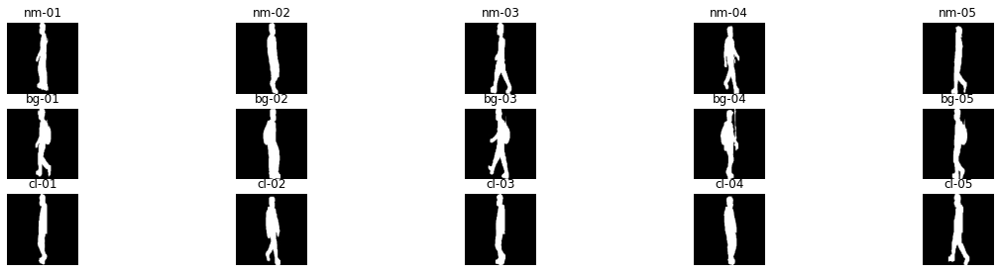

Showing subject: 003 view: 075


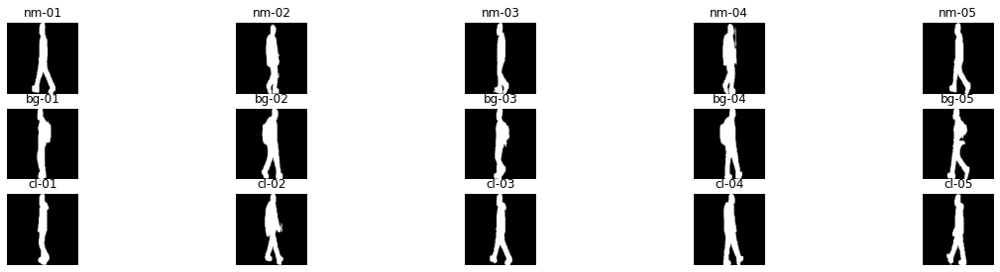

Showing subject: 004 view: 075


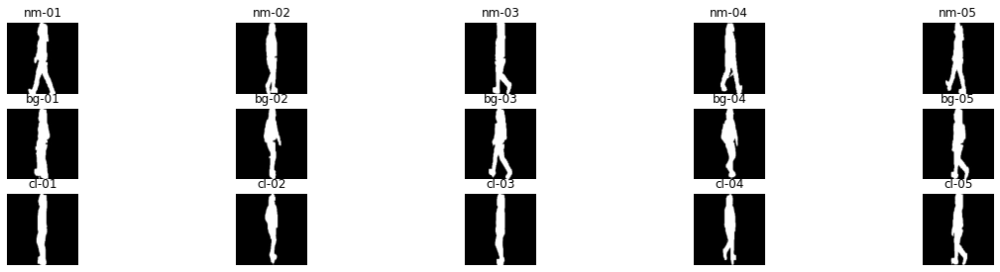

Showing subject: 005 view: 075


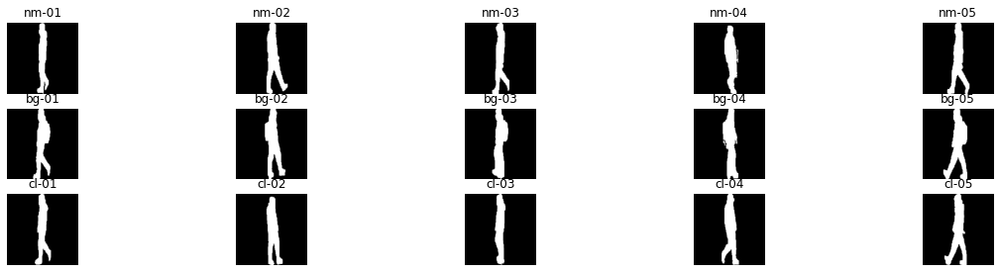

Showing subject: 006 view: 075


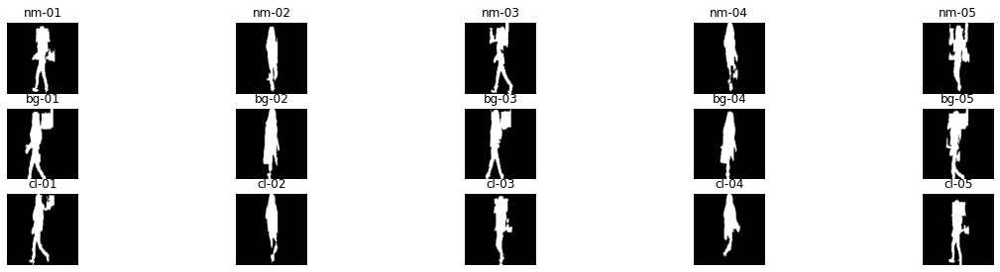

Showing subject: 007 view: 075


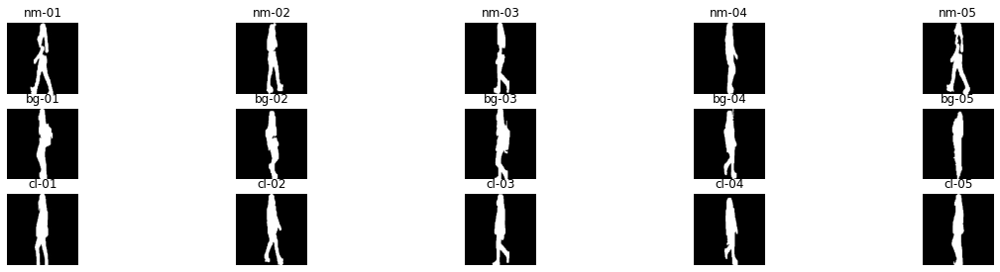

Showing subject: 008 view: 075


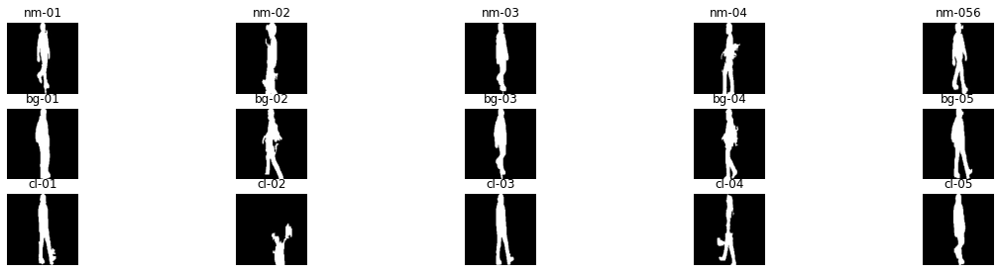

Showing subject: 009 view: 075


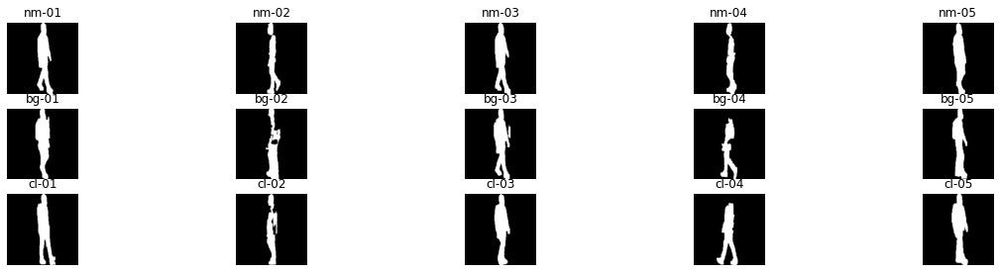

Showing subject: 010 view: 075


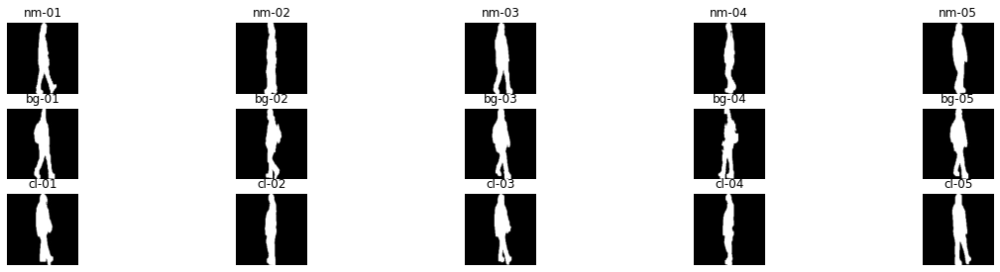

Showing subject: 011 view: 075


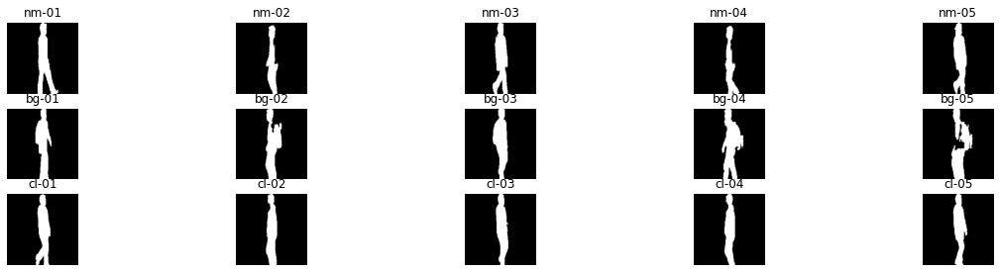

Showing subject: 012 view: 075


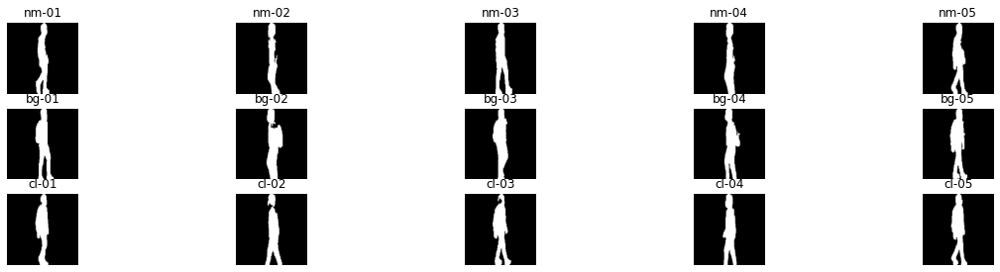

Showing subject: 013 view: 075


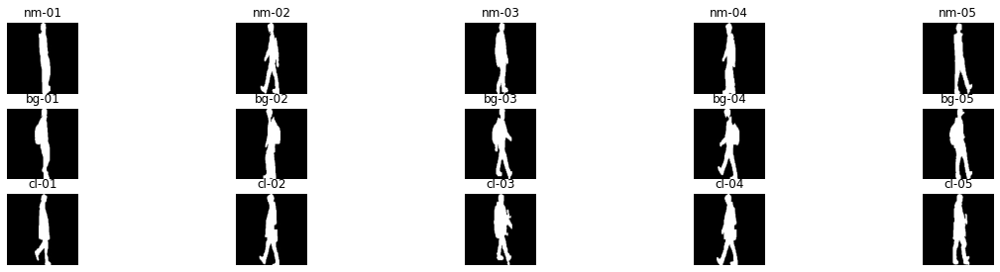

Showing subject: 014 view: 075


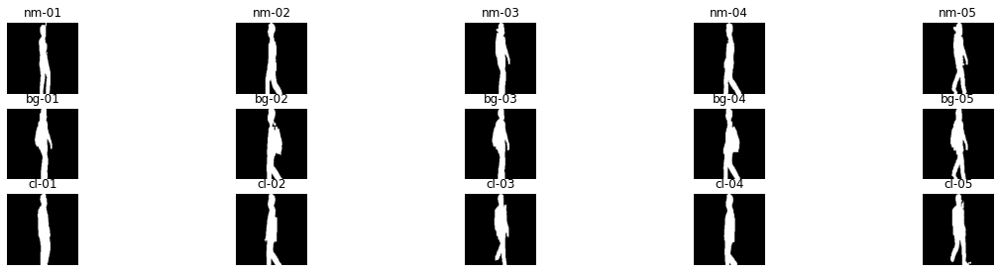

Showing subject: 015 view: 075


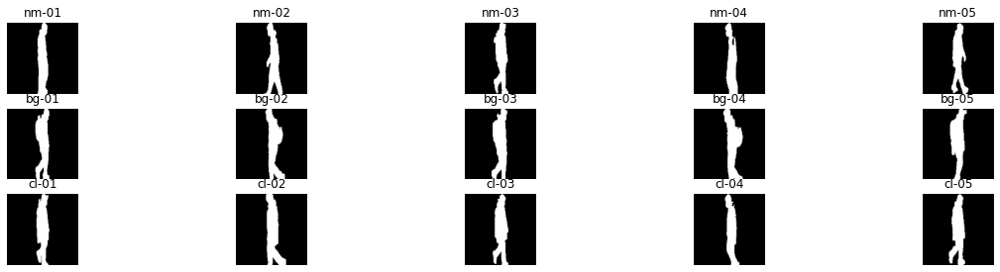

Showing subject: 016 view: 075


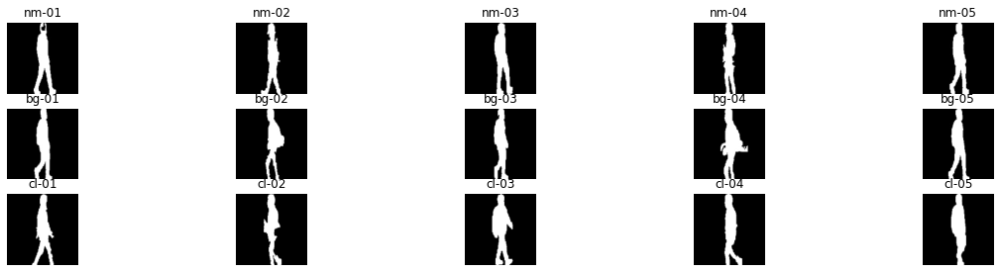

SHOWING VIEW: 090
Showing subject: 000 view: 090


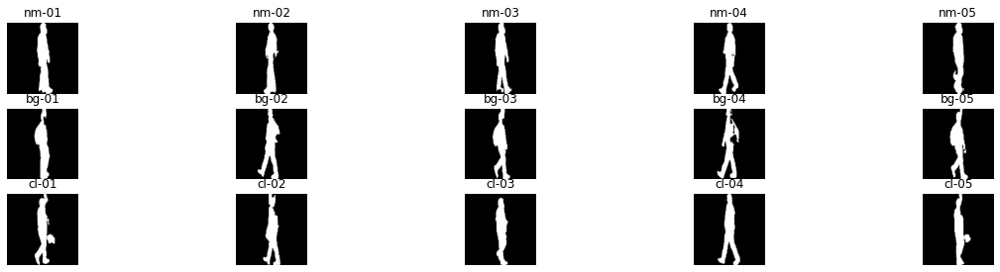

Showing subject: 001 view: 090


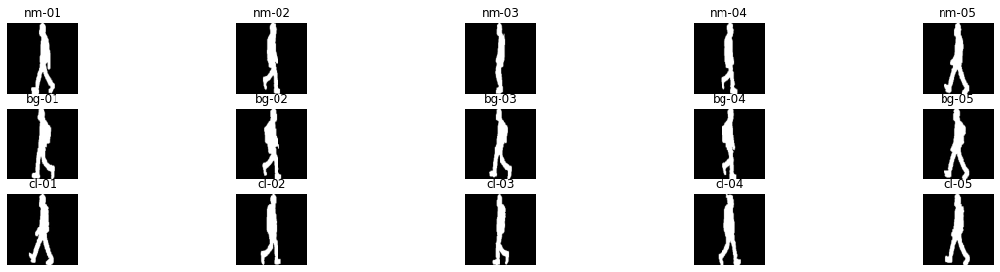

Showing subject: 002 view: 090


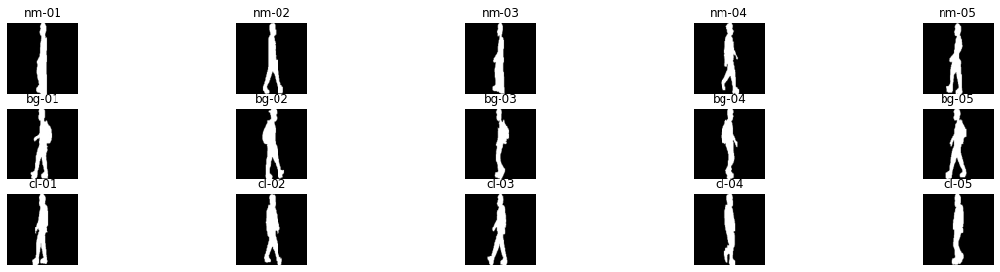

Showing subject: 003 view: 090


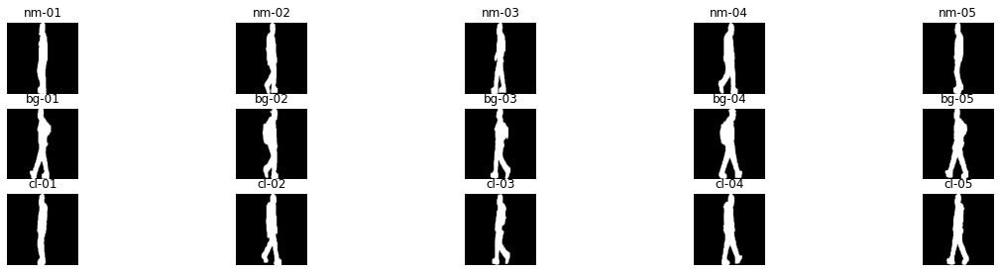

Showing subject: 004 view: 090


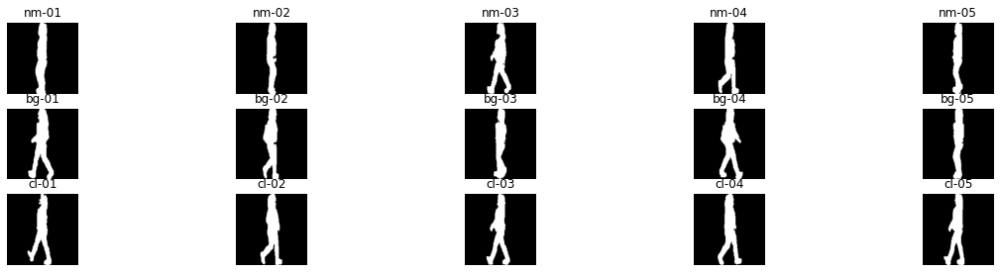

Showing subject: 005 view: 090


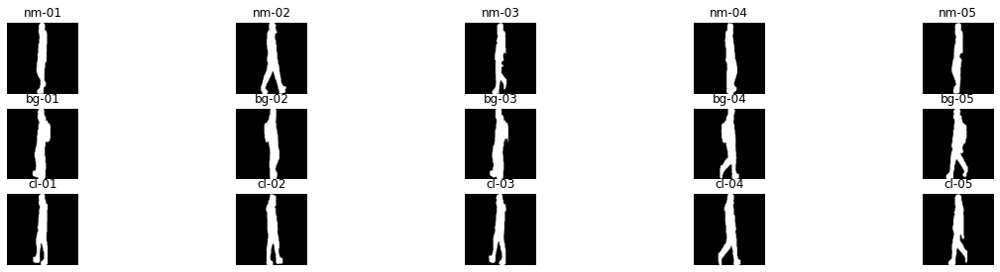

Showing subject: 006 view: 090


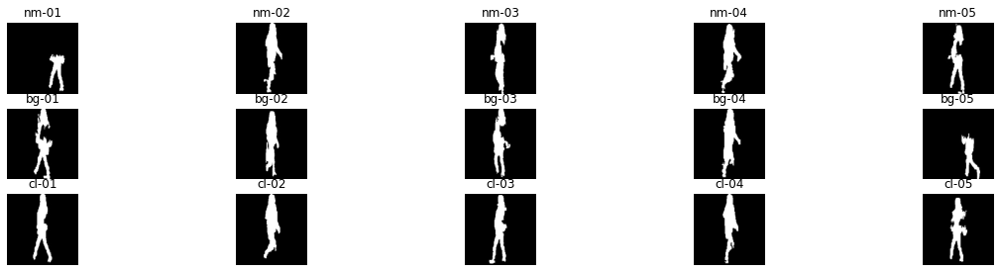

Showing subject: 007 view: 090


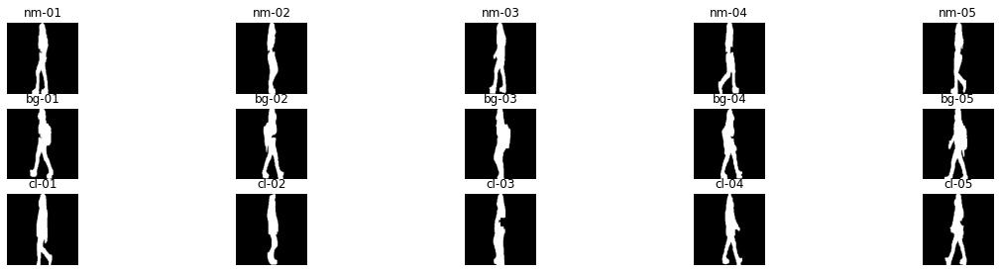

Showing subject: 008 view: 090


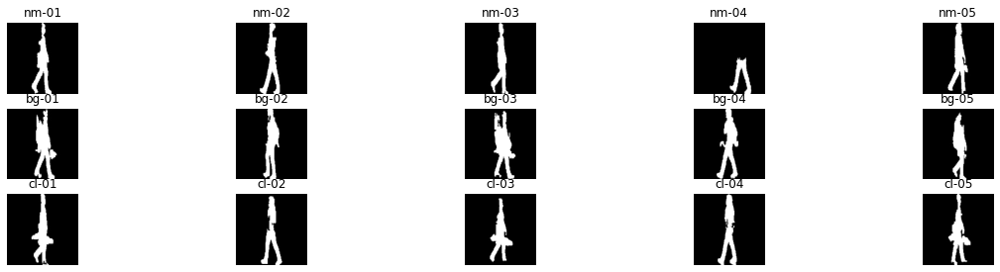

Showing subject: 009 view: 090


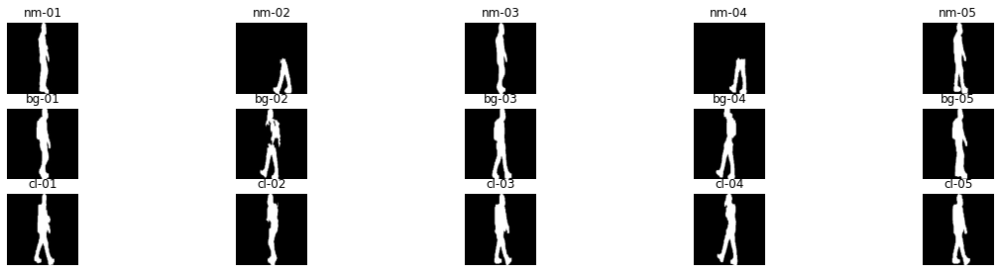

Showing subject: 010 view: 090


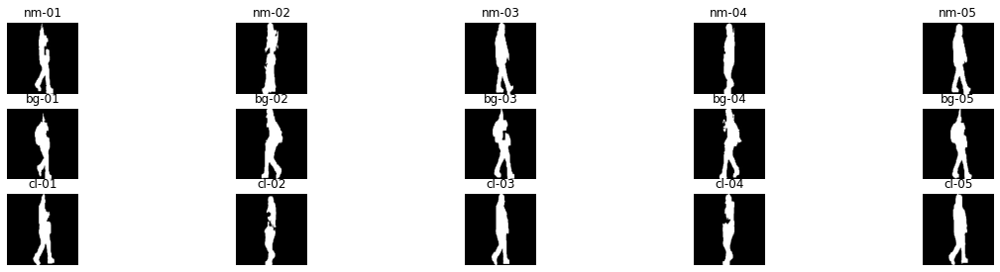

Showing subject: 011 view: 090


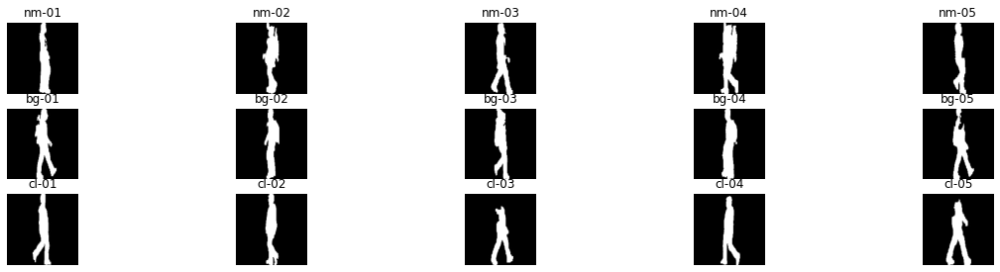

Showing subject: 012 view: 090


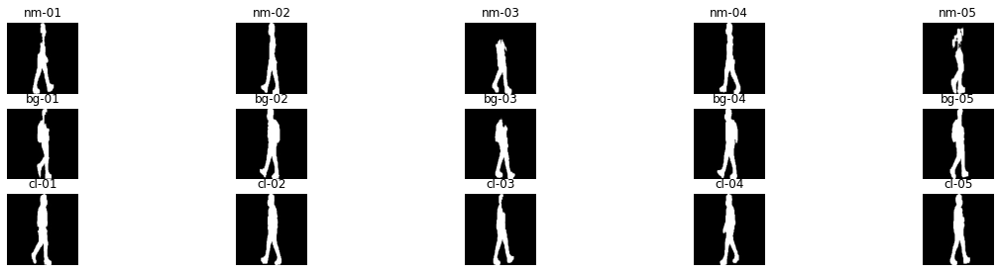

Showing subject: 013 view: 090


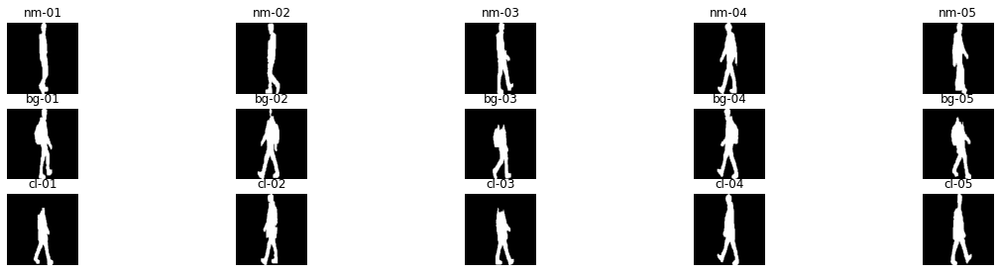

Showing subject: 014 view: 090


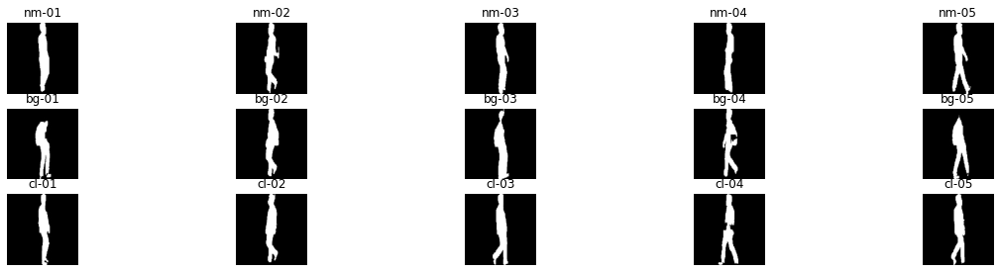

Showing subject: 015 view: 090


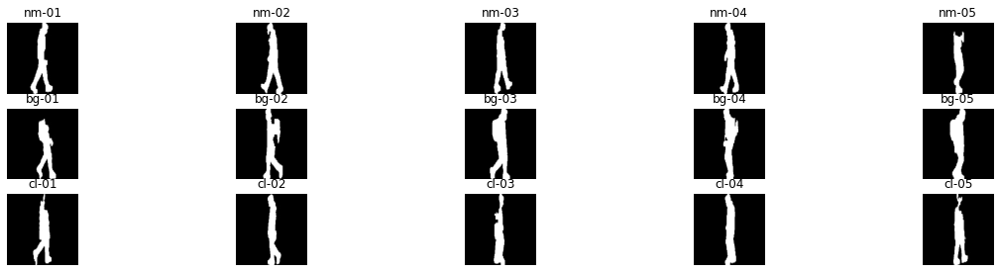

Showing subject: 016 view: 090


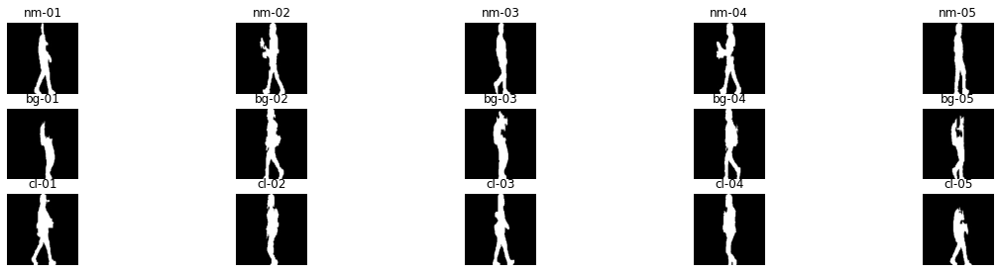

SHOWING VIEW: 105
Showing subject: 000 view: 105


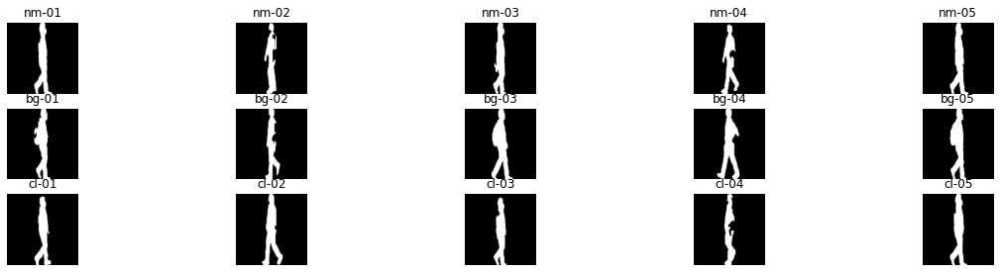

Showing subject: 001 view: 105


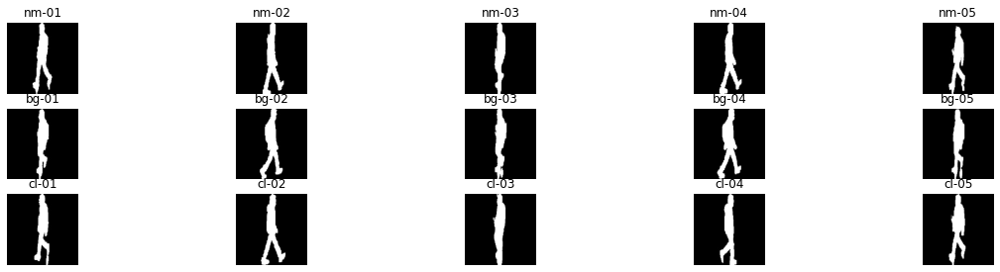

Showing subject: 002 view: 105


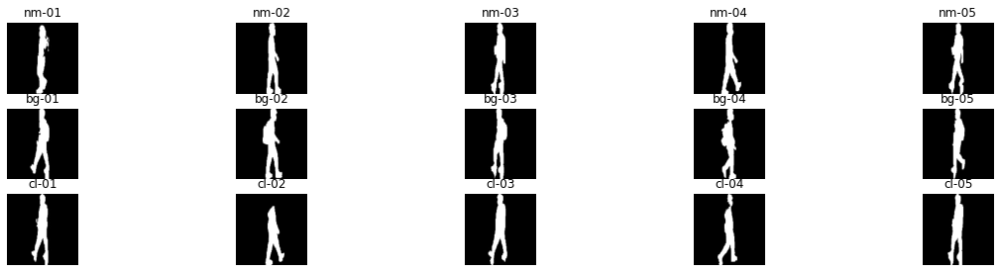

Showing subject: 003 view: 105


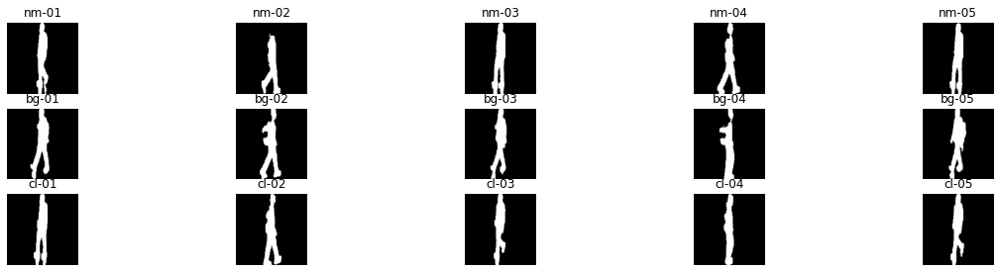

Showing subject: 004 view: 105


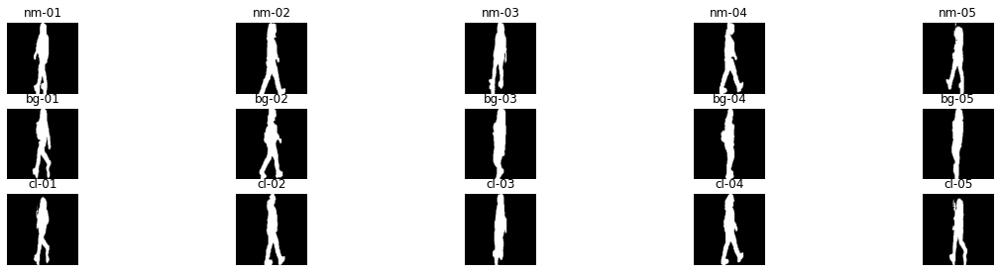

Showing subject: 005 view: 105


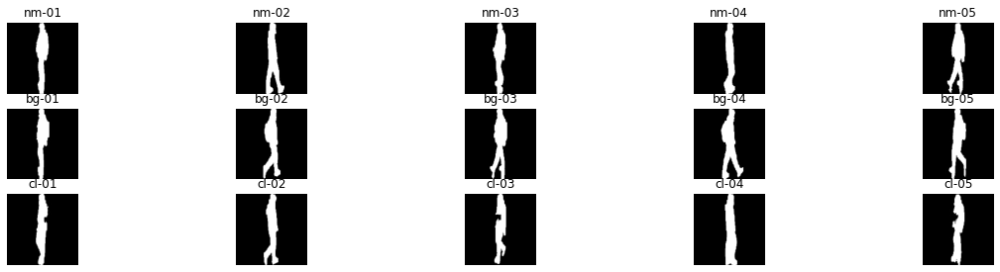

Showing subject: 006 view: 105


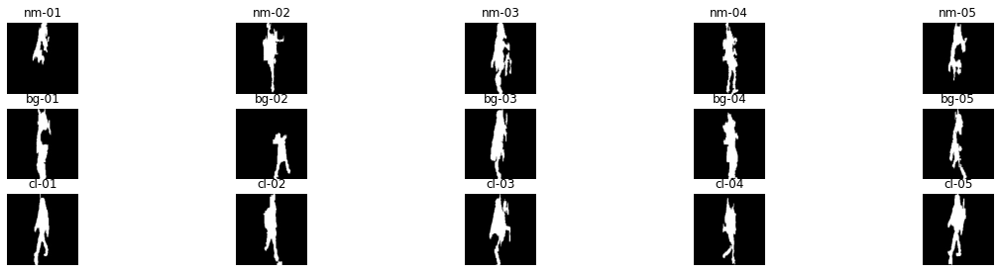

Showing subject: 007 view: 105


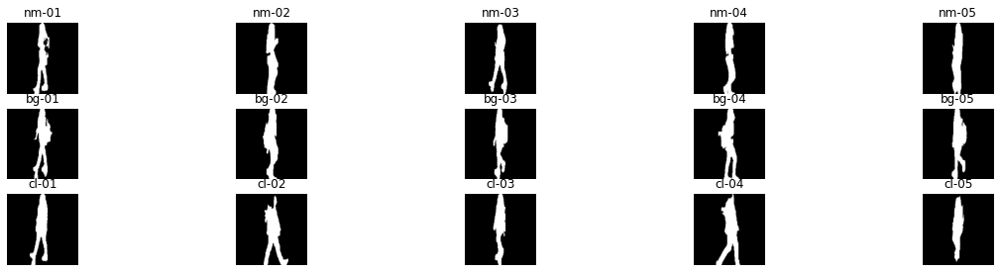

Showing subject: 008 view: 105


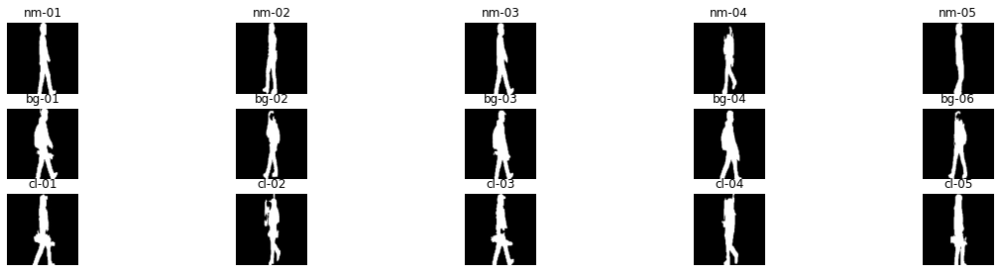

Showing subject: 009 view: 105


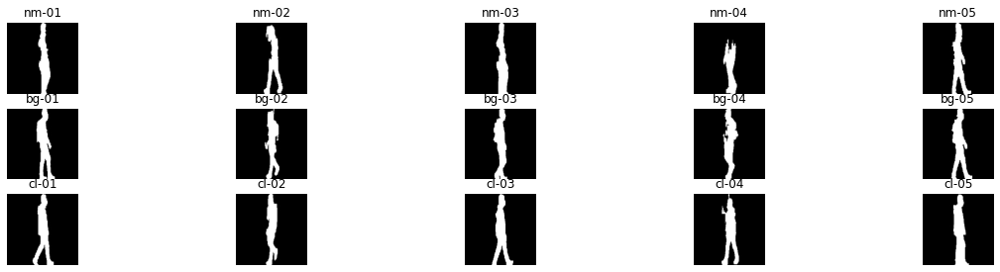

Showing subject: 010 view: 105


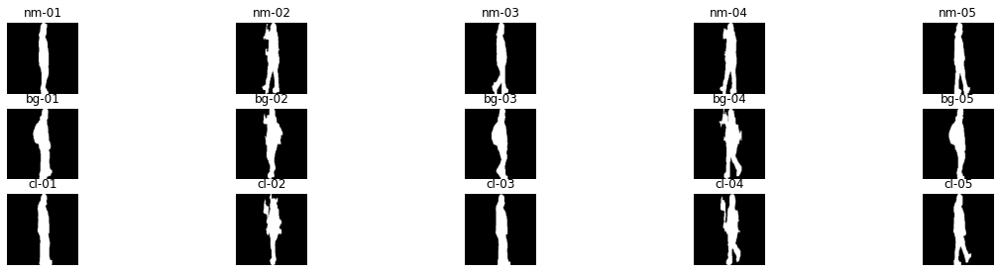

Showing subject: 011 view: 105


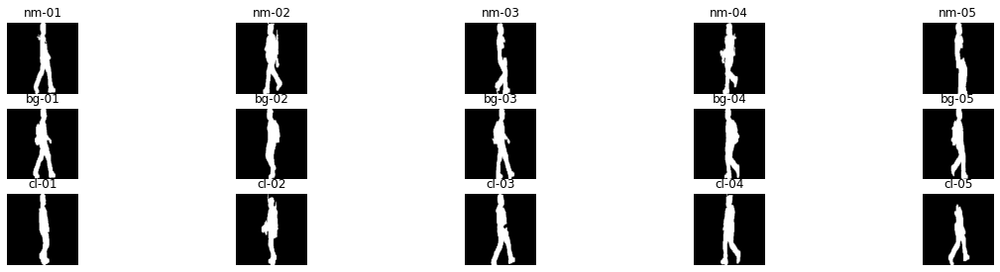

Showing subject: 012 view: 105


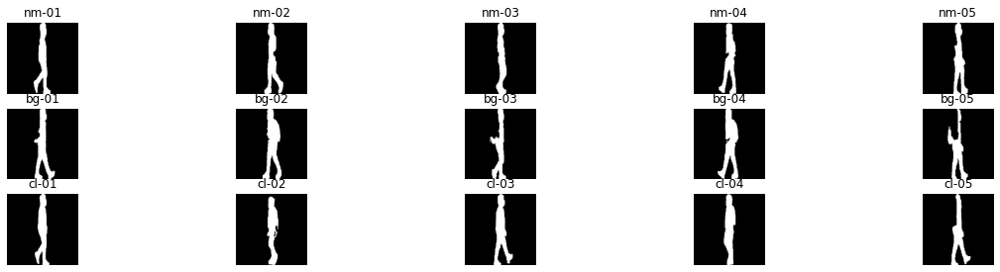

Showing subject: 013 view: 105


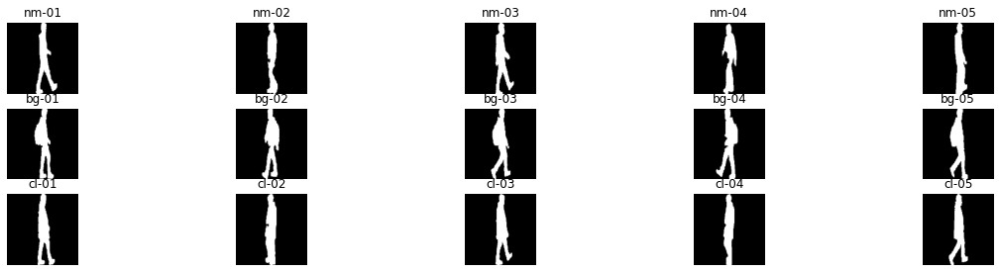

Showing subject: 014 view: 105


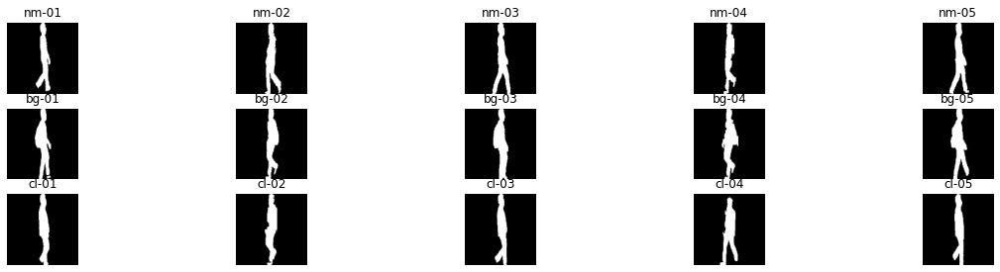

Showing subject: 015 view: 105


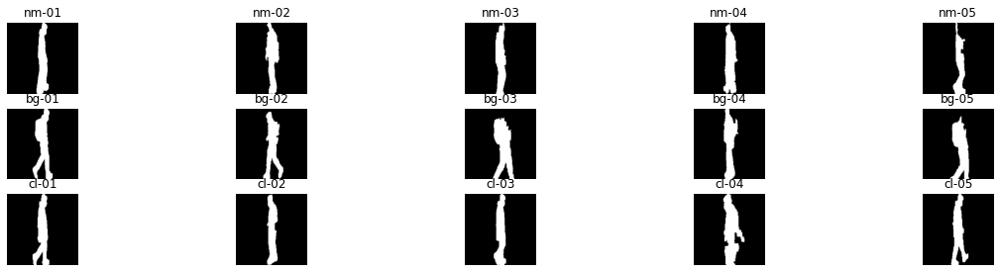

Showing subject: 016 view: 105


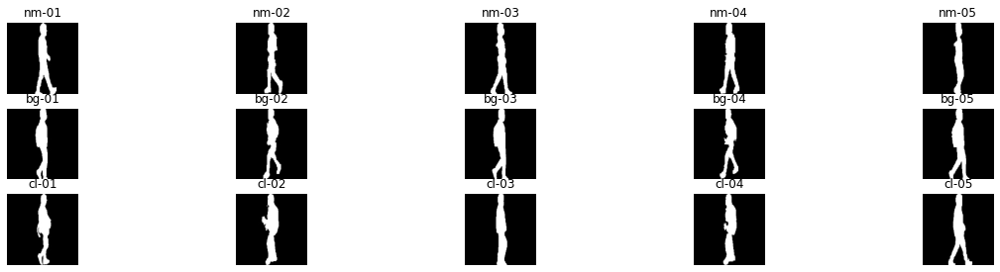

SHOWING VIEW: 120
Showing subject: 000 view: 120


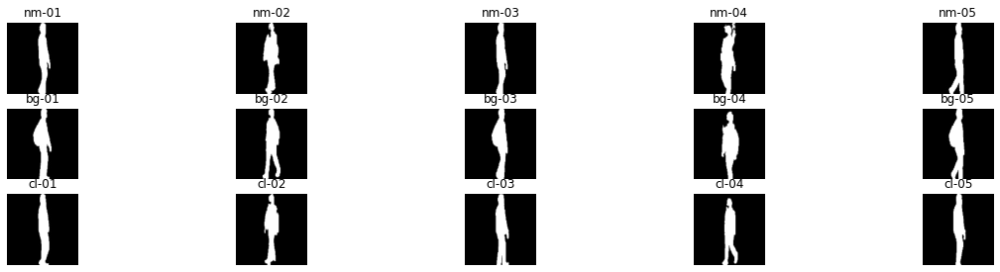

Showing subject: 001 view: 120


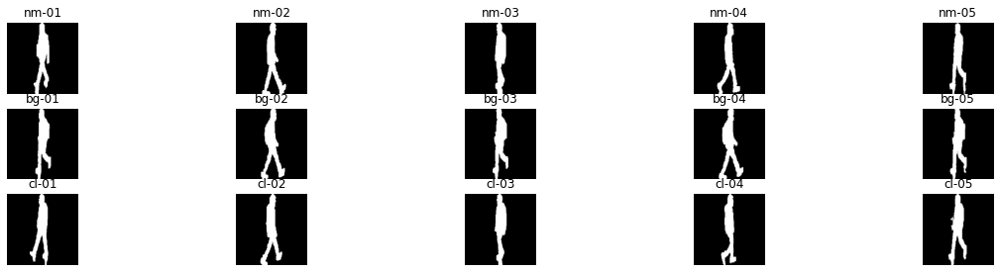

Showing subject: 002 view: 120


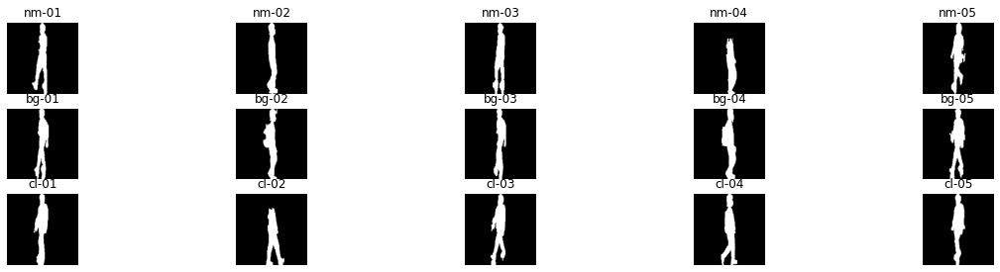

Showing subject: 003 view: 120


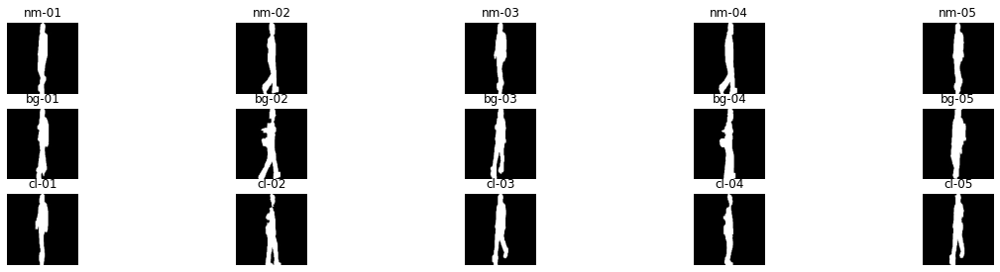

Showing subject: 004 view: 120


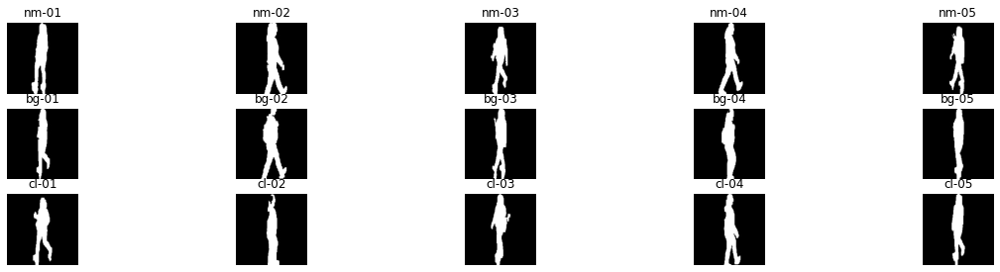

Showing subject: 005 view: 120


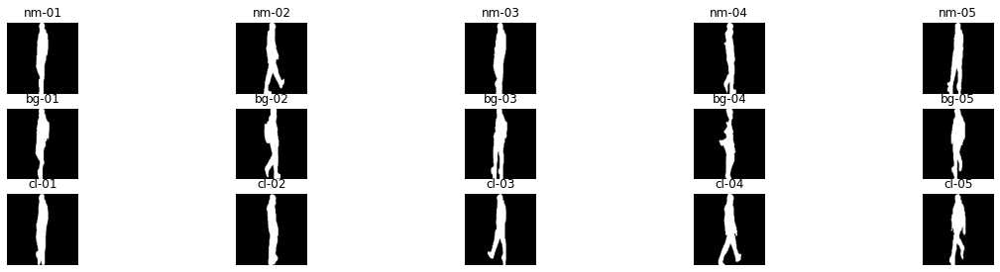

Showing subject: 006 view: 120


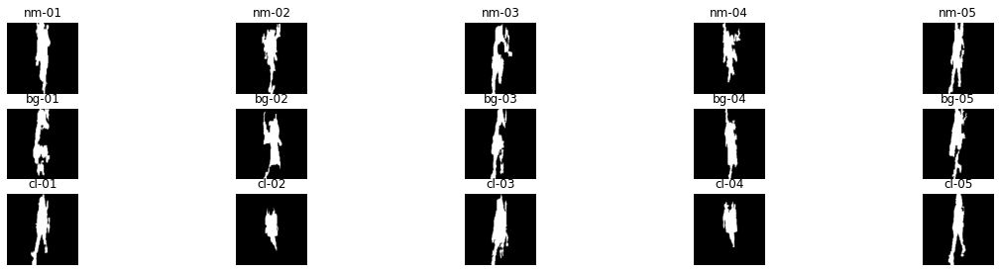

Showing subject: 007 view: 120


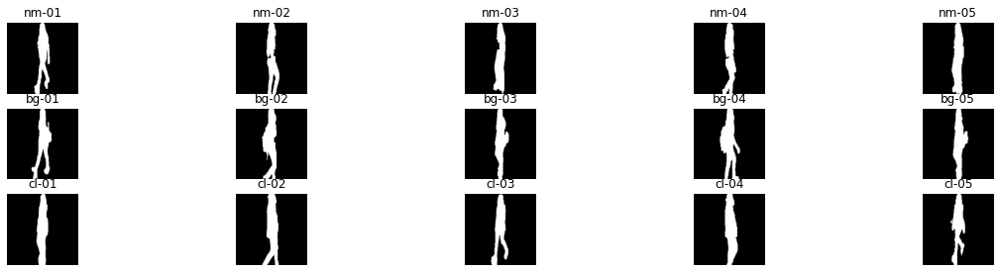

Showing subject: 008 view: 120


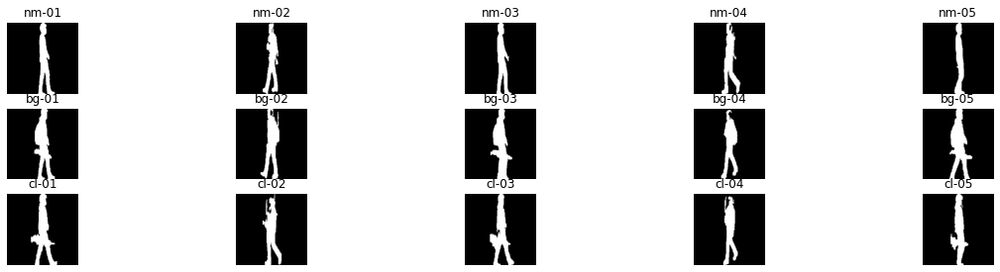

Showing subject: 009 view: 120


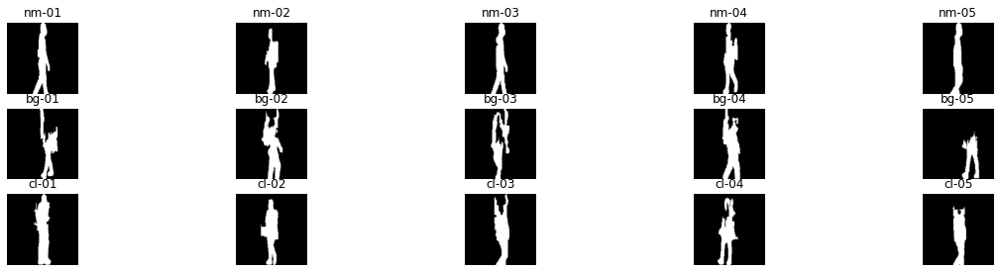

Showing subject: 010 view: 120


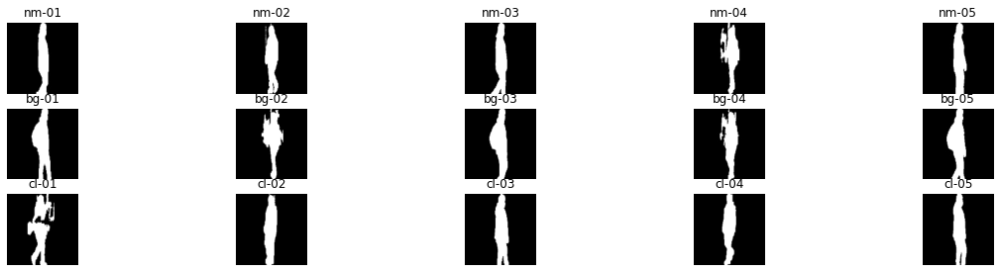

Showing subject: 011 view: 120


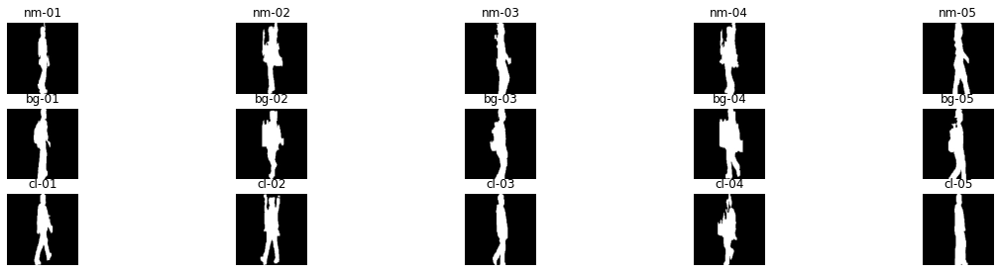

Showing subject: 012 view: 120


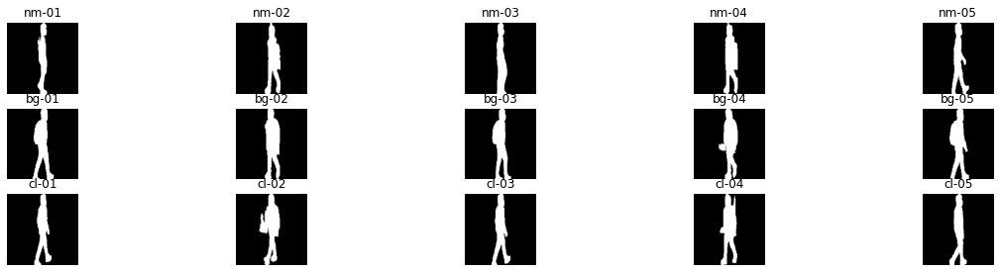

Showing subject: 013 view: 120


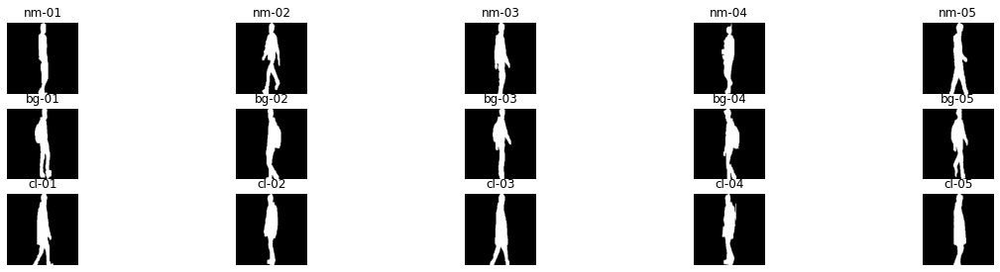

Showing subject: 014 view: 120


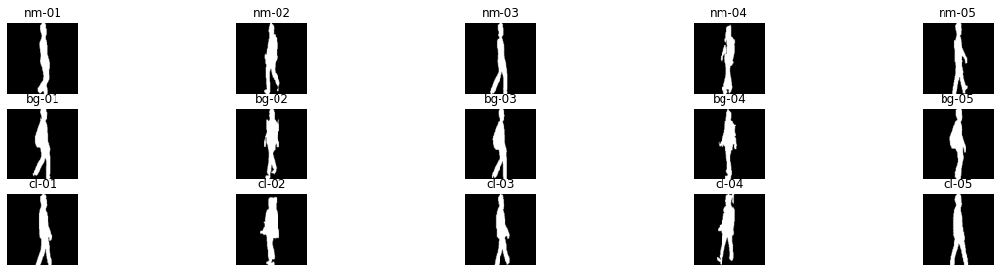

Showing subject: 015 view: 120


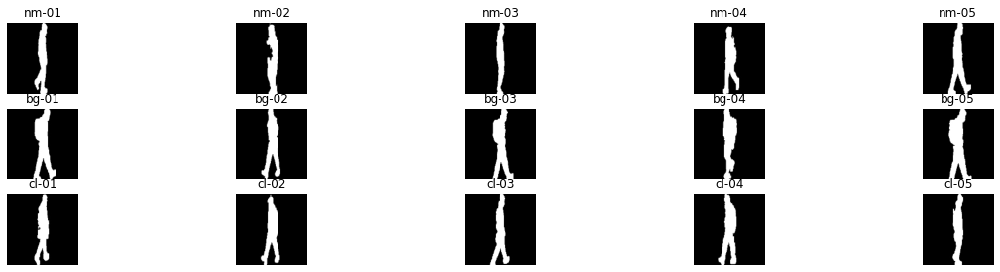

Showing subject: 016 view: 120


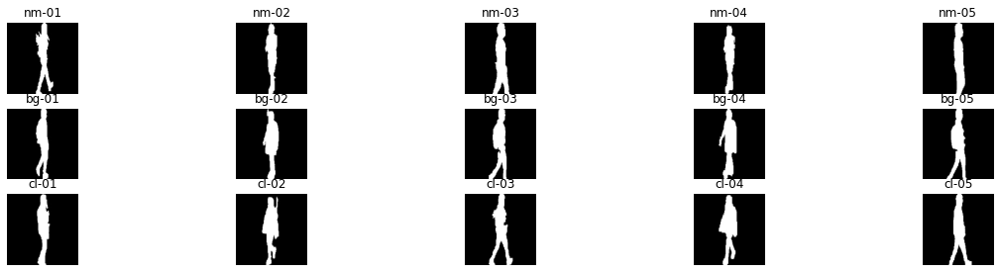

In [32]:
for view in views:
    sils_dir = os.path.join(silhouettes_dir, view)
    print(f'SHOWING VIEW: {view}')
    subjects = sorted(os.listdir(rois_dir))
    
    for subject in subjects:
        print(f'Showing subject: {subject} view: {view}')
        plt.figure(figsize=(20, 4.5))
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            nplot = j*5 + 1
            rseqs_dir = os.path.join(sils_dir, subject, walk)
            seqs = sorted(os.listdir(rseqs_dir))
            for i, seq in enumerate(seqs):
                try:
                    roi = cv2.imread(os.path.join(rseqs_dir, seq, f'{subject}-{seq}-{str(15)}.jpg'), 0)        

                    plt.subplot(3, 5, nplot); plt.imshow(roi, cmap="gray"); plt.title(seq); plt.axis('off')

                    
                except:
                    print(f'Error opening')
                nplot+=1
        plt.show()

## Gait representation: GEI generation

In [22]:
silhouettes_dir = '/home/christian/Documents/Datasets/OakGait16/segmented_silhouettes/'
representations_dir = '/home/christian/Documents/Datasets/OakGait16/representations/'
views = ['060','075','090','105','120']

In [23]:
for view in views:
    sils_dir = os.path.join(silhouettes_dir, view)
    rep_dir = os.path.join(representations_dir, view)
    print(f'GENERATING GAIT REPRESENTATIONS FROM VIEW: {view}')
    subjects = sorted(os.listdir(sils_dir))
    for subject in subjects:
        print(f'Processing subject: {subject} view: {view}')
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            
            sub_GEI_dir = os.path.join(rep_dir, subject, walk)
            create_dir(sub_GEI_dir, force=True)
            seq_dir = os.path.join(sils_dir, subject, walk)
            seqs = sorted(os.listdir(seq_dir))


            for s, seq in enumerate(seqs):
                
                seq_frames_dir = os.path.join(seq_dir, seq)
                lfiles = sorted(os.listdir(seq_frames_dir))
                silhouettes = []
                for idimg, path in enumerate(lfiles):
                    nplot = idimg + 1
                    img_path = str(os.path.join(seq_frames_dir, path))
                    img = cv2.imread(img_path)
                    silhouettes.append(img)
                    
                GEI = np.mean(np.array(silhouettes), axis=0).astype("uint8")
                GEI_name = os.path.join(sub_GEI_dir, f'{str(s+1).zfill(2)}.png')
                cv2.imwrite(GEI_name, GEI)

GENERATING GAIT REPRESENTATIONS FROM VIEW: 060
Processing subject: 000 view: 060
Processing subject: 001 view: 060
Processing subject: 002 view: 060
Processing subject: 003 view: 060
Processing subject: 004 view: 060
Processing subject: 005 view: 060
Processing subject: 006 view: 060
Processing subject: 007 view: 060
Processing subject: 008 view: 060
Processing subject: 009 view: 060
Processing subject: 010 view: 060
Processing subject: 011 view: 060
Processing subject: 012 view: 060
Processing subject: 013 view: 060
Processing subject: 014 view: 060
Processing subject: 015 view: 060
Processing subject: 016 view: 060
GENERATING GAIT REPRESENTATIONS FROM VIEW: 075
Processing subject: 000 view: 075
Processing subject: 001 view: 075
Processing subject: 002 view: 075
Processing subject: 003 view: 075
Processing subject: 004 view: 075
Processing subject: 005 view: 075
Processing subject: 006 view: 075
Processing subject: 007 view: 075
Processing subject: 008 view: 075
Processing subject: 00

SHOWING VIEW: 060
Showing subject: 000 view: 060


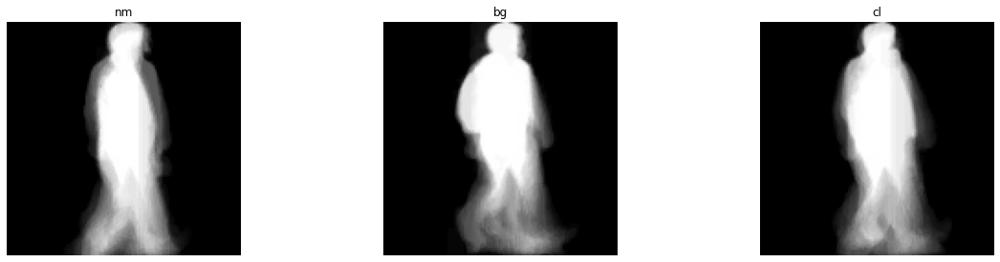

Showing subject: 001 view: 060


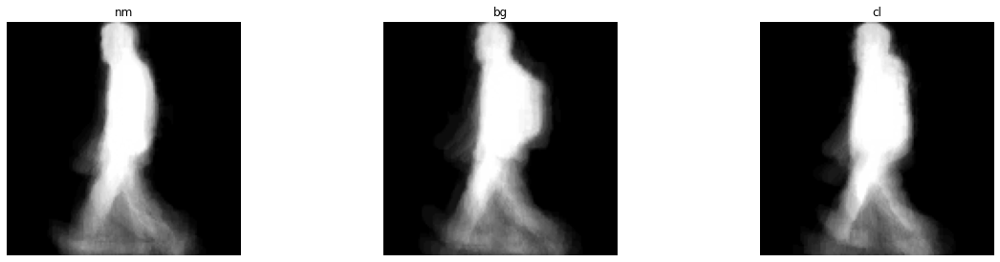

Showing subject: 002 view: 060


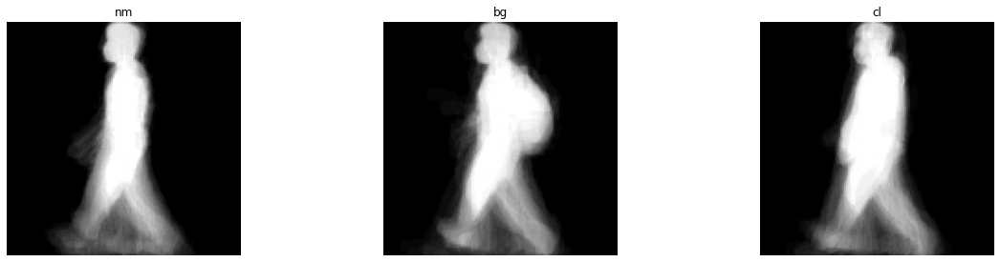

Showing subject: 003 view: 060


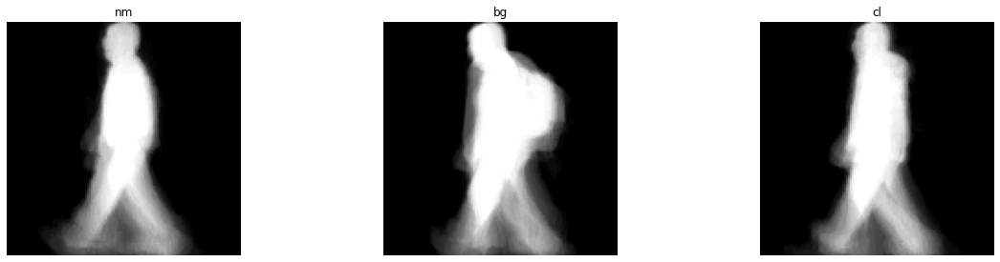

Showing subject: 004 view: 060


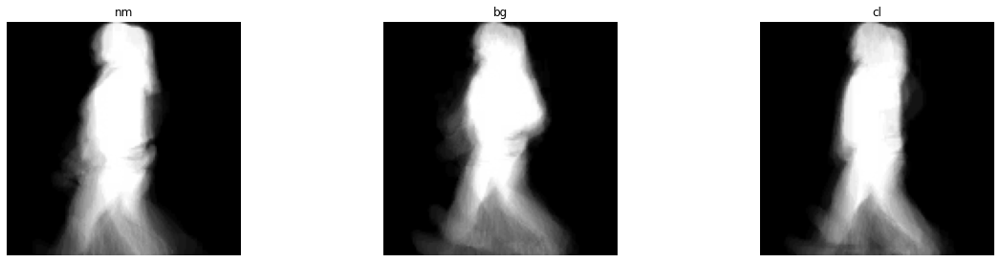

Showing subject: 005 view: 060
Error opening


[ WARN:0@12153.931] global /io/opencv/modules/imgcodecs/src/loadsave.cpp (239) findDecoder imread_('/home/christian/Documents/Datasets/OakGait16/representations/060/005/cl/01-1.png'): can't open/read file: check file path/integrity


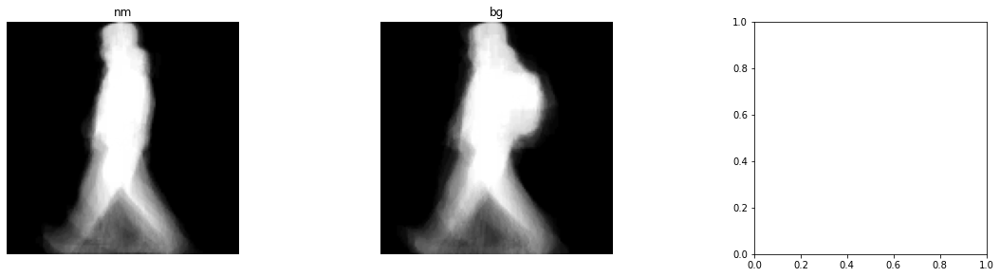

Showing subject: 006 view: 060


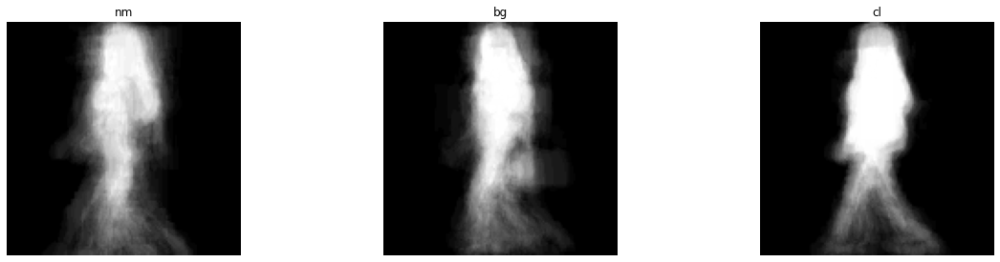

Showing subject: 007 view: 060


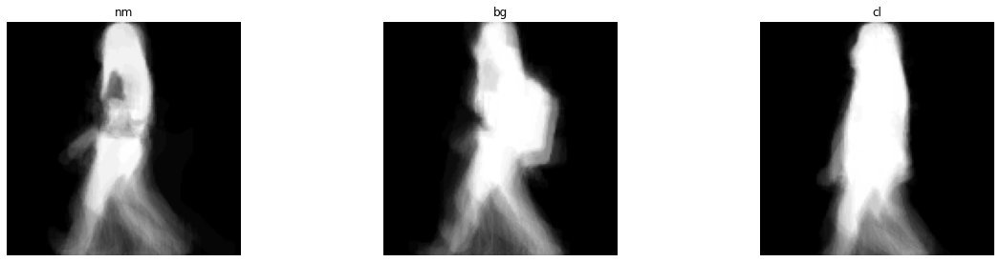

Showing subject: 008 view: 060


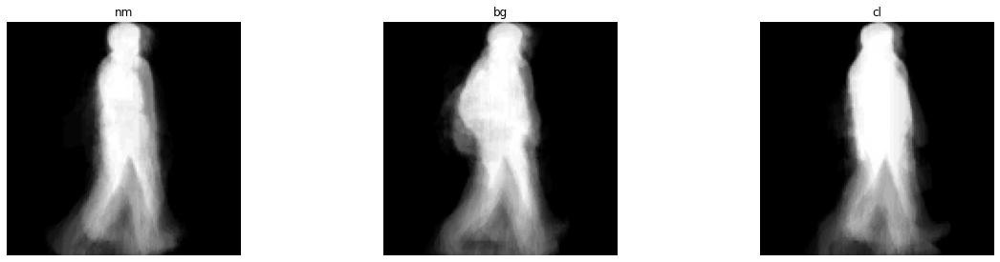

Showing subject: 009 view: 060


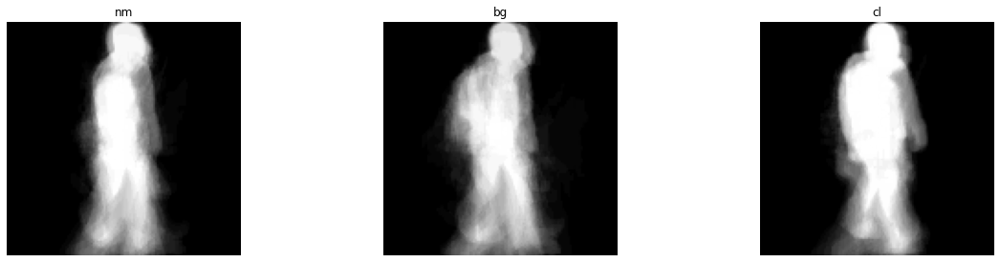

Showing subject: 010 view: 060


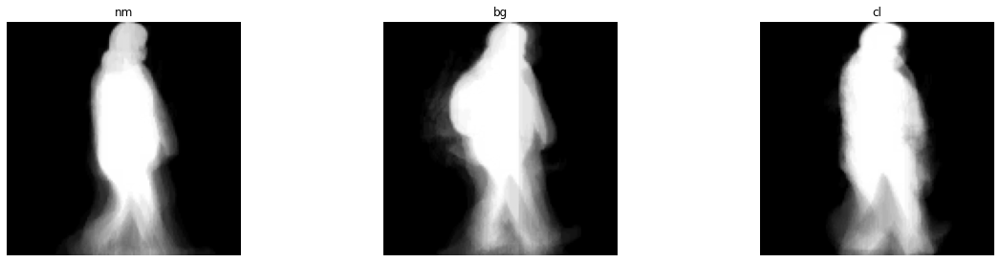

Showing subject: 011 view: 060


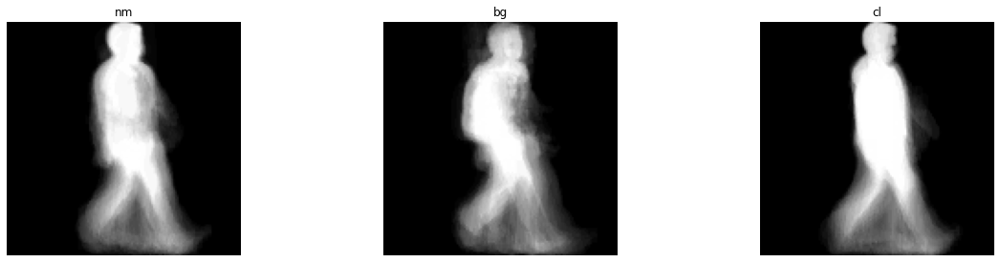

Showing subject: 012 view: 060


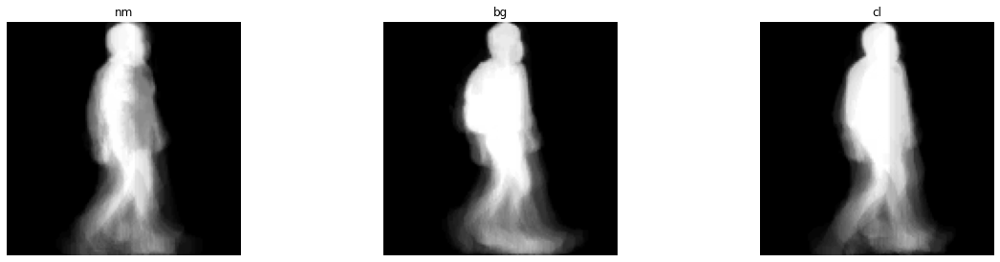

Showing subject: 013 view: 060


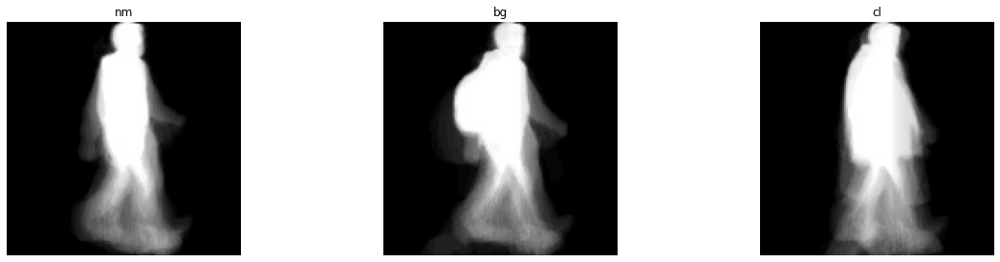

Showing subject: 014 view: 060


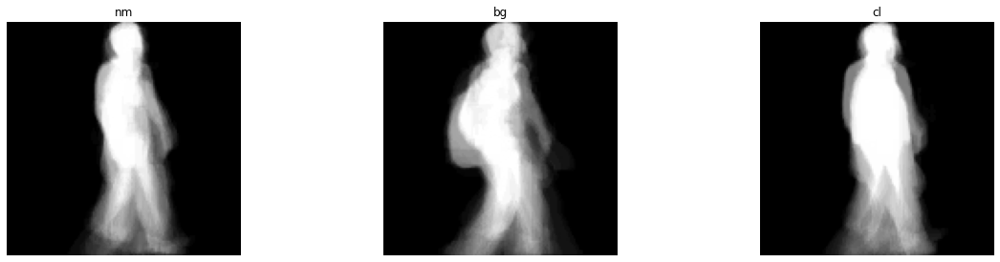

Showing subject: 015 view: 060


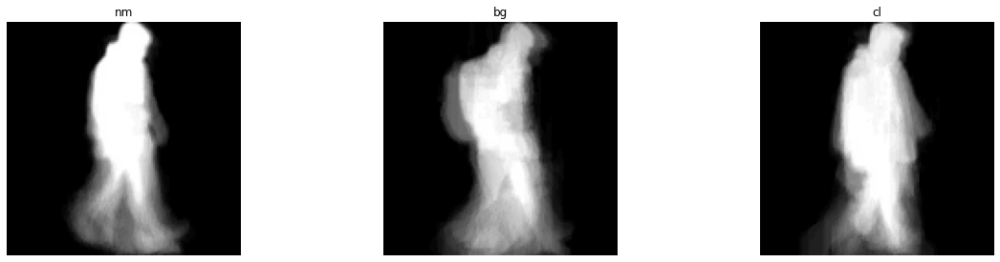

Showing subject: 016 view: 060


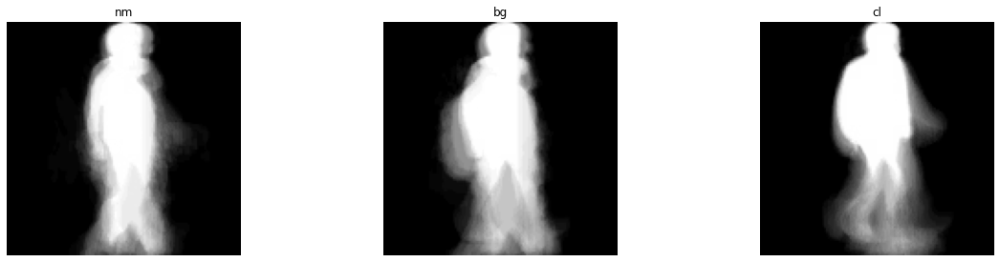

SHOWING VIEW: 075
Showing subject: 000 view: 075


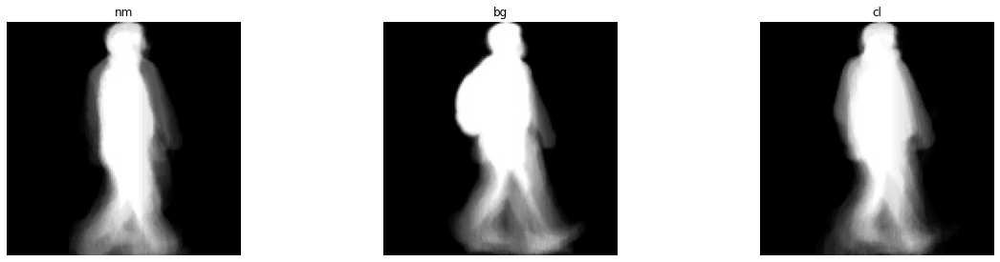

Showing subject: 001 view: 075


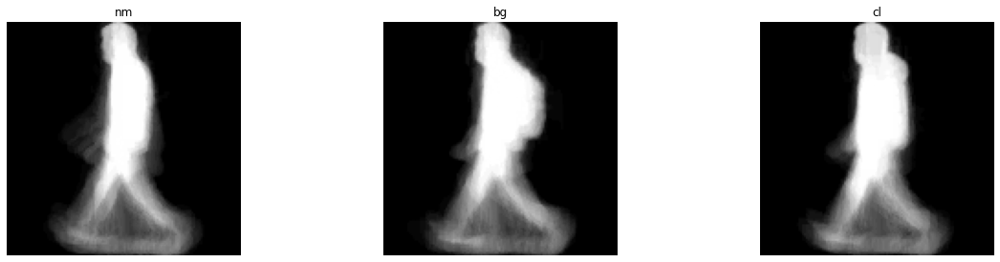

Showing subject: 002 view: 075


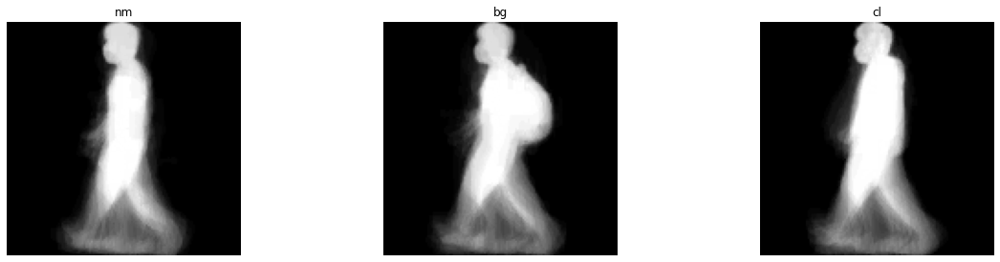

Showing subject: 003 view: 075


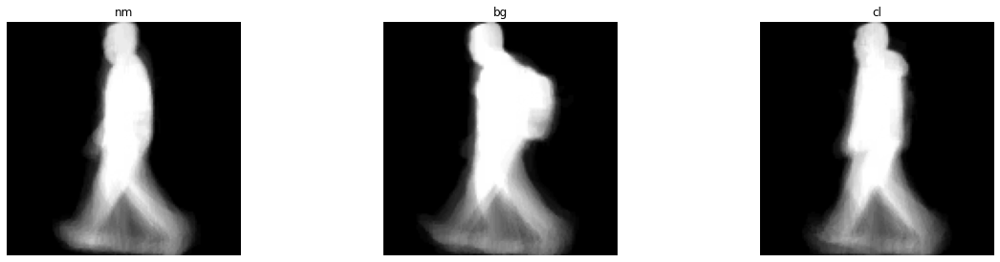

Showing subject: 004 view: 075


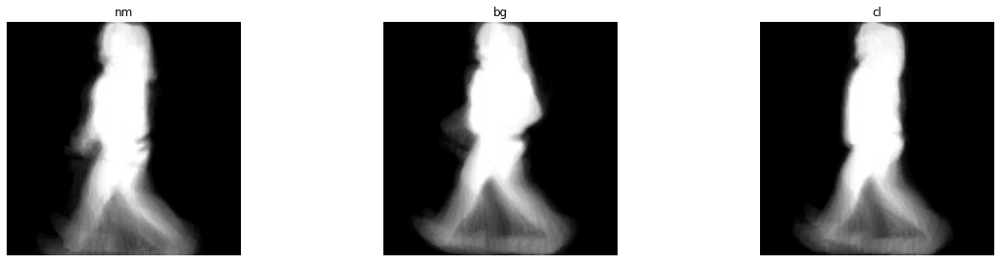

Showing subject: 005 view: 075


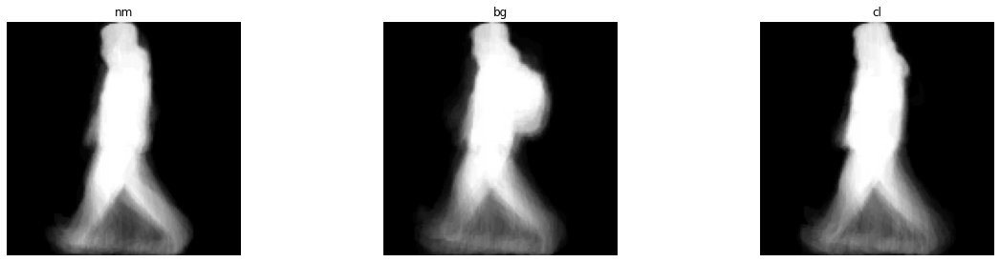

Showing subject: 006 view: 075


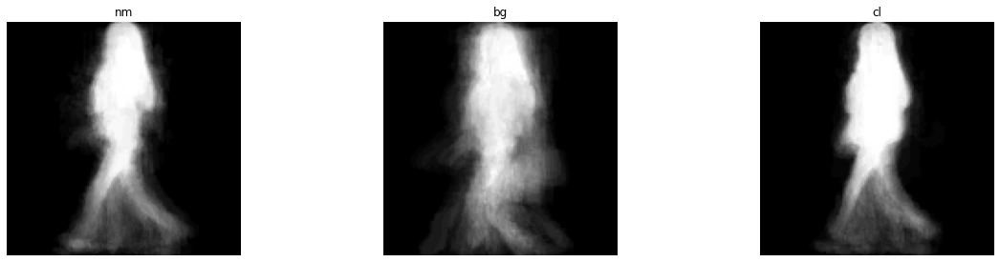

Showing subject: 007 view: 075


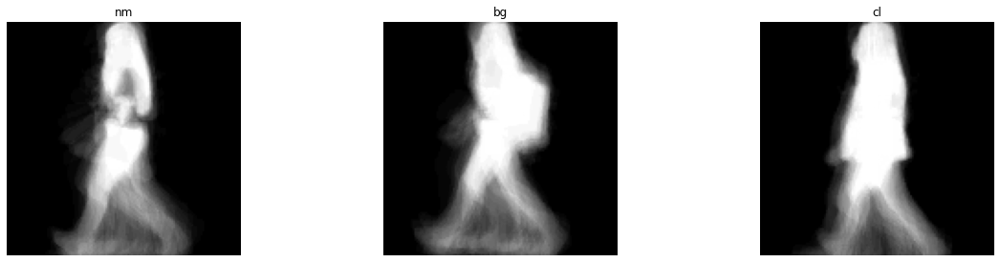

Showing subject: 008 view: 075


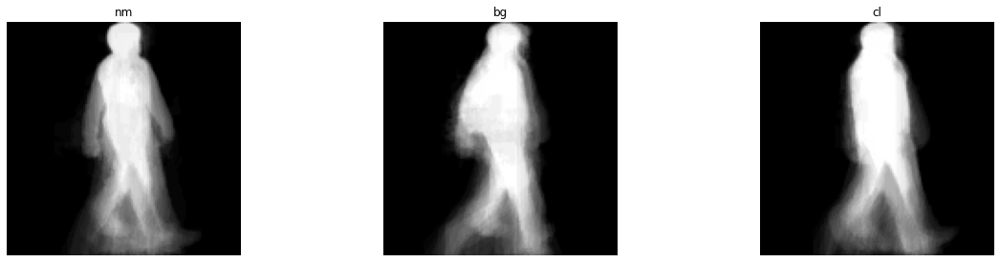

Showing subject: 009 view: 075


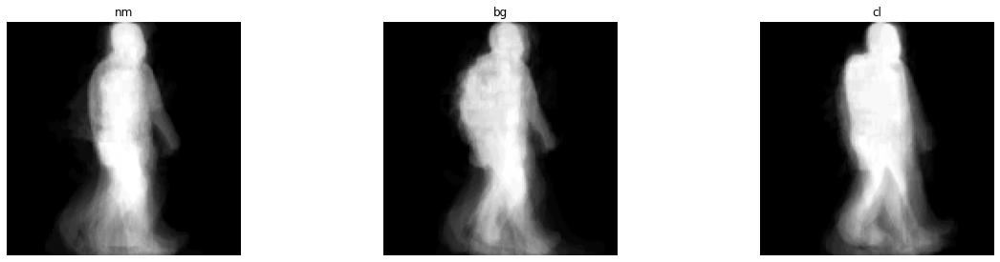

Showing subject: 010 view: 075


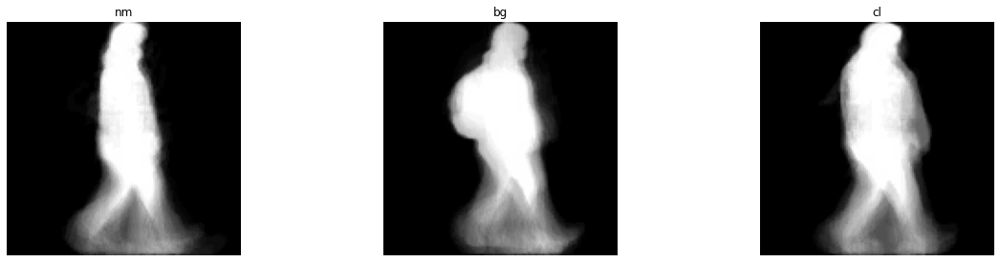

Showing subject: 011 view: 075


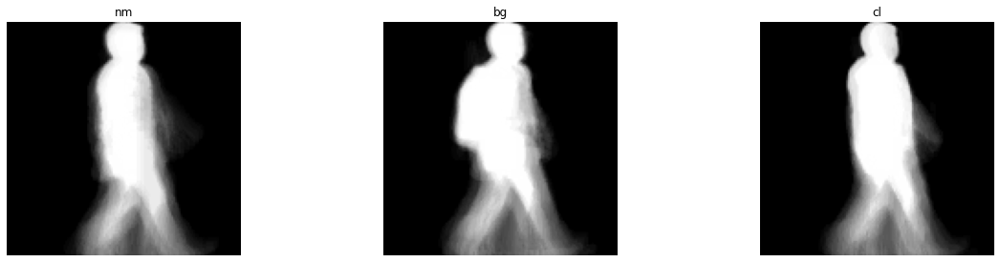

Showing subject: 012 view: 075


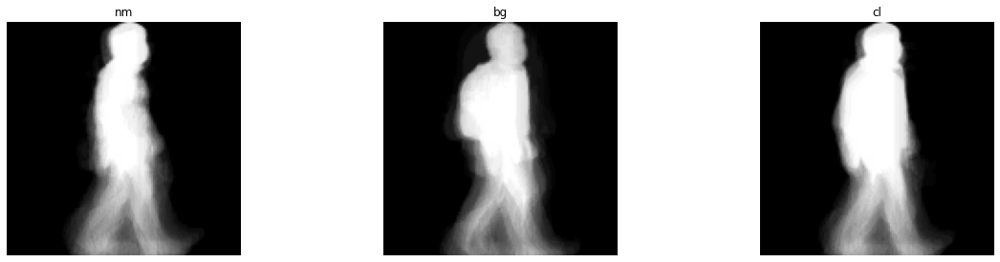

Showing subject: 013 view: 075


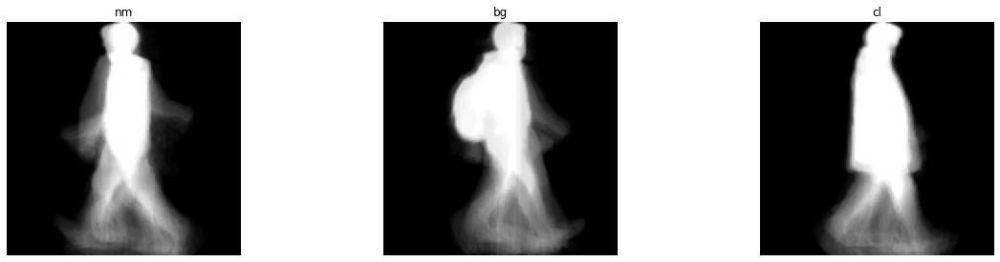

Showing subject: 014 view: 075


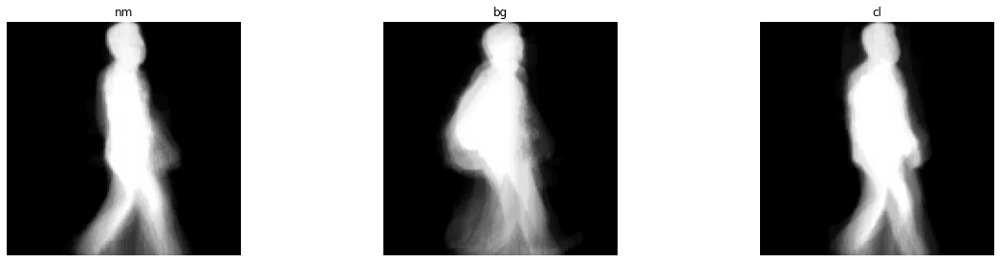

Showing subject: 015 view: 075


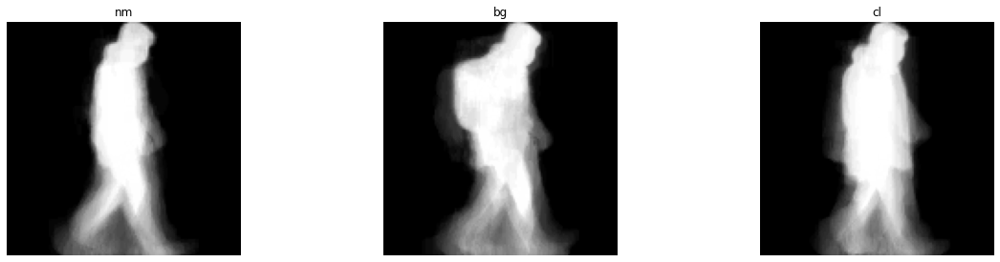

Showing subject: 016 view: 075
Error opening


[ WARN:0@12163.066] global /io/opencv/modules/imgcodecs/src/loadsave.cpp (239) findDecoder imread_('/home/christian/Documents/Datasets/OakGait16/representations/075/016/cl/01-1.png'): can't open/read file: check file path/integrity


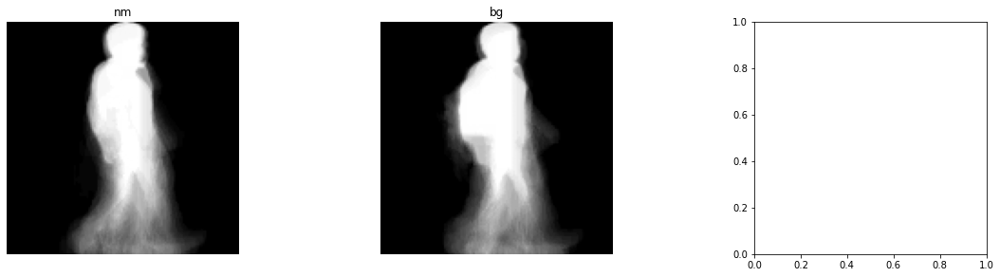

SHOWING VIEW: 090
Showing subject: 000 view: 090


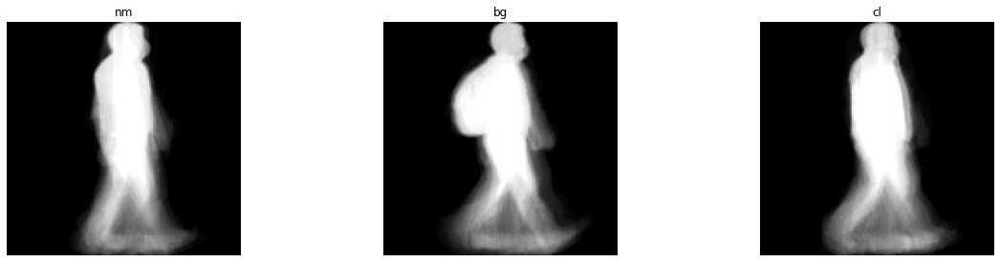

Showing subject: 001 view: 090


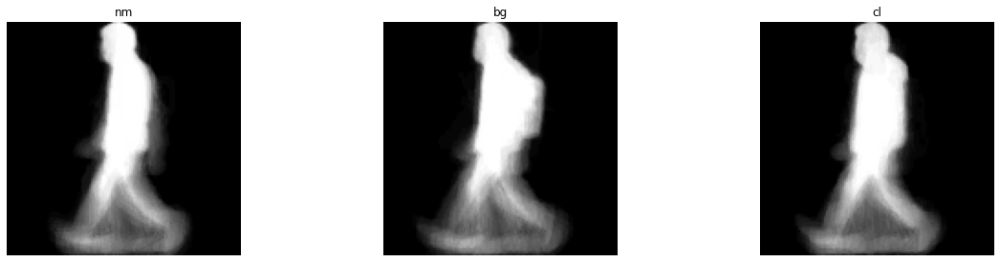

Showing subject: 002 view: 090


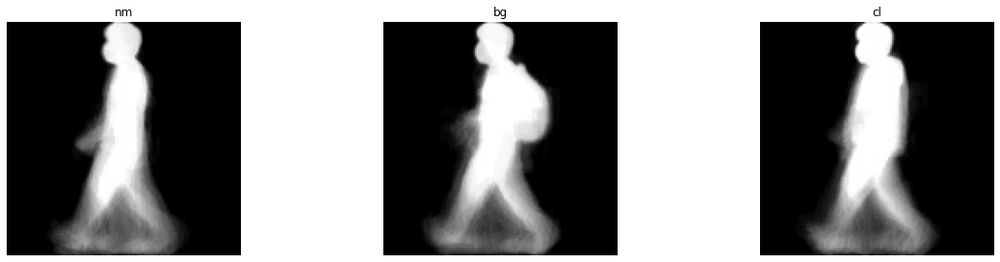

Showing subject: 003 view: 090


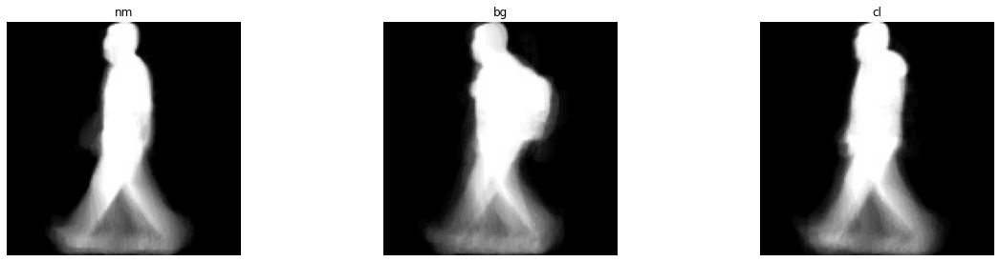

Showing subject: 004 view: 090


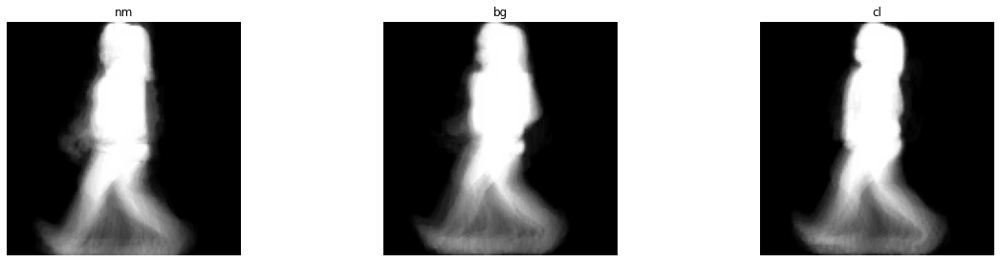

Showing subject: 005 view: 090


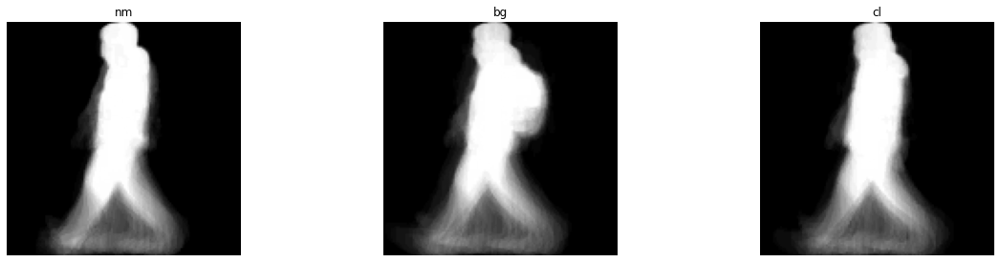

Showing subject: 006 view: 090


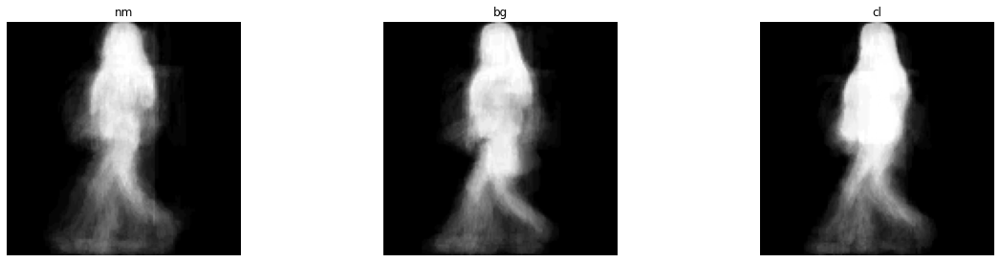

Showing subject: 007 view: 090


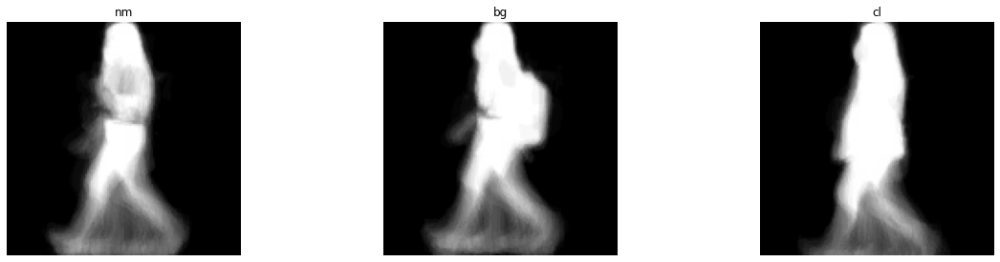

Showing subject: 008 view: 090


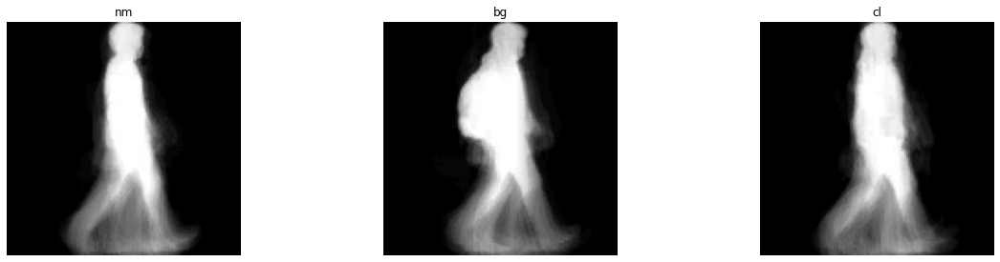

Showing subject: 009 view: 090


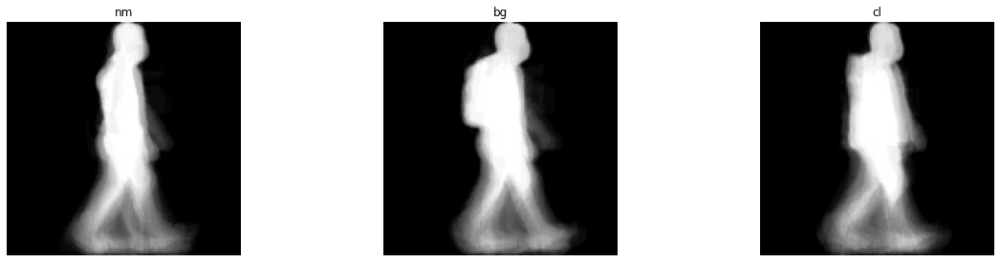

Showing subject: 010 view: 090


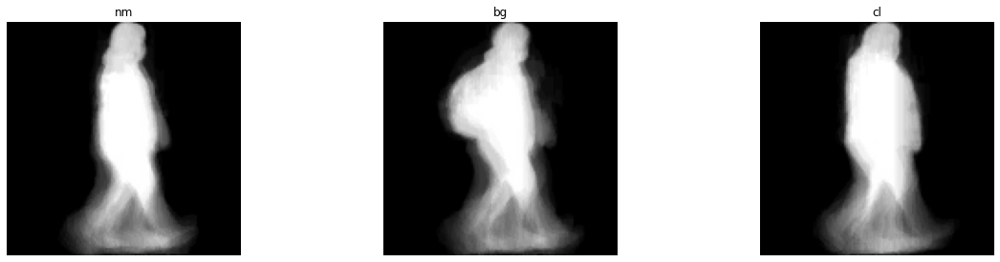

Showing subject: 011 view: 090


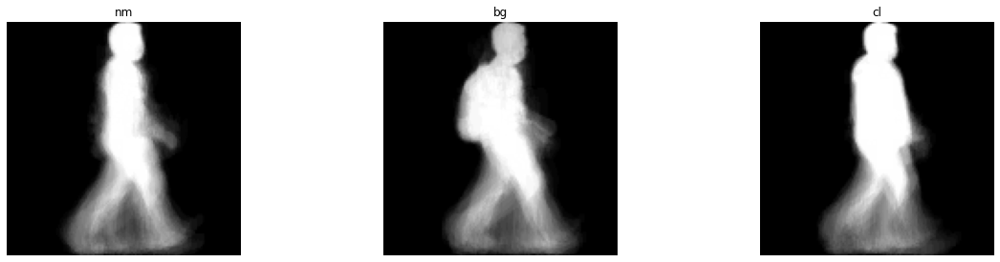

Showing subject: 012 view: 090
Error opening


[ WARN:0@12167.431] global /io/opencv/modules/imgcodecs/src/loadsave.cpp (239) findDecoder imread_('/home/christian/Documents/Datasets/OakGait16/representations/090/012/cl/01-1.png'): can't open/read file: check file path/integrity


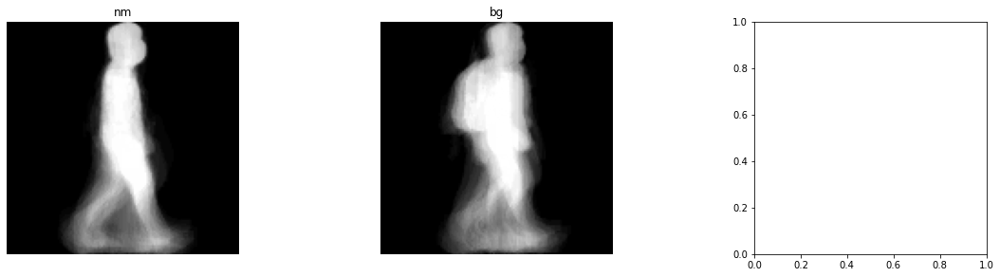

Showing subject: 013 view: 090


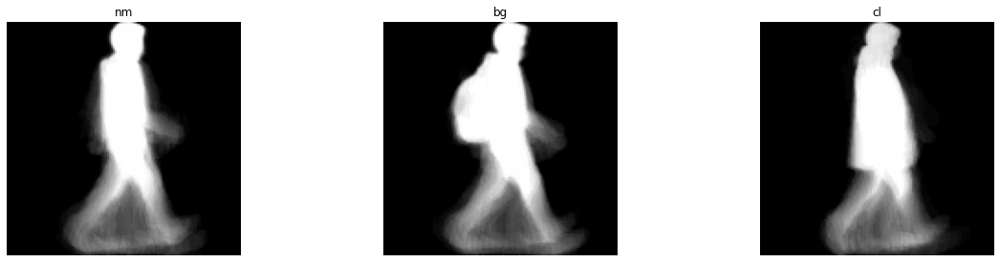

Showing subject: 014 view: 090


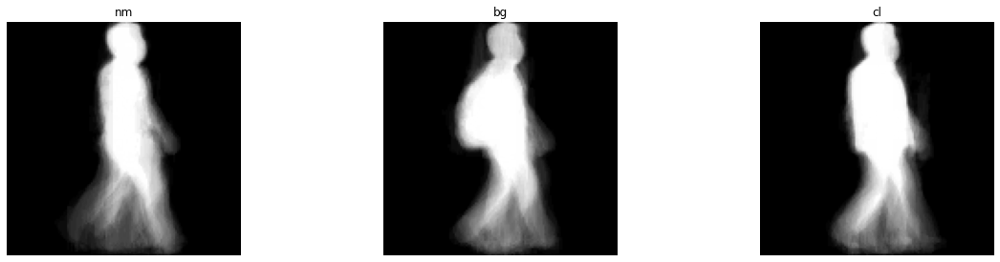

Showing subject: 015 view: 090


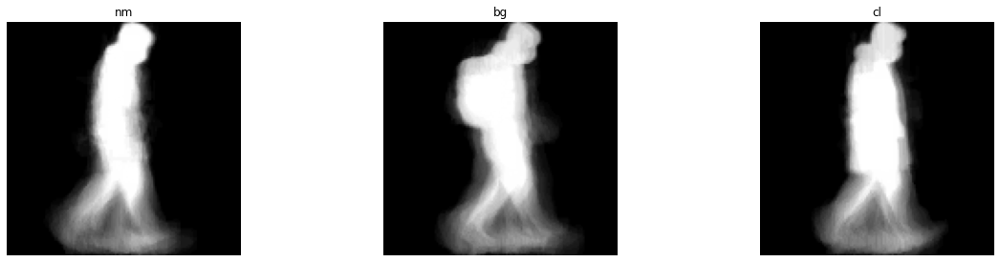

Showing subject: 016 view: 090


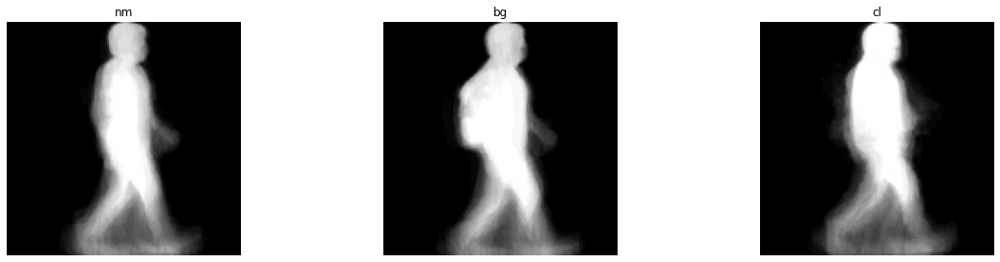

SHOWING VIEW: 105
Showing subject: 000 view: 105


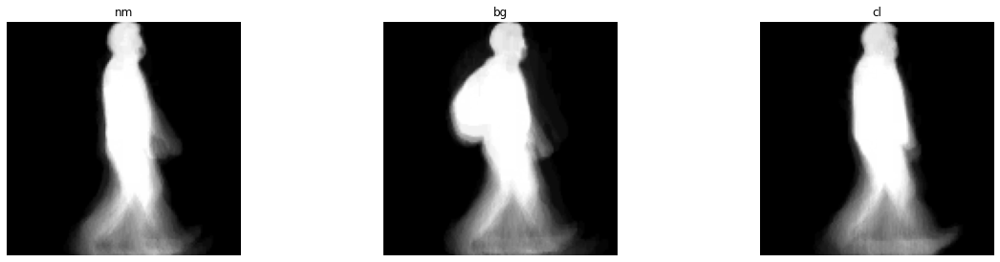

Showing subject: 001 view: 105


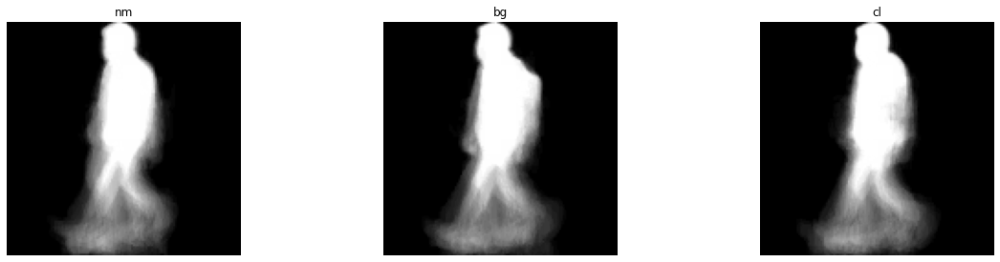

Showing subject: 002 view: 105


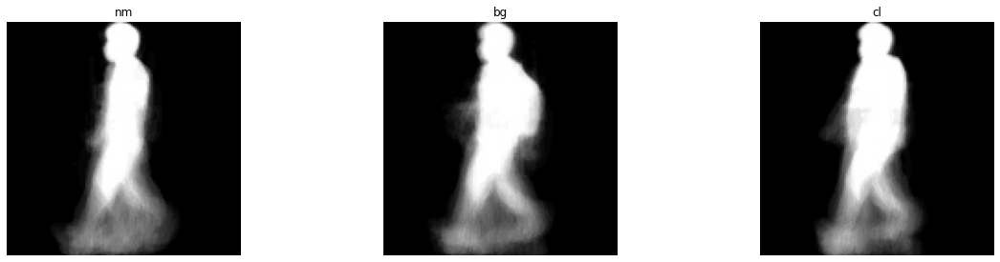

Showing subject: 003 view: 105


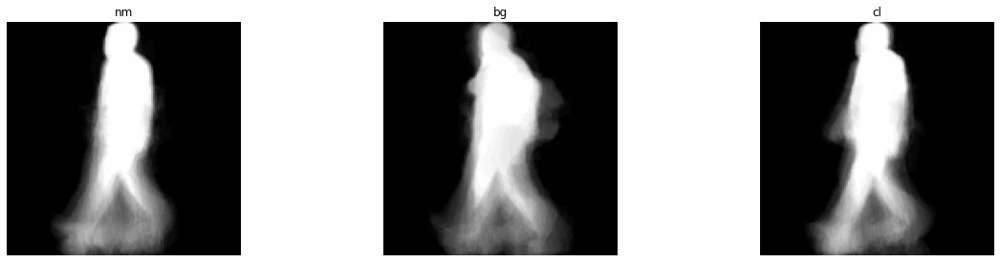

Showing subject: 004 view: 105


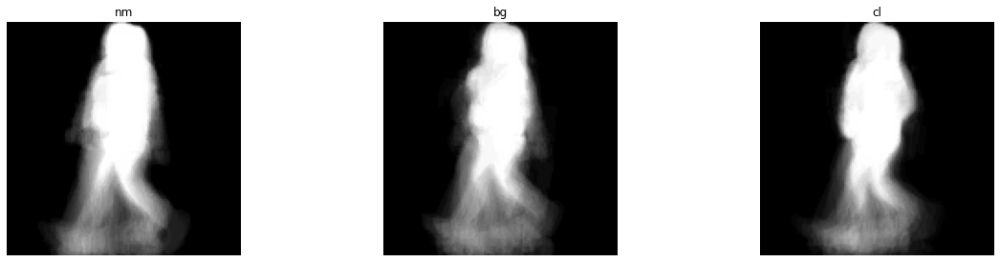

Showing subject: 005 view: 105


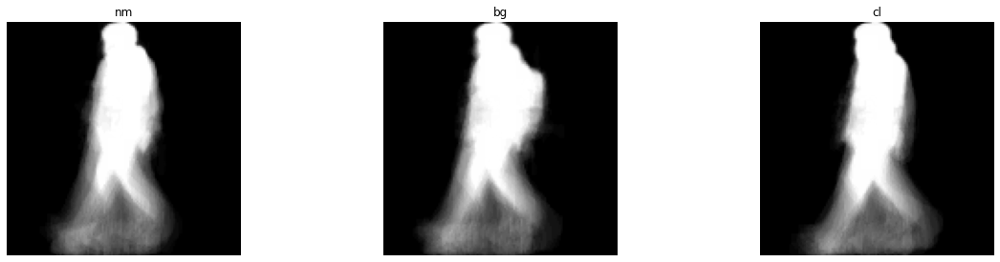

Showing subject: 006 view: 105


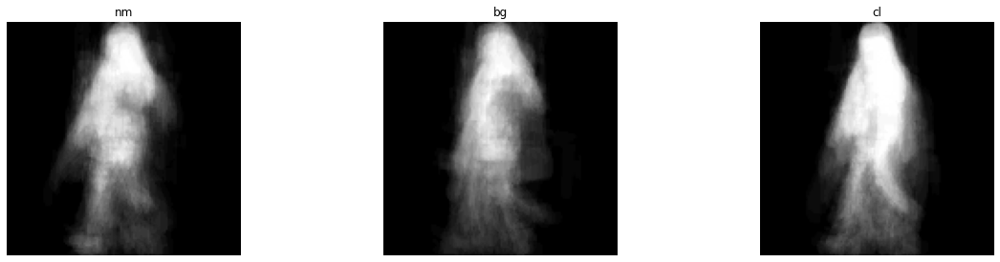

Showing subject: 007 view: 105


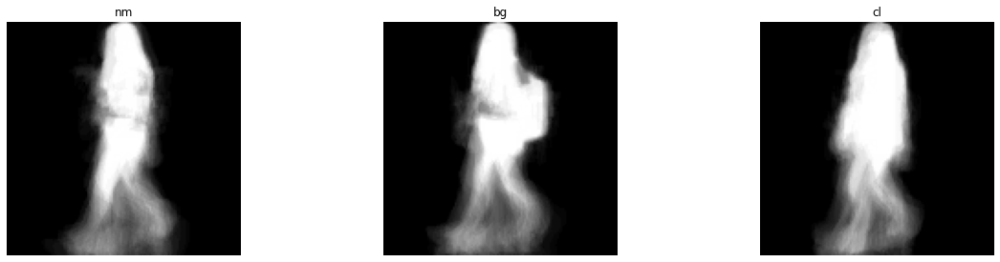

Showing subject: 008 view: 105


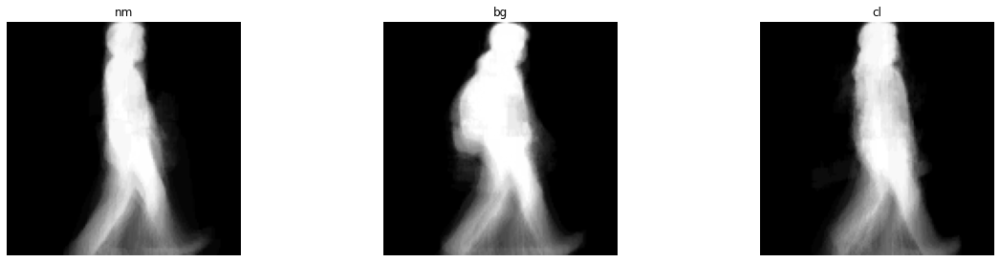

Showing subject: 009 view: 105


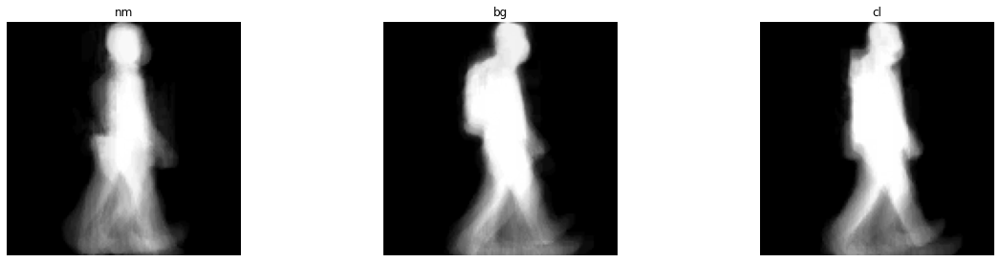

Showing subject: 010 view: 105


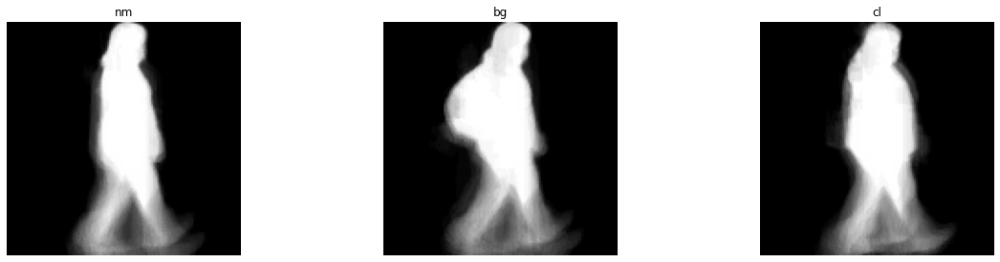

Showing subject: 011 view: 105


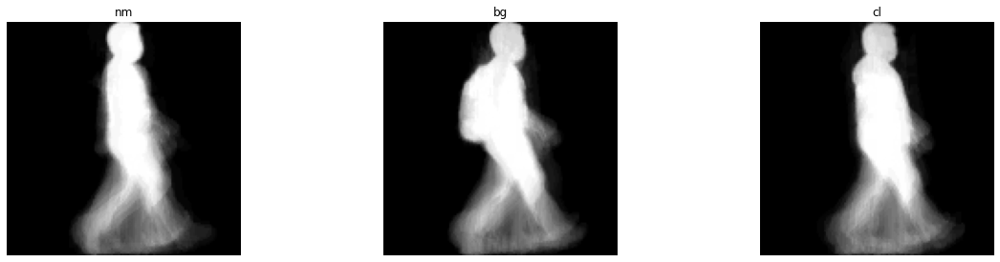

Showing subject: 012 view: 105


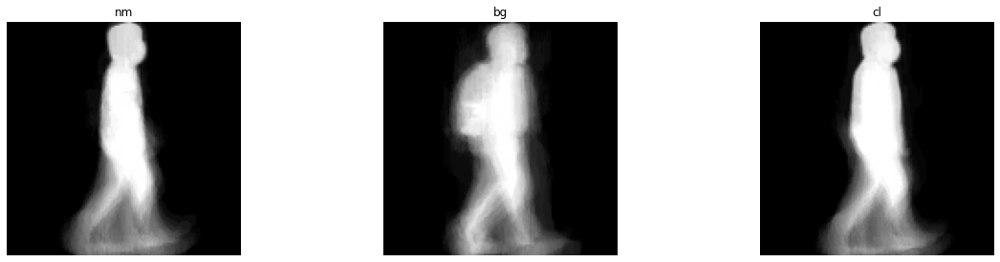

Showing subject: 013 view: 105


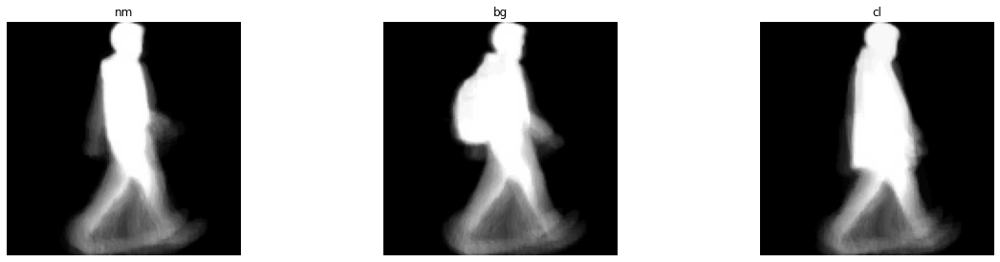

Showing subject: 014 view: 105


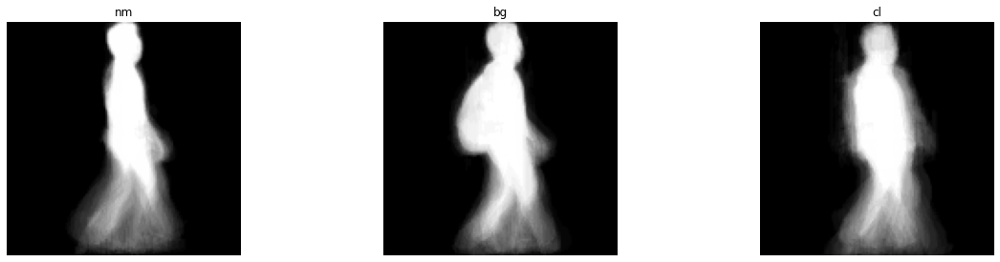

Showing subject: 015 view: 105


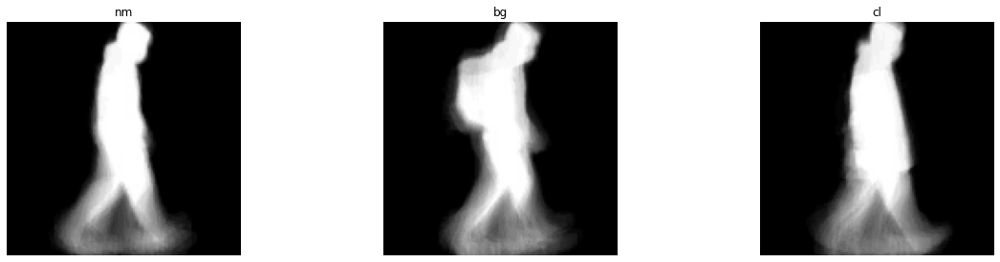

Showing subject: 016 view: 105


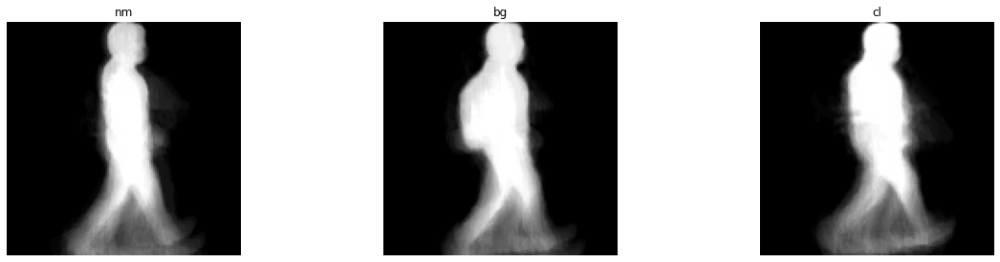

SHOWING VIEW: 120
Showing subject: 000 view: 120


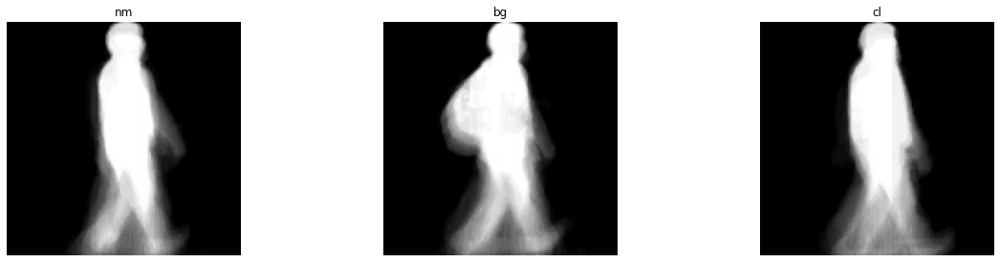

Showing subject: 001 view: 120


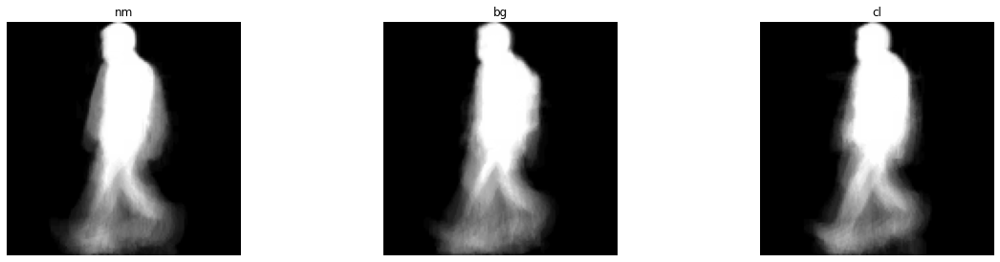

Showing subject: 002 view: 120


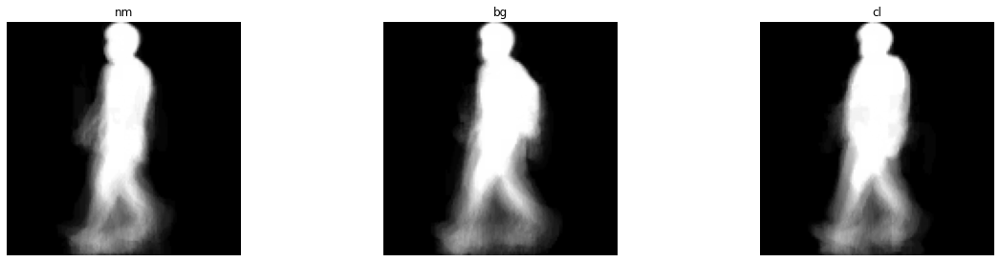

Showing subject: 003 view: 120


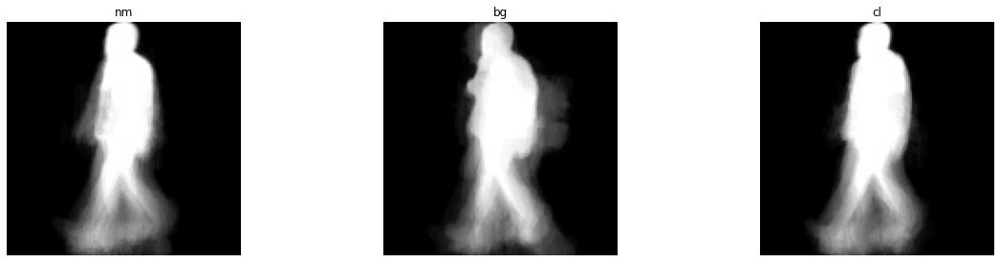

Showing subject: 004 view: 120


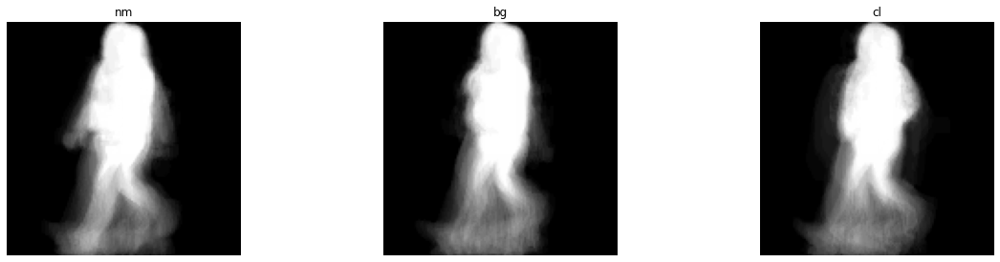

Showing subject: 005 view: 120


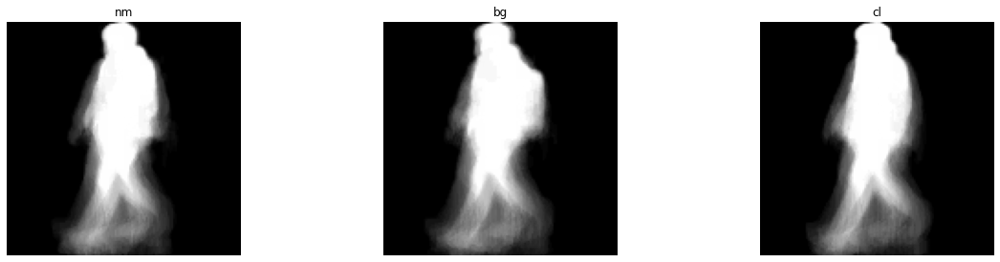

Showing subject: 006 view: 120


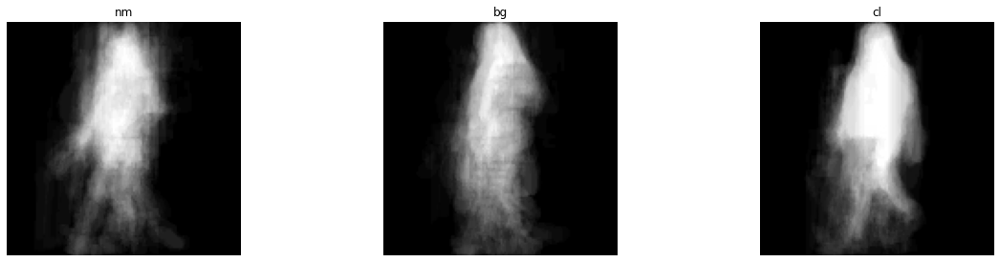

Showing subject: 007 view: 120


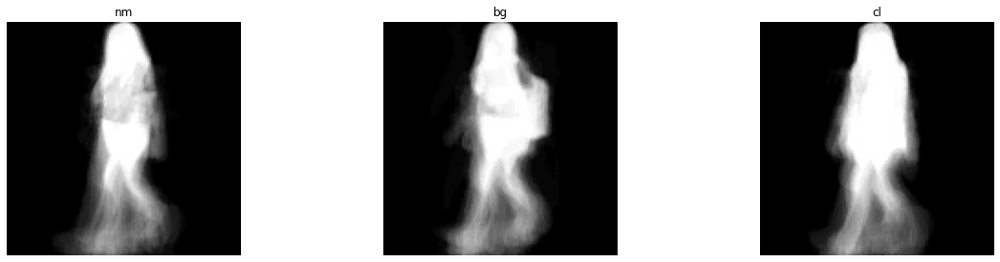

Showing subject: 008 view: 120


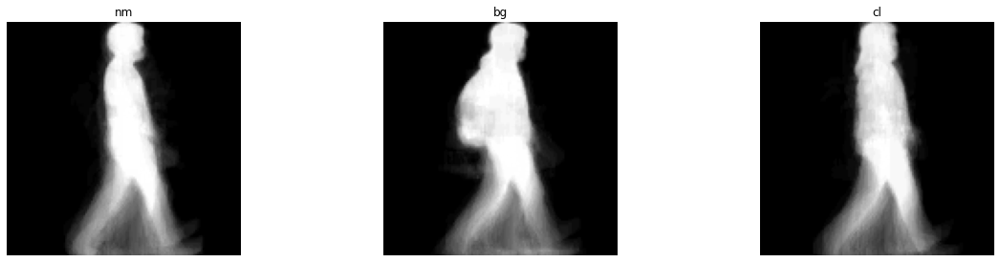

Showing subject: 009 view: 120


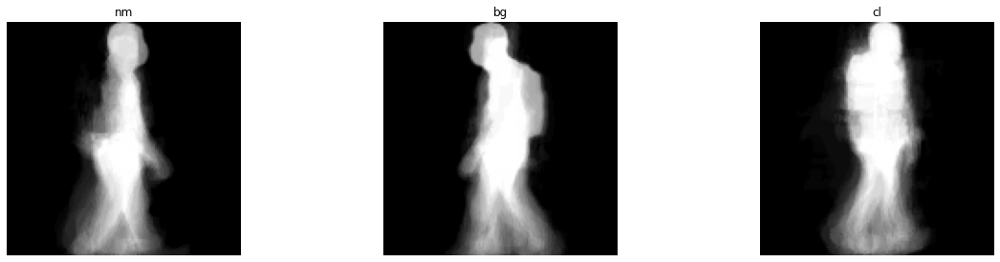

Showing subject: 010 view: 120


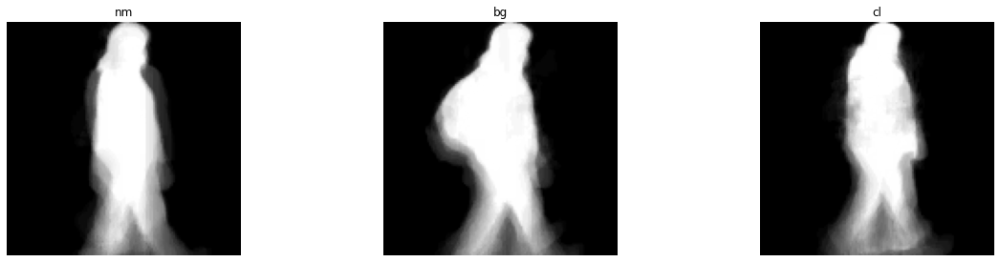

Showing subject: 011 view: 120


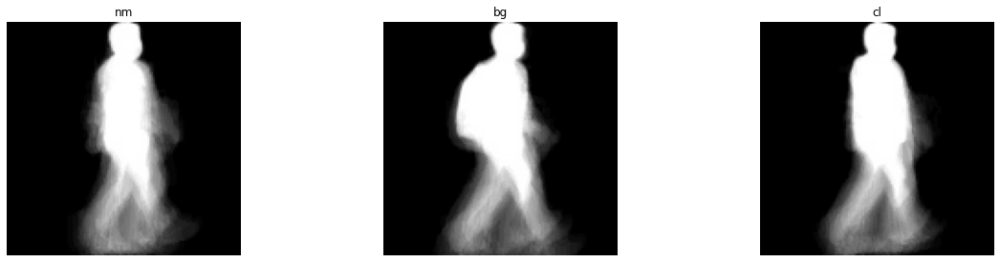

Showing subject: 012 view: 120


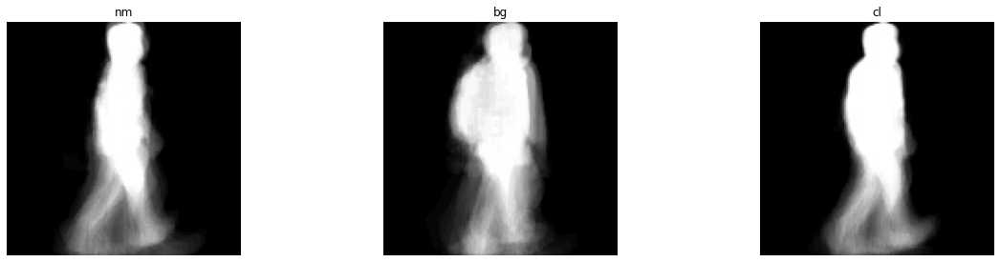

Showing subject: 013 view: 120


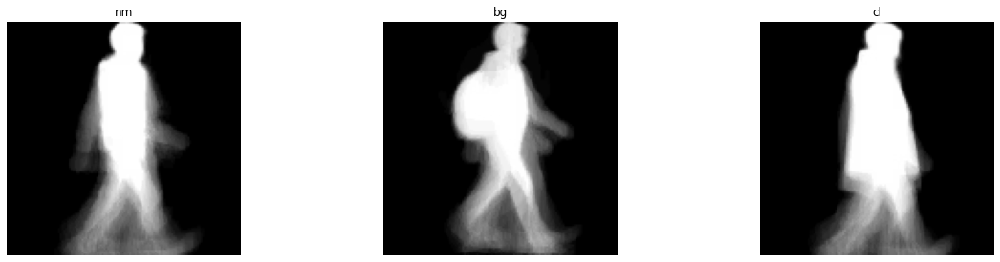

Showing subject: 014 view: 120


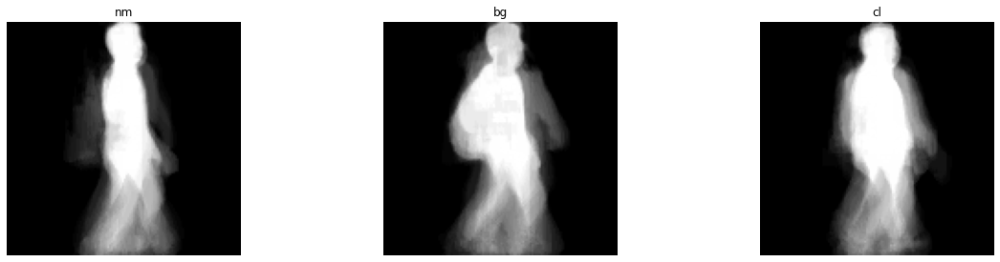

Showing subject: 015 view: 120


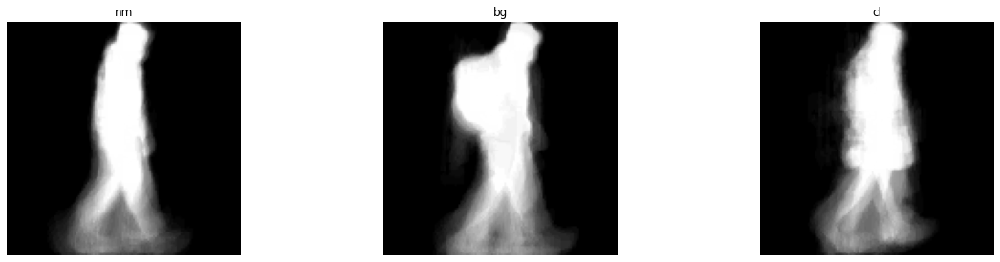

Showing subject: 016 view: 120


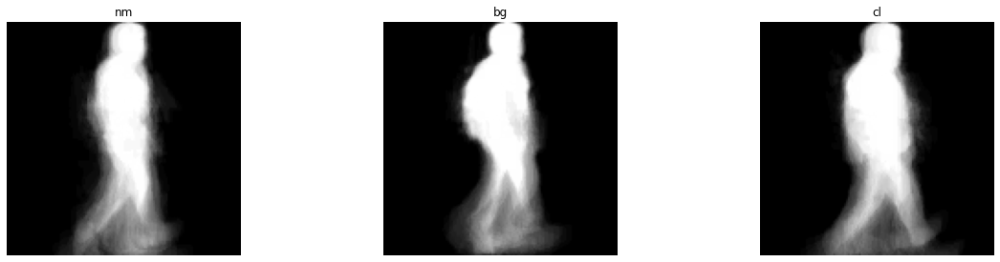

In [17]:
for view in views:
    rep_dir = os.path.join(representations_dir, view)
    print(f'SHOWING VIEW: {view}')
    subjects = sorted(os.listdir(rois_dir))
    
    for subject in subjects:
        print(f'Showing subject: {subject} view: {view}')
        plt.figure(figsize=(20, 4.5))
        
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            nplot = j + 1
            rseqs_dir = os.path.join(rep_dir, subject, walk)
            seqs = sorted(os.listdir(rseqs_dir))
            
            try:
                gei = cv2.imread(os.path.join(rseqs_dir, f'{str(1).zfill(2)}-{str(1)}.png'), 0)        

                plt.subplot(1, 3, nplot); plt.imshow(gei, cmap="gray"); plt.title(walk); plt.axis('off')

                
            except:
                print(f'Error opening')
            nplot+=1
        plt.show()

## Classification dataset generation

In [24]:
training_path = '/home/christian/Documents/Datasets/OakGait16/training_representations/'
views = ['060', '075','090','105','120']

In [25]:
for view in views:
    rep_dir = os.path.join(representations_dir, view)
    subjects = sorted(os.listdir(rep_dir))
    for subject in subjects:
        sub_training_dir = os.path.join(training_path, subject)
        create_dir(sub_training_dir, force=True)
        
for view in views:
    rep_dir = os.path.join(representations_dir, view)
    subjects = sorted(os.listdir(rep_dir))
    
    for subject in subjects:
        sub_training_dir = os.path.join(training_path, subject)
        for j, walk in enumerate(['nm', 'bg', 'cl']):
            print(f'Processing subject: {subject} view: {view} walk:{walk}')
            sub_GEI_dir = os.path.join(rep_dir, subject, walk)
        
            for dir in os.listdir(sub_GEI_dir):
                GEI_name = os.path.join(sub_GEI_dir, dir)
                GEI = cv2.imread(GEI_name, 0)
                GEI_image_name_path = os.path.join(sub_training_dir, f'{view}-{walk}-{dir}')
                cv2.imwrite(os.path.join(training_path ,GEI_image_name_path), GEI)
                

Processing subject: 000 view: 060 walk:nm
Processing subject: 000 view: 060 walk:bg
Processing subject: 000 view: 060 walk:cl
Processing subject: 001 view: 060 walk:nm
Processing subject: 001 view: 060 walk:bg
Processing subject: 001 view: 060 walk:cl
Processing subject: 002 view: 060 walk:nm
Processing subject: 002 view: 060 walk:bg
Processing subject: 002 view: 060 walk:cl
Processing subject: 003 view: 060 walk:nm
Processing subject: 003 view: 060 walk:bg
Processing subject: 003 view: 060 walk:cl
Processing subject: 004 view: 060 walk:nm
Processing subject: 004 view: 060 walk:bg
Processing subject: 004 view: 060 walk:cl
Processing subject: 005 view: 060 walk:nm
Processing subject: 005 view: 060 walk:bg
Processing subject: 005 view: 060 walk:cl
Processing subject: 006 view: 060 walk:nm
Processing subject: 006 view: 060 walk:bg
Processing subject: 006 view: 060 walk:cl
Processing subject: 007 view: 060 walk:nm
Processing subject: 007 view: 060 walk:bg
Processing subject: 007 view: 060 